In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import os
import sys
import astropy as ast
from astropy.io import ascii
import matplotlib.pyplot as plt
import pandas as pd
import glob
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib.colors import LogNorm, Normalize
from metrics import fit_plotter_flux, compute_lomb_scargle, plot_periodogram

In [3]:
df_lmc = pd.read_csv('/Users/shannonbowes/Research/ysg/candidates_and_lcs/final_lmc_ysgcands.csv', comment='#') # , sep="\\s+"
df_smc = pd.read_csv('/Users/shannonbowes/Research/ysg/candidates_and_lcs/final_smc_ysgcands.csv', comment='#') # , sep="\\s+"

In [4]:
# stats = pd.read_csv('summary_results09.csv')
# stats_2022 = pd.read_csv('summary_results07.csv')
# stats = pd.read_csv('summary_results12.csv')
# stats = pd.read_csv('summary_results13.csv')
stats = pd.read_csv('summary_results15.csv')

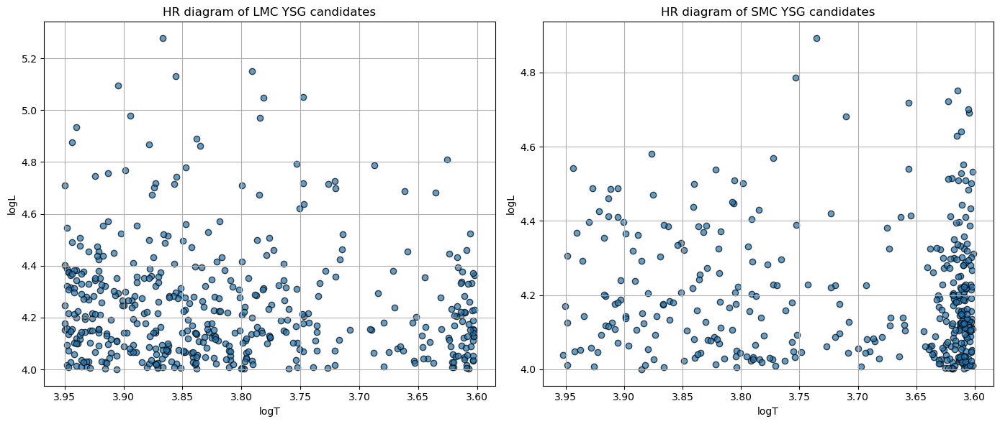

In [5]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))
# LMC plot
ax1.scatter(df_lmc['logT'], df_lmc['logL'], alpha=0.7, marker='o', color='tab:blue', edgecolors='black')
ax1.invert_xaxis()
ax1.set_xlabel('logT')
ax1.set_ylabel('logL')
ax1.set_title('HR diagram of LMC YSG candidates')
ax1.grid(True)
# SMC plot
ax2.scatter(df_smc['logT'], df_smc['logL'], alpha=0.7, edgecolors='black')
ax2.invert_xaxis()
ax2.set_xlabel('logT')
ax2.set_ylabel('logL')
ax2.set_title('HR diagram of SMC YSG candidates')
ax2.grid(True)
plt.tight_layout()
plt.show()

## Analysis

In [6]:
def colour_coding_plot(column, cbar_label, lmc=True, cmap='inferno', lognorm=False):
    """
    Plot HR diagram with colorbar for a specified column.
    """
    plt.figure(figsize=(8, 6))
    plt.rcParams['font.family'] = 'serif'
    if lmc:
        x = np.array(df_lmc['logT'])
        y = np.array(df_lmc['logL'])
        c = np.array(stats[column].iloc[377:])
        mask = (stats['offset_flag'].iloc[377:] == 0).values
    else:
        x = np.array(df_smc['logT'][:377])
        y = np.array(df_smc['logL'][:377])
        c = np.array(stats[column].iloc[:377])
        mask = (stats['offset_flag'].iloc[:377] == 0).values

    if lognorm:
        norm = LogNorm(vmin=np.min(c[mask][c > 0]), vmax=np.max(c[mask]))
    else:
        # norm = Normalize(vmin=np.min(c), vmax=np.max(c))
        norm = Normalize(vmin=np.min(c[mask]), vmax=np.max(c[mask]))

    sc = plt.scatter(x[mask], y[mask], c=c[mask], cmap=cmap, norm=norm, alpha=0.7, zorder=10, edgecolors='black')
    plt.gca().invert_xaxis()
    plt.xlabel('logT', fontsize=14)
    plt.ylabel('logL', fontsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.title(('LMC' if lmc else 'SMC') + f' ({column})', fontsize=16)
    cbar = plt.colorbar(sc, label=cbar_label, orientation='vertical')
    cbar.set_label(cbar_label, fontsize=14)
    cbar.ax.tick_params(labelsize=14)
    plt.grid(True)
    plt.savefig(f'hr_diagrams/HR_{column}_{"lmc" if lmc else "smc"}.png', dpi=300, bbox_inches='tight')
    plt.show()
# colour_coding_plot('best_period', lmc=True, cbar_label='Dominant Period (days)')
# colour_coding_plot('best_period', lmc=False, cbar_label='Dominant Period (days)')
# colour_coding_plot('amplitude_1', lmc=True, cbar_label='Largest Amplitude (mJy)')
# colour_coding_plot('amplitude_1', lmc=False, cbar_label='Largest Amplitude (mJy)')

In [7]:
def combined_separate(column, label_lmc='LMC', label_smc='SMC', cbar_label='Largest Amplitude [mJy]'):
    """
    Plot LMC and SMC HR diagrams together with two colorbars for a specified column.
    """
    plt.rcParams['font.family'] = 'serif'
    fig, ax = plt.subplots(figsize=(8, 6))
    #  LMC and SMC are separated because T, L are stored in separate files
    lmc_c = stats[column].iloc[377:]
    smc_c = stats[column].iloc[:377]
    offset_mask_lmc = (stats['offset_flag'].iloc[377:] == 0).values
    offset_mask_smc = (stats['offset_flag'].iloc[:377] == 0).values
    var_mask_lmc = (stats['alarm_level_flag'].iloc[377:] == 0).values
    var_mask_smc = (stats['alarm_level_flag'].iloc[:377] == 0).values
    nonvariable_mask_lmc = (stats['alarm_level_flag'].iloc[377:] == 1).values
    nonvariable_mask_smc = (stats['alarm_level_flag'].iloc[:377] == 1).values
    # Combine masks
    mask_lmc = offset_mask_lmc & var_mask_lmc
    mask_smc = offset_mask_smc & var_mask_smc
    nonvar_mask_lmc = offset_mask_lmc & nonvariable_mask_lmc
    nonvar_mask_smc = offset_mask_smc & nonvariable_mask_smc

    norm_lmc = Normalize(vmin=np.min(lmc_c[mask_lmc]), vmax=np.max(lmc_c[mask_lmc]))
    norm_smc = Normalize(vmin=np.min(smc_c[mask_smc]), vmax=np.max(smc_c[mask_smc]))

    # Plot non-periodic stars in gray
    sc01 = ax.scatter(df_lmc['logT'].values[nonvar_mask_lmc], df_lmc['logL'].values[nonvar_mask_lmc], c='gray', alpha=0.7, edgecolors='none', label='Non-periodic')
    sc02 = ax.scatter(df_smc['logT'].values[nonvar_mask_smc], df_smc['logL'].values[nonvar_mask_smc], c='gray', alpha=0.7, edgecolors='none')
    # LMC
    sc1 = ax.scatter(df_lmc['logT'].values[mask_lmc], df_lmc['logL'].values[mask_lmc],
                    c=lmc_c[mask_lmc], cmap='Purples_r', norm=norm_lmc,
                    alpha=0.7, zorder=10, edgecolors='black', label = f'{label_lmc} Periodic')
    # SMC
    sc2 = ax.scatter(df_smc['logT'].values[mask_smc], df_smc['logL'].values[mask_smc],
                    c=smc_c[mask_smc], cmap='Oranges_r', norm=norm_smc,
                    alpha=0.7, zorder=10, edgecolors='black', label = f'{label_smc} Periodic')

    ax.invert_xaxis()
    ax.set_xlabel('logT', fontsize=14)
    ax.set_ylabel('logL', fontsize=14)
    ax.set_title(f'{label_lmc}/{label_smc} ({column})', fontsize=16)
    ax.legend(loc='upper right', fontsize=12)
    # plt.ylim(3.9, 5.5)

    cbar1 = fig.colorbar(sc1, ax=ax, orientation='vertical', fraction=0.046, pad=0.1)
    cbar1.set_label(f'{cbar_label} ({label_lmc})', fontsize=14)
    cbar1.ax.tick_params(labelsize=14)
    cbar2 = fig.colorbar(sc2, ax=ax, orientation='vertical', fraction=0.046, pad=0.12)
    cbar2.set_label(f'{cbar_label} ({label_smc})', fontsize=14)
    cbar2.ax.tick_params(labelsize=14)
    plt.grid(True)
    plt.savefig(f'hr_diagrams/HR_{column}.pdf', dpi=300, bbox_inches='tight')
    plt.show()
# combined_separate('amplitude_1', cbar_label='Largest Amplitude [mJy]')

In [33]:
def combined_together(column, cbar_label='Largest Amplitude [mJy]'):
    """
    Plot LMC and SMC HR diagrams together with one colorbar.
    """
    plt.rcParams['font.family'] = 'serif'
    # fig, ax = plt.subplots(figsize=(8, 6))
    fig, ax = plt.subplots(figsize=(16,6))
    # LMC and SMC are separated because T, L are stored in separate files
    lmc_c = stats[column].iloc[377:]
    smc_c = stats[column].iloc[:377]
    offset_mask_lmc = (stats['offset_flag'].iloc[377:] == 0).values
    offset_mask_smc = (stats['offset_flag'].iloc[:377] == 0).values
    var_mask_lmc = (stats['alarm_level_flag'].iloc[377:] == 0).values
    var_mask_smc = (stats['alarm_level_flag'].iloc[:377] == 0).values
    nonvariable_mask_lmc = (stats['alarm_level_flag'].iloc[377:] == 1).values
    nonvariable_mask_smc = (stats['alarm_level_flag'].iloc[:377] == 1).values
    #Combine masks
    mask_lmc = offset_mask_lmc & var_mask_lmc
    mask_smc = offset_mask_smc & var_mask_smc
    nonvar_mask_lmc = offset_mask_lmc & nonvariable_mask_lmc
    nonvar_mask_smc = offset_mask_smc & nonvariable_mask_smc

    vmin = min(np.min(lmc_c[mask_lmc]), np.min(smc_c[mask_smc]))
    vmax = max(np.max(lmc_c[mask_lmc]), np.max(smc_c[mask_smc]))
    # vmax = 0.2
    # vmin = 0
    norm_lmc = Normalize(vmin=vmin, vmax=vmax) 
    #make it log
    norm_lmc = LogNorm(vmin=vmin, vmax=vmax)
    # norm_smc = Normalize(vmin=np.min(smc_c[mask_smc]), vmax=np.max(smc_c[mask_smc]))

    sc01 = ax.scatter(df_lmc['logT'].values[nonvar_mask_lmc], df_lmc['logL'].values[nonvar_mask_lmc], c='gray', alpha=0.7, edgecolors='none', label='Non-periodic')
    sc02 = ax.scatter(df_smc['logT'].values[nonvar_mask_smc], df_smc['logL'].values[nonvar_mask_smc], c='gray', alpha=0.7, edgecolors='none')
    # LMC
    sc1 = ax.scatter(df_lmc['logT'].values[mask_lmc], df_lmc['logL'].values[mask_lmc],
                    c=lmc_c[mask_lmc], cmap='inferno_r', norm=norm_lmc,
                    alpha=0.7, zorder=10, edgecolors='black', label = 'Periodic')
    # SMC
    sc2 = ax.scatter(df_smc['logT'].values[mask_smc], df_smc['logL'].values[mask_smc],
                    c=smc_c[mask_smc], cmap='inferno_r', norm=norm_lmc,
                    alpha=0.7, zorder=10, edgecolors='black')
    ax.invert_xaxis()
    ax.set_xlabel('log($T/K$)', fontsize=18)
    ax.set_ylabel('log($L/L_{\odot}$)', fontsize=18)
    # ax.set_yscale('log')
    # ax.tick_params(axis='both', which='both', labelsize=16)
    # ax.set_title(f'LMC/SMC ({column})', fontsize=16)
    # plt.ylim(3.9, 5.5)
    # Colorbar (use sc1 as representative since both use same norm/cmap)
    cbar = fig.colorbar(sc1, ax=ax, orientation='vertical')
    cbar.set_label(cbar_label, fontsize=18)
    cbar.ax.tick_params(labelsize=16)

    ticks = cbar.get_ticks()
    tick_labels = [f'{tick:.2f}' for tick in ticks]
    # tick_labels[-1] = '0.2+'
    # custom_ticks = np.arange(0.0, 0.25, 0.05)  # 0.0, 0.05, 0.10, 0.15, 0.20
    # tick_labels = [f'{tick:.2f}' for tick in custom_ticks[:-1]]  # Format all but last
    # tick_labels.append('>0.2')  # Replace last with ">0.2"

    # cbar.set_ticks(ticks)
    cbar.set_ticklabels(tick_labels)
    plt.legend(loc='upper left', fontsize=14)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.grid(True)
    plt.savefig(f'hr_diagrams/HR_{column}_shortened.png', dpi=300, bbox_inches='tight')
    plt.show()

<>:44: SyntaxWarning: invalid escape sequence '\o'
<>:44: SyntaxWarning: invalid escape sequence '\o'
/var/folders/34/3847lqd14j78mfm70_z1c_r00000gn/T/ipykernel_6459/1081108747.py:44: SyntaxWarning: invalid escape sequence '\o'
  ax.set_ylabel('log($L/L_{\odot}$)', fontsize=18)


<>:28: SyntaxWarning: invalid escape sequence '\o'
<>:28: SyntaxWarning: invalid escape sequence '\o'
/var/folders/34/3847lqd14j78mfm70_z1c_r00000gn/T/ipykernel_6459/1546980684.py:28: SyntaxWarning: invalid escape sequence '\o'
  ax.set_ylabel('log($L/L_{\odot}$)', fontsize=18) #L_{\odot}
/var/folders/34/3847lqd14j78mfm70_z1c_r00000gn/T/ipykernel_6459/1546980684.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  cbar.set_ticklabels(tick_labels)


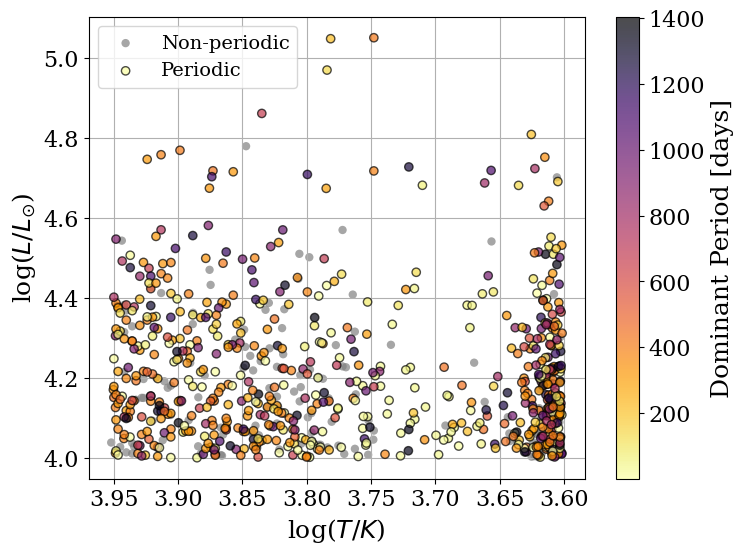

In [34]:
def combined_together_together(column, cbar_label='Largest Amplitude [mJy]'):
    """
    Plot LMC and SMC HR diagrams together with one colorbar.
    """
    plt.rcParams['font.family'] = 'serif'
    fig, ax = plt.subplots(figsize=(8, 6))
    # LMC and SMC are separated because T, L are stored in separate files
    c = stats[column]
    offset_mask = (stats['offset_flag'] == 0).values
    var_mask = (stats['alarm_level_flag'] == 0).values
    nonvariable_mask = (stats['alarm_level_flag'] == 1).values
    #Combine masks
    mask = offset_mask & var_mask
    nonvar_mask = offset_mask & nonvariable_mask
    vmax = np.max(c[mask])
    # vmax = 0.2
    # vmax = 80
    # vmin = 0
    # norm_smc = Normalize(vmin=np.min(smc_c[mask_smc]), vmax=np.max(smc_c[mask_smc]))

    sc01 = ax.scatter(stats['logT'].values[nonvar_mask], stats['logL'].values[nonvar_mask], c='gray', alpha=0.7, edgecolors='none', label='Non-periodic')
    # LMC
    sc1 = ax.scatter(stats['logT'].values[mask], stats['logL'].values[mask],
                    c=c[mask], cmap='inferno_r', norm=Normalize(vmin=np.min(c[mask]), vmax=vmax),
                    alpha=0.7, zorder=10, edgecolors='black', label='Periodic')
    ax.invert_xaxis()
    ax.set_xlabel('log($T/K$)', fontsize=18) # /K
    ax.set_ylabel('log($L/L_{\odot}$)', fontsize=18) #L_{\odot} 
    # ax.tick_params(axis='both', which='both', labelsize=16)
    # ax.set_title(f'LMC/SMC ({column})', fontsize=16)
    # plt.ylim(3.9, 5.5)
    # Colorbar (use sc1 as representative since both use same norm/cmap)
    cbar = fig.colorbar(sc1, ax=ax, orientation='vertical')
    cbar.set_label(cbar_label, fontsize=18)
    cbar.ax.tick_params(labelsize=16)

    ticks = cbar.get_ticks()
    tick_labels = [f'{tick:.0f}' for tick in ticks]
    # tick_labels[-1] = '80+'

    # tick_labels = [f'{tick:.2f}' for tick in ticks]
    # tick_labels[-1] = '0.2+'

    # custom_ticks = np.arange(0.0, 0.25, 0.05)  # 0.0, 0.05, 0.10, 0.15, 0.20
    # tick_labels = [f'{tick:.2f}' for tick in custom_ticks[:-1]]  # Format all but last
    # tick_labels.append('>0.2')  # Replace last with ">0.2"

    # cbar.set_ticks(ticks)
    cbar.set_ticklabels(tick_labels)
    plt.legend(loc='upper left', fontsize=14)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.grid(True)
    plt.savefig(f'hr_diagrams/HR_{column}_shortened.png', dpi=300, bbox_inches='tight')
    plt.show()

# combined_together_together('mag_amplitude_1', cbar_label='Largest Amplitude [mJy]')
combined_together_together('best_period', cbar_label='Dominant Period [days]')


/var/folders/34/3847lqd14j78mfm70_z1c_r00000gn/T/ipykernel_6459/1081108747.py:62: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  cbar.set_ticklabels(tick_labels)


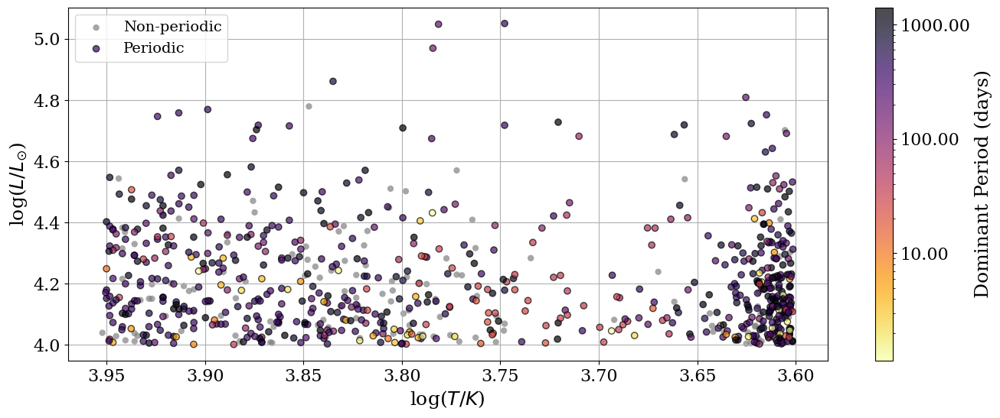

In [35]:
# combined_together('mag_amplitude_1', cbar_label='Amplitude [mag]')
combined_together('best_period', cbar_label='Dominant Period (days)')
# combined_together('chi_flag_997', cbar_label='0 = variable, 1 = nonvar according to 0.997 chi^2 test')
# combined_together('chi_flag_68', cbar_label='0 = variable, 1 = nonvar according to 0.68 chi^2 test')


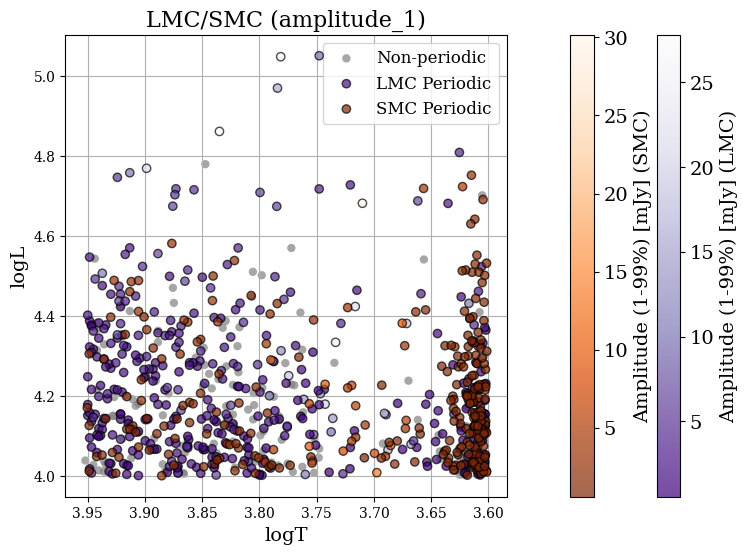

In [11]:
# combined_together('amplitude_1', cbar_label='Largest Amplitude [mJy]')
combined_separate('amplitude_1', cbar_label='Amplitude (1-99%) [mJy]')

In [12]:
def annotate_points(ax, x, y, labels, dy_pts=3, fontsize=8, color='black'):
        for xi, yi, label in zip(x, y, labels):
            ax.annotate(str(label), (xi, yi),
                        textcoords='offset points', xytext=(0, dy_pts),
                        ha='center', va='bottom', fontsize=fontsize, color=color)

In [13]:
def mag_amplitude_plot(column, clim):
    plt.figure(figsize=(14, 6))
    c = stats[column]
    mask = (stats['offset_flag'] == 0).values
    variable_mask = (stats['alarm_level_flag'] == 0).values
    nonvariable_mask = (stats['alarm_level_flag'] == 1).values
    # Combine both masks: only select rows where both are True
    var_mask = mask & variable_mask
    nonvar_mask = mask & nonvariable_mask
    sc2 = plt.scatter(stats['overall_mean_mag'][nonvar_mask], stats['mag_amplitude_1'][nonvar_mask], c='gray', alpha=0.7, edgecolors='none', label='Non-periodic', zorder=1)
    sc1 = plt.scatter(stats['overall_mean_mag'][var_mask], stats['mag_amplitude_1'][var_mask], c=c[var_mask], cmap='inferno', alpha=0.6, edgecolors='black', label = 'Periodic Variable', zorder=2)
    # sc2 = plt.scatter(stats['overall_mean_mag'][nonvar_mask], stats['mag_amplitude_1'][nonvar_mask], c='gray', alpha=0.5, edgecolors='none', label='Non-variable')
    plt.clim(0, clim)
    cbar = plt.colorbar(sc1)
    cbar.set_label('Dominant Period [days]', fontsize=20)
    cbar.ax.tick_params(labelsize=20)
    plt.legend(fontsize=20)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    plt.xlabel('Mean Magnitude (g)', fontsize=20)
    plt.ylabel('Amplitude [mag]', fontsize=20)
    plt.grid(True, zorder=0)
    plt.savefig(f'hr_diagrams/mag_amp_period.pdf', dpi=300, bbox_inches='tight')
    plt.show()

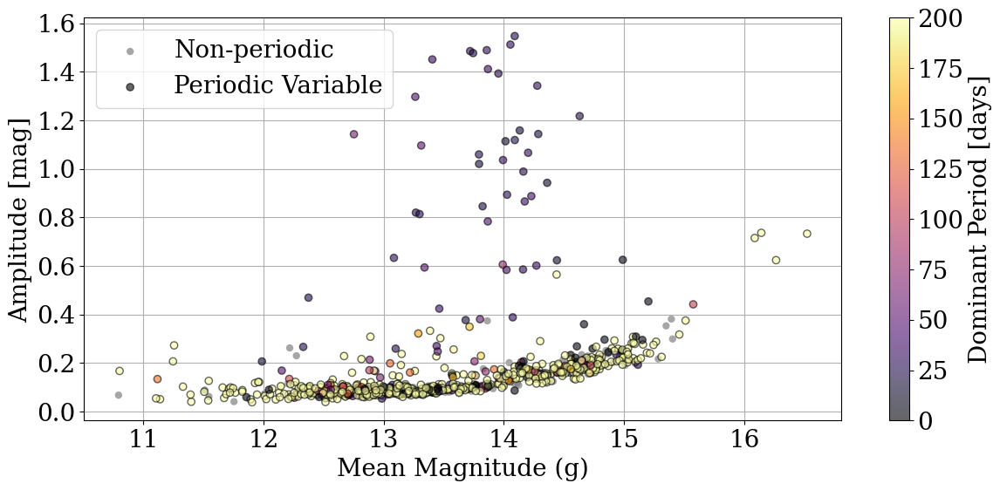

In [14]:
mag_amplitude_plot('best_period', 200)

In [15]:
def mag_amplitude_plot_separate(column, lmc = True):
    plt.figure(figsize=(16, 8))
    if lmc == True:
        c = stats[column].iloc[377:]
        mask = (stats['offset_flag'].iloc[377:] == 0).values
        variable_mask = (stats['alarm_level_flag'].iloc[377:] == 0).values
        nonvariable_mask = (stats['alarm_level_flag'].iloc[377:] == 1).values
        # Combine both masks: only select rows where both are True
        var_mask = mask & variable_mask
        nonvar_mask = mask & nonvariable_mask
        sc2 = plt.scatter(stats['overall_mean_mag'].iloc[377:][nonvar_mask], stats['mag_amplitude_1'].iloc[377:][nonvar_mask], c='gray', alpha=0.7, edgecolors='none', label='Non-periodic')
        sc1 = plt.scatter(stats['overall_mean_mag'].iloc[377:][var_mask], stats['mag_amplitude_1'].iloc[377:][var_mask], c=c[var_mask], cmap='inferno', alpha=0.6, edgecolors='black', label = 'Periodic Variable')
        # sc = plt.scatter(stats['overall_mean_mag'].iloc[377:][mask], stats['mag_amplitude_1'].iloc[377:][mask], c=c[mask], cmap='inferno', alpha=0.7, edgecolors='black')
    else:
        c = stats[column].iloc[:377]
        mask = (stats['offset_flag'].iloc[:377] == 0).values
        variable_mask = (stats['alarm_level_flag'].iloc[:377] == 0).values
        nonvariable_mask = (stats['alarm_level_flag'].iloc[:377] == 1).values
        # Combine both masks: only select rows where both are True
        var_mask = mask & variable_mask
        nonvar_mask = mask & nonvariable_mask
        sc2 = plt.scatter(stats['overall_mean_mag'].iloc[:377][nonvar_mask], stats['mag_amplitude_1'].iloc[:377][nonvar_mask], c='gray', alpha=0.7, edgecolors='none', label='Non-periodic')
        sc1 = plt.scatter(stats['overall_mean_mag'].iloc[:377][var_mask], stats['mag_amplitude_1'].iloc[:377][var_mask], c=c[var_mask], cmap='inferno', alpha=0.6, edgecolors='black', label = 'Periodic Variable')
        # sc = plt.scatter(stats['overall_mean_mag'].iloc[:377][mask], stats['mag_amplitude_1'].iloc[:377][mask], c=c[mask], cmap='inferno', alpha=0.7, edgecolors='black')
    cbar = plt.colorbar(sc1)
    cbar.set_label(column, fontsize=14)
    cbar.ax.tick_params(labelsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlabel('Mean Magnitude (g)', fontsize=14)
    plt.ylabel('Largest Amplitude (1-99%) [mag]', fontsize=14)
    plt.grid(True)
    plt.show()
# mag_amplitude_plot_separate('best_period', lmc=True)
# mag_amplitude_plot_separate('best_period', lmc=False)

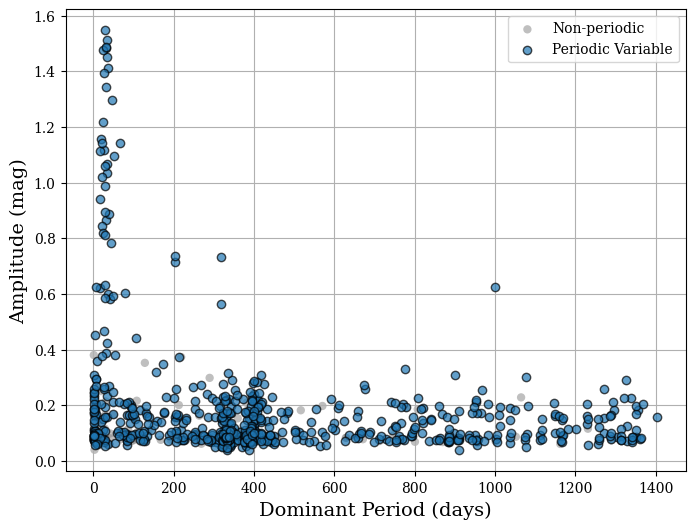

In [16]:
def plot_period_vs_amplitude(df, period_col='best_period', amp_col='mag_amplitude_1'):
    plt.figure(figsize=(8, 6))
    plt.grid(True, zorder=0)
    mask = (df['offset_flag'] == 0).values
    variable_mask = (df['alarm_level_flag'] == 0).values
    nonvariable_mask = (df['alarm_level_flag'] == 1).values
    # Combine both masks: only select rows where both are True
    var_mask = mask & variable_mask
    nonvar_mask = mask & nonvariable_mask
    plt.scatter(df[period_col][nonvar_mask], df[amp_col][nonvar_mask], c='gray', alpha=0.5, edgecolors='none', label='Non-periodic', zorder=1)
    plt.scatter(df[period_col][var_mask], df[amp_col][var_mask], c='tab:blue', alpha=0.7, edgecolors='black', label='Periodic Variable', zorder=2)
    plt.xlabel('Dominant Period (days)', fontsize = 14)
    plt.ylabel('Amplitude (mag)', fontsize = 14)
    plt.legend()
    # plt.grid(True, zorder=0)
    plt.savefig('hr_diagrams/period_amplitude.png', dpi=600, bbox_inches='tight')
    plt.show()
plot_period_vs_amplitude(stats)

In [17]:
simbad_df = pd.read_csv('/Users/shannonbowes/Research/ysg/candidates_and_lcs/2022_asassn_lc_data/results_cmatch_07.csv') 


FileNotFoundError: [Errno 2] No such file or directory: '/Users/shannonbowes/Research/ysg/candidates_and_lcs/2022_asassn_lc_data/results_cmatch_07.csv'

In [18]:
def plot_simbad_crossmatch(xcol, ycol):
    """ Plot the SIMBAD crossmatch data, grouping specified main_types under a single color, and plotting missing main_type as 'Unknown'.
    """
    plt.figure(figsize=(16, 8))
    # plt.figure(figsize=(10,7))
    # Treat empty strings and nan as 'Unknown'
    main_types = simbad_df['main_type'].replace('', np.nan).fillna('Unknown').astype(str)
    # Groups stars, SGs, and candidates together
    grouped_types = set([
        'Star', 'RedSG_Candidate', 'YellowSG', 'RedSG', 'Supergiant',
        'BlueSG', 'YellowSG_Candidate', 'Supergiant_Candidate', 'BlueSG_Candidate'
    ])
    is_grouped = main_types.isin(grouped_types)
    is_unknown = main_types == 'Unknown'
    other_types = sorted(set(main_types.unique()) - grouped_types - {'Unknown'})
    cmap = cm.get_cmap('nipy_spectral', max(3, len(other_types) + 2))
    grouped_color = cmap(0)
    unknown_color = cmap(1)
    other_colors = [cmap(i + 2) for i in range(len(other_types))]

    offset_mask = (simbad_df['offset_flag'] == 0).values
    variable_mask = (simbad_df['alarm_level_flag'] == 0).values
    var_mask = offset_mask & variable_mask
    nonvar_mask = (simbad_df['alarm_level_flag'] == 1).values
    nonvar_mask &= (simbad_df['offset_flag'] == 0).values
    # Plot nonvariable stars in gray 
    plt.scatter(simbad_df[xcol][nonvar_mask],simbad_df[ycol][nonvar_mask],
                color='gray', alpha=0.5, edgecolors='none', label='Non-variable')
    # Plot grouped types
    plt.scatter(simbad_df[xcol][var_mask][is_grouped[var_mask]],
                simbad_df[ycol][var_mask][is_grouped[var_mask]],
                label='SG/SG_Candidate/Star', color=grouped_color, alpha=0.7, edgecolors='black')
    # Plot unknown types (missing main_type)
    plt.scatter(simbad_df[xcol][var_mask][is_unknown[var_mask]],
                simbad_df[ycol][var_mask][is_unknown[var_mask]],
                label='Unknown', color=unknown_color, alpha=0.7, edgecolors='black')
    # # Plot other types
    for i, t in enumerate(other_types):
        mask = (main_types == t)
        # Plot variable stars of this type
        var_type_mask = var_mask & mask
        if var_type_mask.any():
            plt.scatter(simbad_df[xcol][var_type_mask], simbad_df[ycol][var_type_mask],
                        label=f'{t}', color=other_colors[i], alpha=0.7, edgecolors='black')
    # # Plot non-variable stars of this type
    # nonvar_type_mask = nonvar_mask & mask
    # if nonvar_type_mask.any():
    #     plt.scatter(simbad_df[xcol][nonvar_type_mask], simbad_df[ycol][nonvar_type_mask],
    #                 label=f'{t} (Non-variable)', color=other_colors[i], alpha=0.5, edgecolors='none')
    plt.xlabel(xcol, fontsize=14)
    plt.ylabel(ycol, fontsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlabel('Dominant Period [days]', fontsize=14)
    # plt.xlabel('Mean Magnitude (g)', fontsize=14)
    plt.ylabel('Amplitude (1-99%) [mag]', fontsize=14)
    plt.title('SIMBAD Crossmatch: Main Type Distribution', fontsize=16)
    plt.legend(title='main_type', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12, markerscale=1.5)
    plt.grid(True)
    plt.tight_layout()
    # plt.savefig(f'hr_diagrams/simbad_crossmatch_{xcol}_{ycol}.pdf', dpi=300, bbox_inches='tight')
    plt.show()
plot_simbad_crossmatch('best_period', 'mag_amplitude_1')
# plot_simbad_crossmatch('overall_mean_mag', 'mag_amplitude_1')

NameError: name 'simbad_df' is not defined

<Figure size 1600x800 with 0 Axes>

/var/folders/34/3847lqd14j78mfm70_z1c_r00000gn/T/ipykernel_42756/2934848392.py:16: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('nipy_spectral', max(3, len(other_types) + 2))


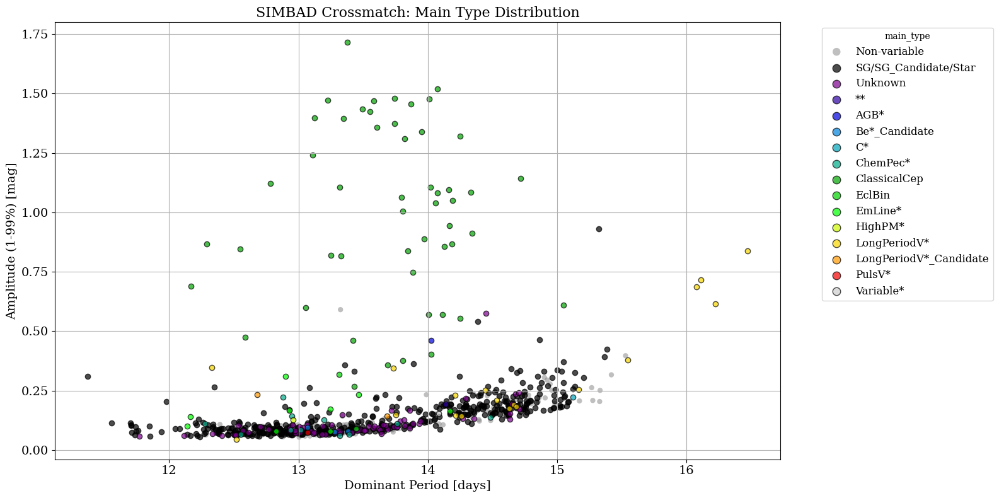

In [18]:
def plot_simbad_crossmatch_tidy(xcol, ycol):
    """ Plot the SIMBAD crossmatch data, grouping specified main_types under a single color, and plotting missing main_type as 'Unknown'.
    """
    # plt.figure(figsize=(16, 8))
    plt.figure(figsize=(12,7))
    # Treat empty strings and nan as 'Unknown'
    main_types = simbad_df['main_type'].replace('', np.nan).fillna('Unknown').astype(str)
    # Groups stars, SGs, and candidates together
    grouped_types = set([
        'Star', 'RedSG_Candidate', 'YellowSG', 'RedSG', 'Supergiant',
        'BlueSG', 'YellowSG_Candidate', 'Supergiant_Candidate', 'BlueSG_Candidate'
    ])
    LPV_grouped_types = set(['LongPeriodV*', 'LongPeriodV*_Candidate'])
    is_LPV_grouped = main_types.isin(LPV_grouped_types)
    is_grouped = main_types.isin(grouped_types)
    is_unknown = main_types == 'Unknown'
    other_types = sorted(set(main_types.unique()) - grouped_types - {'Unknown'} - LPV_grouped_types)
    # cmap = cm.get_cmap('nipy_spectral', max(3, len(other_types) + 2))
    cmap = cm.get_cmap('tab20', max(3, len(other_types) + 2))
    grouped_color = cmap(0)
    unknown_color = cmap(1)
    LPV_color = cmap(2)
    other_colors = [cmap(i + 3) for i in range(len(other_types))]

    offset_mask = (simbad_df['offset_flag'] == 0).values
    variable_mask = (simbad_df['alarm_level_flag'] == 0).values
    var_mask = offset_mask & variable_mask
    nonvar_mask = (simbad_df['alarm_level_flag'] == 1).values
    nonvar_mask &= (simbad_df['offset_flag'] == 0).values
    # Plot nonvariable stars in gray 
    plt.scatter(simbad_df[xcol][nonvar_mask],simbad_df[ycol][nonvar_mask],
                color='gray', alpha=0.5, edgecolors='none', label='Non-variable', zorder=1)
    # Plot grouped types
    plt.scatter(simbad_df[xcol][var_mask][is_grouped[var_mask]],
                simbad_df[ycol][var_mask][is_grouped[var_mask]],
                label='SG/SG Candidate/Star', color=grouped_color, alpha=0.7, edgecolors='black', zorder=3)
    # Plot LPV grouped types
    plt.scatter(simbad_df[xcol][var_mask][is_LPV_grouped[var_mask]],
                simbad_df[ycol][var_mask][is_LPV_grouped[var_mask]],
                label='Long Period Variable/Candidate', color=LPV_color, alpha=0.7, edgecolors='black', zorder=4)
    # Plot unknown types (missing main_type)
    plt.scatter(simbad_df[xcol][var_mask][is_unknown[var_mask]],
                simbad_df[ycol][var_mask][is_unknown[var_mask]],
                label='No matches', color=unknown_color, alpha=0.7, edgecolors='black', zorder=2)
    # # Plot other types
    for i, t in enumerate(other_types):
        mask = (main_types == t)
        # Plot variable stars of this type
        var_type_mask = var_mask & mask
        if var_type_mask.any():
            if t == 'ChemPec*':
                t = 'Chemically Peculiar'
            if t == 'Be*_Candidate':
                t = 'Be Candidate'
            if t == '**':
                t = 'Close Binary'
            if t == 'C*':
                t = 'Carbon Star'
            if t == 'AGB*':
                t = 'AGB'
            if t == 'ClassicalCep':
                t = 'Classical Cepheid'
            if t == 'EclBin':
                t = 'Eclipsing Binary'
            if t == 'EmLine*':
                t = 'Emission Line Star'
            if t == 'HighPM*':
                t = 'High Proper Motion Star'
            # if t == 'LongPeriodV*' or t == 'LongPeriodV*_Candidate':
            #     t = 'Long Period Variable/Candidate'
            if t == 'PulsV*':
                t = 'Pulsating Variable'
            if t == 'Variable*':
                t = 'Variable Star'
            plt.scatter(simbad_df[xcol][var_type_mask], simbad_df[ycol][var_type_mask],
                        label=f'{t}', color=other_colors[i], alpha=0.7, edgecolors='black', zorder=5)
    # # Plot non-variable stars of this type
    # nonvar_type_mask = nonvar_mask & mask
    # if nonvar_type_mask.any():
    #     plt.scatter(simbad_df[xcol][nonvar_type_mask], simbad_df[ycol][nonvar_type_mask],
    #                 label=f'{t} (Non-variable)', color=other_colors[i], alpha=0.5, edgecolors='none')
    plt.xlabel(xcol, fontsize=18)
    plt.ylabel(ycol, fontsize=18)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.xlabel('Dominant Period [days]', fontsize=16)
    plt.ylabel('Mean Magnitude (g)', fontsize=16)
    # plt.xscale('log')
    # plt.ylabel('Amplitude [mag]', fontsize=16)
    # plt.title('SIMBAD Crossmatch: Main Type Distribution', fontsize=16)
    plt.legend(title='SIMBAD Main Type', bbox_to_anchor=(1.05, 1), loc='upper left', title_fontsize=16, fontsize=18, markerscale=1.5)
    plt.grid(True, zorder=0)
    plt.tight_layout()
    # plt.savefig(f'hr_diagrams/simbad_crossmatch_{xcol}_{ycol}.pdf', dpi=300, bbox_inches='tight')
    plt.show()
# plot_simbad_crossmatch_tidy('best_period', 'mag_amplitude_1')
# plot_simbad_crossmatch_tidy('best_period', 'overall_mean_mag')
plot_simbad_crossmatch('overall_mean_mag', 'mag_amplitude_1')

In [19]:
# Extract the first identifier from 'other_types' skipping MIR, NIR, or IR
def extract_first_identifier_skip_ir(s):
    if pd.isnull(s):
        return 'Unknown'
    parts = s.split('|')
    for part in parts:
        part = part.strip()
        if part.startswith('*'):
            part = part[1:]
        if part and part not in ['MIR', 'NIR', 'IR']:
            return part
    return 'Unknown'

simbad_df['first_identifier'] = simbad_df['other_types'].apply(extract_first_identifier_skip_ir)
# Extract the first non-MIR/NIR/IR identifier from 'other_types' for plotting and labeling
def extract_first_non_ir_identifier(s):
    if pd.isnull(s):
        return 'Unknown'
    parts = [part.strip() for part in s.split('|')]
    for part in parts:
        if part.startswith('*'):
            part = part[1:]
        if part and part not in ['MIR', 'NIR', 'IR']:
            return part
    return 'Unknown' # If all are MIR/NIR/IR

simbad_df['plot_identifier'] = simbad_df['other_types'].apply(extract_first_non_ir_identifier)

def plot_by_first_identifier_skip_ir(df, xcol='best_period', ycol='mag_amplitude_1'):
    """
    Plot SIMBAD crossmatch by first identifier, skipping 'MIR', 'NIR', or 'IR'.
    """
    plt.figure(figsize=(10, 7))
    unique_ids = [ident for ident in df['first_identifier'].unique() if ident not in ['MIR', 'NIR', 'IR']]
    cmap = cm.get_cmap('tab20', len(unique_ids))
    colors = [cmap(i) for i in range(len(unique_ids))]
    
    for i, ident in enumerate(unique_ids):
        mask = df['first_identifier'] == ident
        offset_mask = (df['offset_flag'] == 0).values
        mask &= offset_mask
        plt.scatter(df[xcol][mask], df[ycol][mask],
                    label=ident, color=colors[i], alpha=0.7, edgecolors='black')
    plt.xlabel('Best Period', fontsize=14)
    plt.ylabel('Mag Amplitude 1', fontsize=14)
    plt.title('SIMBAD Crossmatch: First Identifier (excluding MIR/NIR/IR)')
    plt.legend(title='First Identifier', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()
# plot_by_first_identifier_skip_ir(simbad_df)
# plot_by_first_identifier_skip_ir(simbad_df, xcol='overall_mean_mag', ycol='mag_amplitude_1')


In [20]:
# For each star, plot by the identifier in its list that is least common amongst all stars (including MIR/NIR/IR)
def get_identifiers_list(s):
    if pd.isnull(s):
        return []
    parts = [p.strip().lstrip('*') for p in s.split('|')]
    return [p for p in parts if p]  # No filtering of MIR/NIR/IR

# List of all identifiers (including MIR/NIR/IR):
all_identifiers = []
for s in simbad_df['other_types']:
    all_identifiers.extend(get_identifiers_list(s))

from collections import Counter
identifier_freq = Counter(all_identifiers)

# For each star, select the least common identifier in its list
def select_least_common_identifier(s):
    ids = get_identifiers_list(s)
    if not ids:
        return 'Unknown'
    min_freq = min([identifier_freq[i] for i in ids])
    least_common_ids = [i for i in ids if identifier_freq[i] == min_freq]
    # If multiple, pick the first
    return least_common_ids[0]

def plot_by_least_common_identifier(df, xcol='best_period', ycol='mag_amplitude_1'):
    simbad_df['least_common_identifier'] = simbad_df['other_types'].apply(select_least_common_identifier)
    # Plot by least common identifier for each star
    plt.figure(figsize=(10, 7))
    unique_ids = simbad_df['least_common_identifier'].unique()
    cmap = cm.get_cmap('tab20', len(unique_ids))
    colors = [cmap(i) for i in range(len(unique_ids))]

    for i, ident in enumerate(unique_ids):
        mask = simbad_df['least_common_identifier'] == ident
        offset_mask = (simbad_df['offset_flag'] == 0).values
        mask &= offset_mask
        plt.scatter(simbad_df[xcol][mask], simbad_df[ycol][mask],
                    label=ident, color=colors[i], alpha=0.7, edgecolors='black')
    plt.xlabel(xcol, fontsize=14)
    plt.ylabel(ycol, fontsize=14)
    plt.title('SIMBAD Crossmatch: Each Star Plotted by Its Least Common Identifier')
    plt.legend(title='Least Common Identifier', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# plot_by_least_common_identifier(simbad_df)
# plot_by_least_common_identifier(simbad_df, xcol='overall_mean_mag', ycol='mag_amplitude_1')

In [21]:
all_identifiers = []
for s in simbad_df['other_types'].dropna():
    parts = [p.strip().lstrip('*') for p in s.split('|')]
    all_identifiers.extend([p for p in parts if p])
identifier_dict = {}
for ident in all_identifiers:
    if ident in identifier_dict:
        identifier_dict[ident] += 1
    else:
        identifier_dict[ident] = 1

for ident, count in identifier_dict.items():
    print(f"Identifier: {ident}, Number of stars: {count}")


Identifier: MIR, Number of stars: 529
Identifier: NIR, Number of stars: 723
Identifier: s?b, Number of stars: 77
Identifier: s?r, Number of stars: 169
Identifier: Ce*, Number of stars: 55
Identifier: V*, Number of stars: 65
Identifier: cC*, Number of stars: 57
Identifier: Pe*, Number of stars: 26
Identifier: V*?, Number of stars: 23
Identifier: s*y, Number of stars: 58
Identifier: s*r, Number of stars: 12
Identifier: C*, Number of stars: 2
Identifier: LP*, Number of stars: 30
Identifier: sg*, Number of stars: 34
Identifier: Em*, Number of stars: 31
Identifier: EmO, Number of stars: 17
Identifier: s*b, Number of stars: 29
Identifier: Be?, Number of stars: 6
Identifier: EB*, Number of stars: 4
Identifier: IR, Number of stars: 34
Identifier: sg?, Number of stars: 7
Identifier: LP?, Number of stars: 6
Identifier: s?y, Number of stars: 5
Identifier: RB?, Number of stars: 7
Identifier: PM*, Number of stars: 2
Identifier: HV*, Number of stars: 2
Identifier: X, Number of stars: 4
Identifier: S

# Looking at above density \& high amplitude stars:

In [22]:
above_density_high_amp = pd.read_csv('above_density_high_amp.csv')
high_amp = pd.read_csv('high_amp.csv')
above_density = pd.read_csv('above_density.csv')
dense_strip = pd.read_csv('dense_strip.csv')

# stars not in above_density_high_amp but in summary_results07:


coords = pd.read_csv('merged_smc_lmc_coords.csv', comment='#', sep=r"\s+", names=['ra', 'dec'])

def find_target_indices(subset):
    """
    Find target indices for stars in above_density.csv by matching coordinates
    with merged_smc_lmc_coords.csv
    
    Parameters:
    -----------
    above_density_df : pandas DataFrame
        DataFrame containing above_density stars with RA_1, DEC_1 columns
    coords_df : pandas DataFrame  
        DataFrame containing all coordinates with ra, dec columns
    tolerance : float
        Coordinate matching tolerance in degrees (default 1e-6 ~ 0.004 arcsec)
        
    Returns:
    --------
    list : Target indices for above_density stars
    """
    target_indices = []
    
    for idx, row in subset.iterrows():
        ra_target = row['RA']
        dec_target = row['DEC']
        
        ra_diff = np.abs(coords['ra'] - ra_target)
        dec_diff = np.abs(coords['dec'] - dec_target)
        matches = (ra_diff < 1e-6) & (dec_diff < 1e-6)

        if matches.any():
            target_idx = coords.index[matches][0]  # Take first match
            target_indices.append(target_idx)
            # print(f"Above density star {idx} (RA={ra_target:.6f}, DEC={dec_target:.6f}) -> Target {target_idx}")
        else:
            target_indices.append(None)
            print(f"No match found for above density & high amp star {idx} (RA={ra_target:.6f}, DEC={dec_target:.6f})")
    print(f"Found {len(target_indices)} target indices")
    return target_indices

above_density_targets = find_target_indices(above_density)
above_density_high_amp_targets = find_target_indices(above_density_high_amp)
high_amp_targets = find_target_indices(high_amp)
dense_strip_targets = find_target_indices(dense_strip)
# print(above_density_targets)

Found 53 target indices
Found 103 target indices
Found 51 target indices
Found 665 target indices


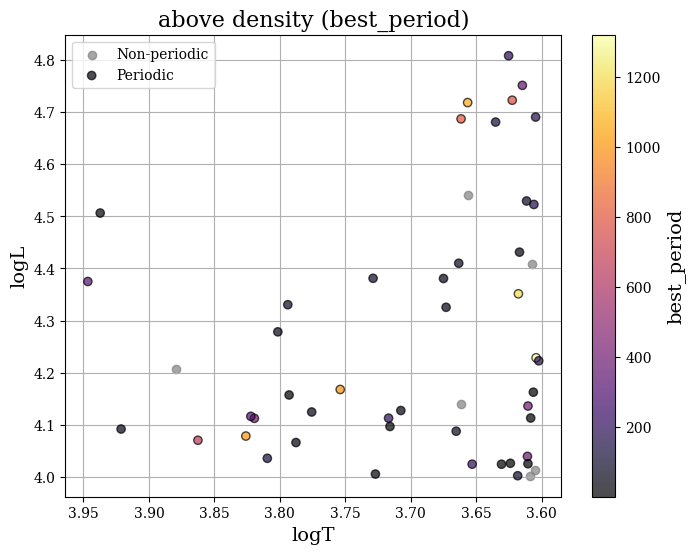

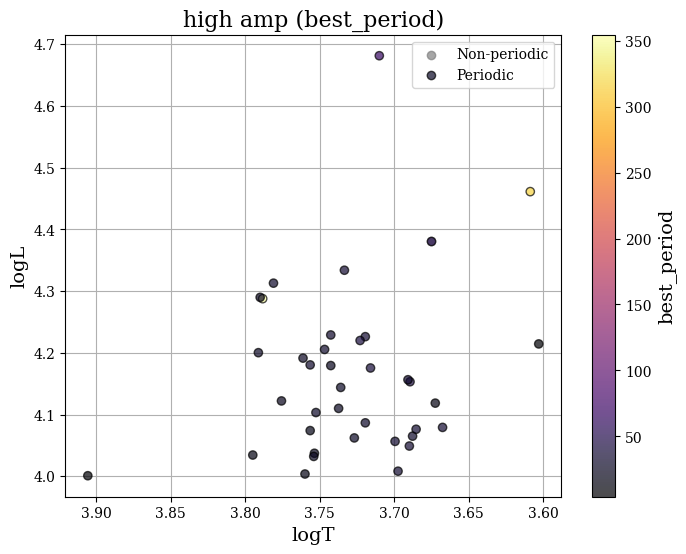

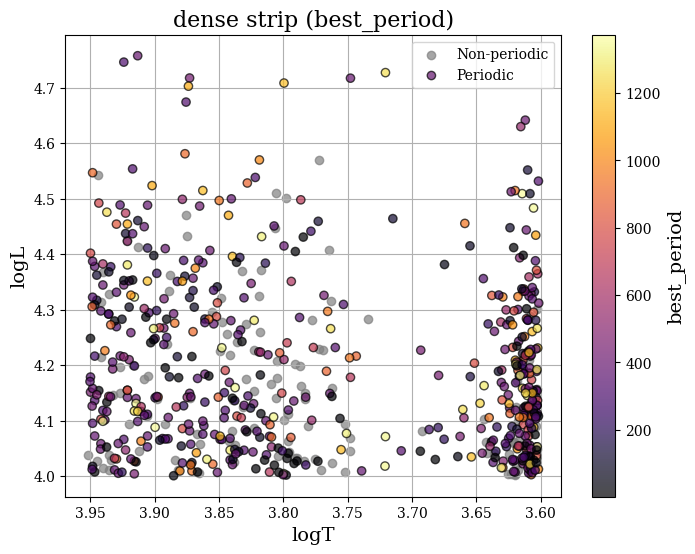

In [23]:
# hr diagram of above density stars
def plot_above_density_hr(column, title, subset):
    """
    Plot HR diagram for above density stars using target indices.
    """
    fig, ax = plt.subplots(figsize=(8, 6))
    plt.rcParams['font.family'] = 'serif'
    
    target_indices = subset
    
    smc_target_indices = [idx for idx in target_indices if idx < 377]
    lmc_target_indices = [idx - 377 for idx in target_indices if idx >= 377] # Grabs LMC indices for df_lmc (logT, logL)
    
    lmc_c = stats[column].iloc[377:]
    smc_c = stats[column].iloc[:377]

    offset_mask_lmc = (stats['offset_flag'].iloc[377:] == 0).values
    offset_mask_smc = (stats['offset_flag'].iloc[:377] == 0).values
    var_mask_lmc = (stats['alarm_level_flag'].iloc[377:] == 0).values
    var_mask_smc = (stats['alarm_level_flag'].iloc[:377] == 0).values
    nonvariable_mask_lmc = (stats['alarm_level_flag'].iloc[377:] == 1).values
    nonvariable_mask_smc = (stats['alarm_level_flag'].iloc[:377] == 1).values
    
    # Combine masks
    mask_lmc = offset_mask_lmc & var_mask_lmc
    mask_smc = offset_mask_smc & var_mask_smc
    nonvar_mask_lmc = offset_mask_lmc & nonvariable_mask_lmc
    nonvar_mask_smc = offset_mask_smc & nonvariable_mask_smc

    # Subset masks 
    target_mask_lmc = np.isin(np.arange(len(df_lmc)), lmc_target_indices) & mask_lmc
    target_mask_smc = np.isin(np.arange(len(df_smc)), smc_target_indices) & mask_smc
    target_nonvar_mask_lmc = np.isin(np.arange(len(df_lmc)), lmc_target_indices) & nonvar_mask_lmc
    target_nonvar_mask_smc = np.isin(np.arange(len(df_smc)), smc_target_indices) & nonvar_mask_smc
    
    # Normalization using only periodic subset stars
    combined_c = np.concatenate([lmc_c[target_mask_lmc], smc_c[target_mask_smc]])
    vmin = np.min(combined_c)
    vmax = np.max(combined_c)
    norm = Normalize(vmin=vmin, vmax=vmax)

    # Non-periodic subset stars
    sc01 = ax.scatter(df_lmc['logT'].values[target_nonvar_mask_lmc], 
                        df_lmc['logL'].values[target_nonvar_mask_lmc],
                        c='gray', alpha=0.7, 
                        label='Non-periodic')

    sc02 = ax.scatter(df_smc['logT'].values[target_nonvar_mask_smc], 
                        df_smc['logL'].values[target_nonvar_mask_smc],
                        c='gray', alpha=0.7)

    # telescope issue
    telE = ax.scatter(df_smc['logT'].values[284], df_smc['logL'].values[284], c=smc_c[284], cmap='inferno', norm=norm,
                      alpha=0.7, zorder=10, edgecolors='black')

    sc1 = ax.scatter(df_lmc['logT'].values[target_mask_lmc], 
                    df_lmc['logL'].values[target_mask_lmc],
                    c=lmc_c[target_mask_lmc], cmap='inferno', norm=norm,
                    alpha=0.7, zorder=10, edgecolors='black', 
                    label='Periodic')

    sc2 = ax.scatter(df_smc['logT'].values[target_mask_smc], 
                    df_smc['logL'].values[target_mask_smc],
                    c=smc_c[target_mask_smc], cmap='inferno', norm=norm,
                    alpha=0.7, zorder=10, edgecolors='black')

    ax.invert_xaxis()
    ax.set_xlabel('logT', fontsize=14)
    ax.set_ylabel('logL', fontsize=14)
    ax.set_title(f'{title} ({column})', fontsize=16)

    if np.max(lmc_c[target_mask_lmc]) > np.max(smc_c[target_mask_smc]):
        colorbar_source = sc1
    else:
        colorbar_source = sc2
    colorbar = plt.colorbar(colorbar_source, ax=ax)
    colorbar.set_label(column, fontsize=14)
    
    ax.legend()
    ax.grid(True)
    # plt.savefig(f'hr_diagrams/HR_above_density.png', dpi=600, bbox_inches='tight')
    plt.show()

# plot_above_density_hr('mag_amplitude_1')
# plot_above_density_hr('best_period', 'above density & high amp', above_density_high_amp_targets)
plot_above_density_hr('best_period', 'above density', above_density_targets)
plot_above_density_hr('best_period', 'high amp', high_amp_targets)
plot_above_density_hr('best_period', 'dense strip', dense_strip_targets)

In [24]:
# Contaminated stars present in above_density (exact coordinate match to 1e-6 deg)
contaminated = pd.read_csv('angDist_contamination.csv')  # RA, DEC, angDist are floats

ab_keys = (above_density['RA'].round(6).astype(str) + '_' + above_density['DEC'].round(6).astype(str))
co_keys = (contaminated['RA'].round(6).astype(str) + '_' + contaminated['DEC'].round(6).astype(str))
match_mask = ab_keys.isin(set(co_keys))
above_density['is_contaminated'] = match_mask

n = int(match_mask.sum())
print(f"{n} contaminated coordinates.")
if n:
    print(above_density.loc[match_mask, ['RA','DEC']].to_string(index=False))


0 contaminated coordinates.


In [25]:
# # Identify key columns for membership (assume RA/DEC present). Adjust if unique ID column exists.
# key_cols = ['RA','DEC']
# # missing = [c for c in key_cols if c not in above_density_high_amp.columns or c not in high_amp.columns]
# # if missing:
# #     raise ValueError(f'Missing key columns in one of the files: {missing}')

# # Anti-join: rows in above_density_high_amp not appearing in high_amp (by RA & DEC)
# ha_keys = set(zip(high_amp['RA'].round(8), high_amp['DEC'].round(8)))
# mask = ~above_density_high_amp.apply(lambda r: (round(r.RA,8), round(r.DEC,8)) in ha_keys, axis=1)
# above_density = above_density_high_amp.loc[mask].reset_index(drop=True)

# print(f'Total in full set: {len(above_density_high_amp)}')
# print(f'High-amp subset:   {len(high_amp)}')
# print(f'Remaining (above_density): {len(above_density)}')
# above_density.head()

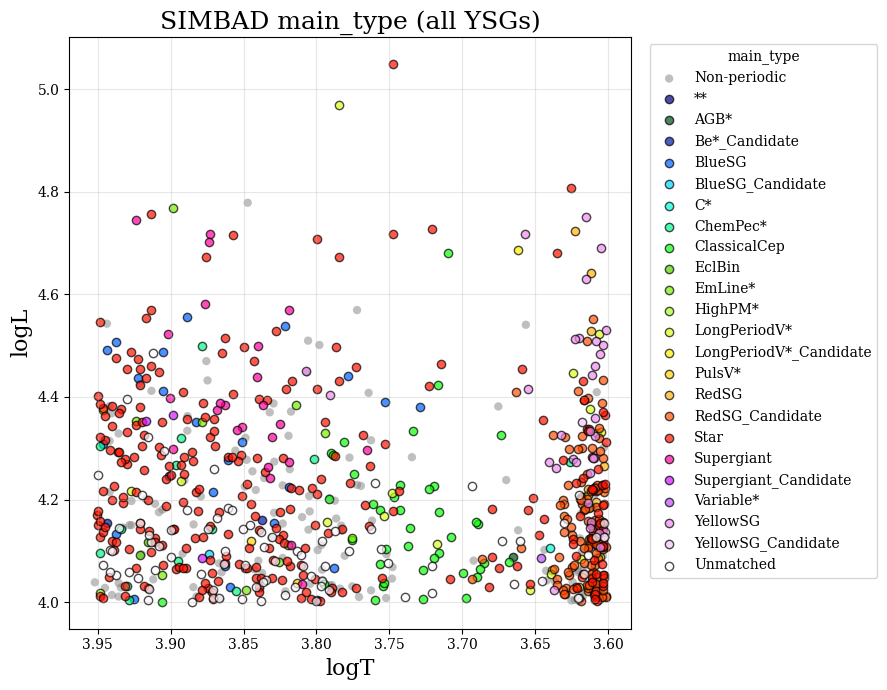

In [26]:
def plot_hr_by_simbad_main_type_all(
    title='HR by SIMBAD main_type (exact RA/DEC match)',
    df_ra_col='ra',
    df_dec_col='dec',
    stats_ra_col='RA',
    stats_dec_col='DEC',
    simbad_ra_col='RA',
    simbad_dec_col='DEC'):

    simbad = simbad_df

    # Maps from RA/DEC tuples to flags and type (exact floats)
    stat_keys = list(zip(stats[stats_ra_col].values, stats[stats_dec_col].values))
    offset_map = dict(zip(stat_keys, (stats['offset_flag'] == 0).astype(bool)))
    alarm1_map = dict(zip(stat_keys, (stats['alarm_level_flag'] == 1).astype(bool)))

    type_col = 'main_type' if 'main_type' in simbad.columns else None
    sim_keys = list(zip(simbad[simbad_ra_col].values, simbad[simbad_dec_col].values))
    if type_col is None:
        type_map = {k: 'Unmatched' for k in sim_keys}
    else:
        mt = simbad[type_col]
        mt = mt.where(~mt.isna(), other='Unmatched').astype(str).str.strip().replace({'': 'Unmatched'})
        type_map = {}
        for k, v in zip(sim_keys, mt):
            if k not in type_map:
                type_map[k] = v

    # Align per-catalog arrays
    def align(df):
        keys = list(zip(df[df_ra_col].values, df[df_dec_col].values))
        off = np.array([offset_map.get(k, False) for k in keys], dtype=bool)
        alm1 = np.array([alarm1_map.get(k, False) for k in keys], dtype=bool)
        types = np.array([type_map.get(k, 'Unmatched') for k in keys], dtype=object)
        return off, alm1, types

    off_s, alm1_s, types_s = align(df_smc)
    off_l, alm1_l, types_l = align(df_lmc)

    # Masks
    grey_s = off_s & alm1_s
    grey_l = off_l & alm1_l
    color_s = off_s & ~alm1_s
    color_l = off_l & ~alm1_l

    # Categories among colored
    cats = sorted(set(np.unique(types_s[color_s]).tolist() + np.unique(types_l[color_l]).tolist()))
    if 'Unmatched' in cats:
        cats = [c for c in cats if c != 'Unmatched'] + ['Unmatched']

    cmap = mpl.colormaps['gist_ncar'] 
    base_colors = [cmap(i / max(1, (len(cats) - 1))) for i in range(len(cats))] 
    color_for = {c: base_colors[i] for i, c in enumerate(cats)}

    fig, ax = plt.subplots(figsize=(9, 7))
    plt.rcParams['font.family'] = 'serif'

    # Grey (alarm_level_flag == 1)
    if grey_s.any():
        ax.scatter(df_smc['logT'].values[grey_s], df_smc['logL'].values[grey_s],
                   c='gray', alpha=0.5, edgecolors='none', label='Non-periodic')
    if grey_l.any():
        ax.scatter(df_lmc['logT'].values[grey_l], df_lmc['logL'].values[grey_l],
                   c='gray', alpha=0.5, edgecolors='none')

    added = set()
    for cat in cats:
        m_s = color_s & (types_s == cat)

        ax.scatter(df_smc['logT'].values[m_s], df_smc['logL'].values[m_s],
                    color=color_for[cat], edgecolors='black', alpha=0.7,
                    label=(cat if cat not in added else None))
        added.add(cat)
        m_l = color_l & (types_l == cat)

        ax.scatter(df_lmc['logT'].values[m_l], df_lmc['logL'].values[m_l],
                    color=color_for[cat],  edgecolors='black', alpha=0.7,
                    label=(cat if cat not in added else None))
        added.add(cat)

    ax.invert_xaxis()
    ax.set_xlabel('logT', fontsize=16)
    ax.set_ylabel('logL', fontsize=16)
    ax.set_title(title, fontsize=18)
    ax.legend(bbox_to_anchor=(1.02, 1), loc='upper left', fontsize=10, title='main_type')
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.savefig(f'hr_diagrams/HR_by_simbad_main_type_simple.png', dpi=300, bbox_inches='tight')
    plt.show()

# Usage:
plot_hr_by_simbad_main_type_all('SIMBAD main_type (all YSGs)')


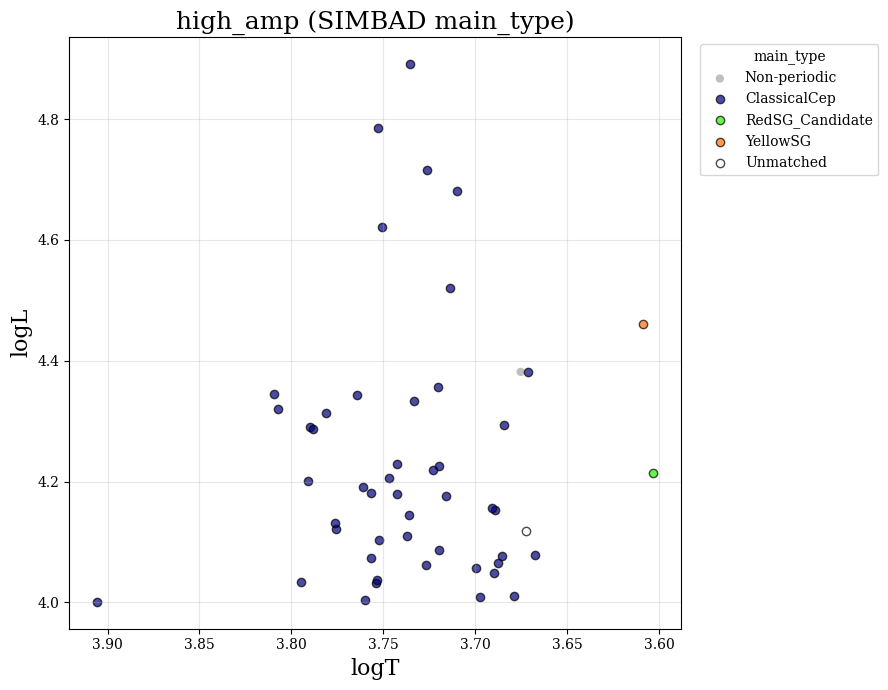

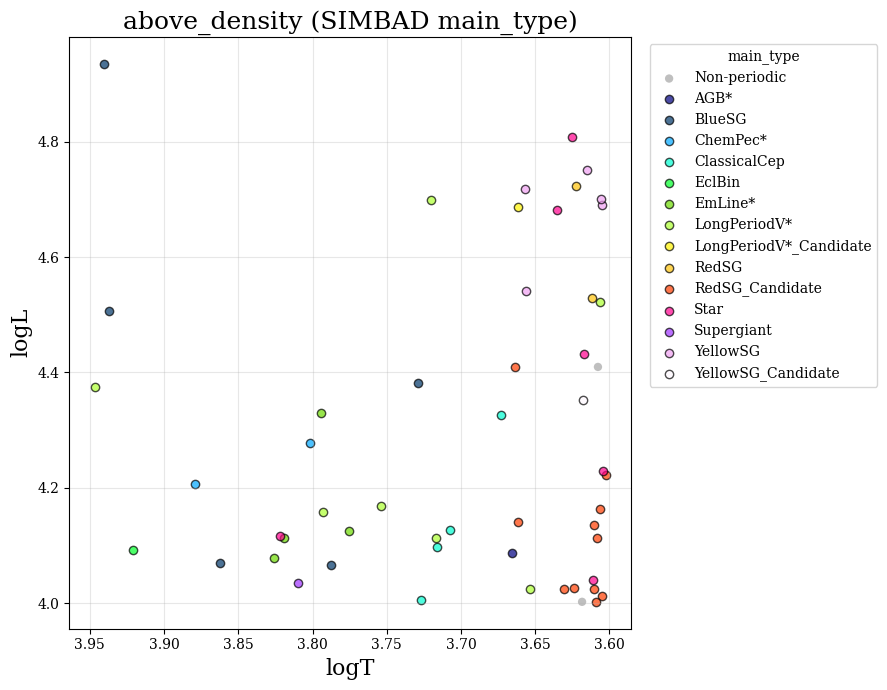

In [27]:
def plot_hr_by_simbad_main_type_subset(title, subset):

    # Make maps from RA/DEC to flags and main_type (exact)
    stat_keys = list(zip(subset['RA'].values, subset['DEC'].values))
    offset_map = dict(zip(stat_keys, (subset['offset_flag'] == 0).astype(bool)))
    alarm1_map = dict(zip(stat_keys, (subset['alarm_level_flag'] == 1).astype(bool)))
    sim_keys = list(zip(subset['RA'].values, subset['DEC'].values))

    mt = subset['main_type']
    mt = mt.where(~mt.isna(), other='Unmatched').astype(str).str.strip().replace({'': 'Unmatched'})
    type_map = {}
    for k, v in zip(sim_keys, mt): # Map SIMBAD keys to their main types
        if k not in type_map:
            type_map[k] = v

    # Align between T and L info and simbad crossmatch/summary stats
    def align(df):
        df_coords = list(zip(df['ra'].values, df['dec'].values))
        off = np.array([offset_map.get(k, False) for k in df_coords], dtype=bool) # Checks if offset_flag = 0
        alm1 = np.array([alarm1_map.get(k, False) for k in df_coords], dtype=bool) # Checks if alarm_level_flag = 1
        types = np.array([type_map.get(k, 'Unmatched') for k in df_coords], dtype=object)
        return off, alm1, types

    off_s, alm1_s, types_s = align(df_smc)
    off_l, alm1_l, types_l = align(df_lmc)

    nonvar_s = off_s & alm1_s
    nonvar_l = off_l & alm1_l
    var_s = off_s & ~alm1_s
    var_l = off_l & ~alm1_l

    # Groups main_type categories
    cats = sorted(set(np.unique(types_s[var_s]).tolist() + np.unique(types_l[var_l]).tolist()))
    if 'Unmatched' in cats:
        cats = [c for c in cats if c != 'Unmatched'] + ['Unmatched'] # Keep 'Unmatched' at the end of legend

    cmap = mpl.colormaps['gist_ncar']
    base_colors = [cmap(i / max(1, (len(cats) - 1))) for i in range(len(cats))] 
    color_for = {c: base_colors[i] for i, c in enumerate(cats)}


    fig, ax = plt.subplots(figsize=(9, 7))
    plt.rcParams['font.family'] = 'serif'

    # Grey (alarm_level_flag == 1)
    if nonvar_s.any():
        ax.scatter(df_smc['logT'].values[nonvar_s], df_smc['logL'].values[nonvar_s],
                   c='gray', alpha=0.5, edgecolors='none', label='Non-periodic')
    if nonvar_l.any():
        ax.scatter(df_lmc['logT'].values[nonvar_l], df_lmc['logL'].values[nonvar_l],
                   c='gray', alpha=0.5, edgecolors='none')

    # Colored by type
    added = set() # track for no double labels
    for cat in cats:
        m_s = var_s & (types_s == cat)

        ax.scatter(df_smc['logT'].values[m_s], df_smc['logL'].values[m_s],
                    color=color_for[cat], edgecolors='black', alpha=0.7,
                    label=(cat if cat not in added else None))
        added.add(cat)
        m_l = var_l & (types_l == cat)

        ax.scatter(df_lmc['logT'].values[m_l], df_lmc['logL'].values[m_l],
                    color=color_for[cat],  edgecolors='black', alpha=0.7,
                    label=(cat if cat not in added else None))
        added.add(cat)

    ax.invert_xaxis()
    ax.set_xlabel('logT', fontsize=16)
    ax.set_ylabel('logL', fontsize=16)
    ax.set_title(title, fontsize=18)
    ax.legend(bbox_to_anchor=(1.02, 1), loc='upper left', fontsize=10, title='main_type')
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    # plt.savefig(f'hr_diagrams/HR_simbad_high_amp.png', dpi=300, bbox_inches='tight')
    plt.show()

# Usage:
plot_hr_by_simbad_main_type_subset('high_amp (SIMBAD main_type)', high_amp)
plot_hr_by_simbad_main_type_subset('above_density (SIMBAD main_type)', above_density)

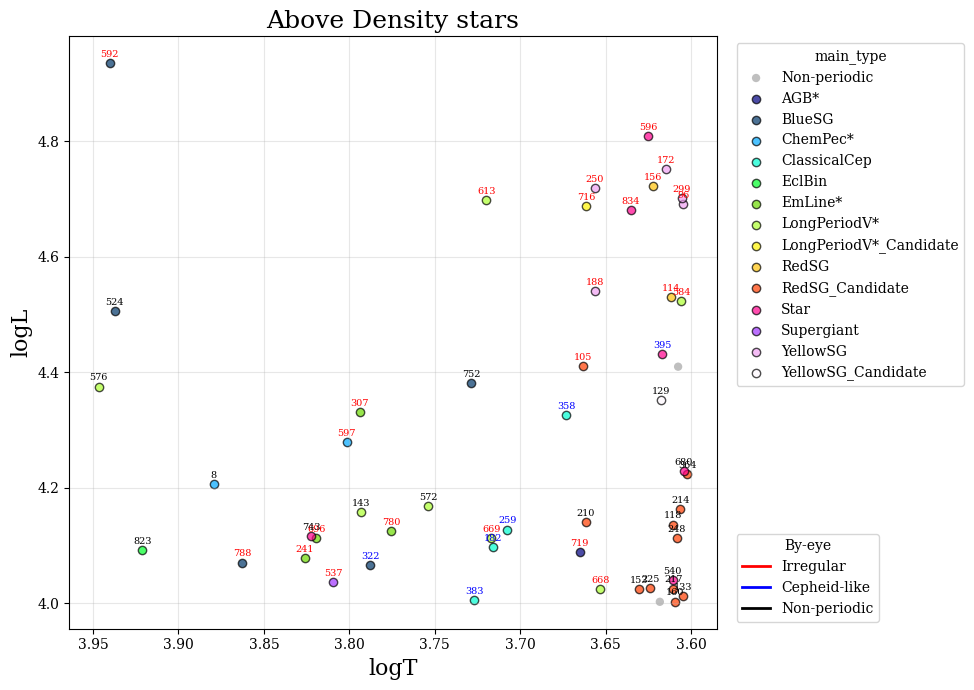

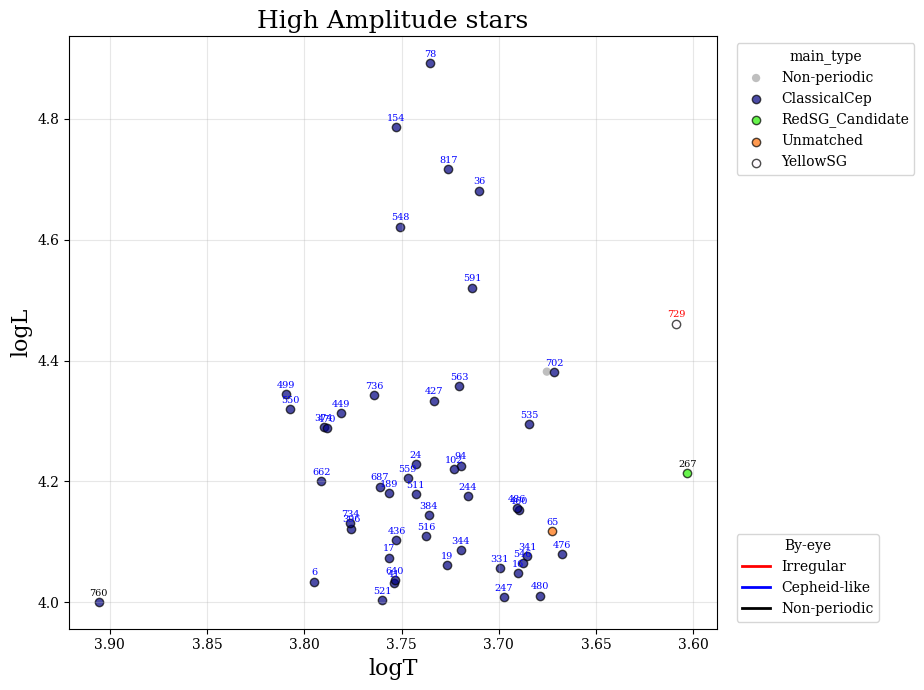

In [28]:
def plot_hr_by_simbad_main_type_subset_labelled(title, subset):

    stat_keys = list(zip(subset['RA'].values, subset['DEC'].values))
    offset_map = dict(zip(stat_keys, (subset['offset_flag'] == 0).astype(bool)))
    alarm1_map = dict(zip(stat_keys, (subset['alarm_level_flag'] == 1).astype(bool)))
    sim_keys = list(zip(subset['RA'].values, subset['DEC'].values))

    mt = subset['main_type']
    mt = mt.where(~mt.isna(), other='Unmatched').astype(str).str.strip().replace({'': 'Unmatched'})
    type_map = {}
    for k, v in zip(sim_keys, mt): # Map SIMBAD keys to their main types
        if k not in type_map:
            type_map[k] = v

    # Align between T and L info and simbad crossmatch/summary stats
    def align(df):
        df_coords = list(zip(df['ra'].values, df['dec'].values))
        off = np.array([offset_map.get(k, False) for k in df_coords], dtype=bool) # Checks if offset_flag = 0
        alm1 = np.array([alarm1_map.get(k, False) for k in df_coords], dtype=bool) # Checks if alarm_level_flag = 1
        types = np.array([type_map.get(k, 'Unmatched') for k in df_coords], dtype=object)
        return off, alm1, types

    off_s, alm1_s, types_s = align(df_smc)
    off_l, alm1_l, types_l = align(df_lmc)

    nonvar_s = off_s & alm1_s
    nonvar_l = off_l & alm1_l
    var_s = off_s & ~alm1_s
    var_l = off_l & ~alm1_l

    cats = sorted(set(np.unique(types_s[var_s]).tolist() + np.unique(types_l[var_l]).tolist()))

    cmap = mpl.colormaps['gist_ncar']
    base_colors = [cmap(i / max(1, (len(cats) - 1))) for i in range(len(cats))] 
    color_for = {c: base_colors[i] for i, c in enumerate(cats)}

    fig, ax = plt.subplots(figsize=(9, 7))
    plt.rcParams['font.family'] = 'serif'

    # Grey (alarm_level_flag == 1)
    if nonvar_s.any():
        ax.scatter(df_smc['logT'].values[nonvar_s], df_smc['logL'].values[nonvar_s],
                   c='gray', alpha=0.5, edgecolors='none', label='Non-periodic')
    if nonvar_l.any():
        ax.scatter(df_lmc['logT'].values[nonvar_l], df_lmc['logL'].values[nonvar_l],
                   c='gray', alpha=0.5, edgecolors='none')

    # Helper function to annotate points with labels
    def annotate_points(ax, x, y, labels, dy_pts=3, fontsize=7, color='black'):
        for xi, yi, label in zip(x, y, labels):
            ax.annotate(str(label), (xi, yi),
                        textcoords='offset points', xytext=(0, dy_pts),
                        ha='center', va='bottom', fontsize=fontsize, color=color)

    if "Above Density" in title:
        combined_red = [96, 105, 114, 156, 172, 188, 241, 250, 299, 307, 537, 584, 592, 596, 597, 613, 668, 669, 696, 716, 719, 780, 788, 834]
        combined_blue = [182, 259, 322, 358, 383, 395]
    elif "High Amplitude" in title:
        combined_red = [729]
        combined_blue = [6,16,17,19,24,36,41,65,78,94,102,154,189,244,247,284,331,341,344,374,384,396,427,436,449,460,470,476,480,486,499,511,516,521,535,546,548,550,559,563,591,640,662,687,702,734,736,817]

    smc_boundary = 377

    added = set() # track for no double labels
    for cat in cats:
        m_s = var_s & (types_s == cat)
        if m_s.any():
            idxs_s = np.where(m_s)[0] 
            combined_idxs_s = idxs_s 
            xs = df_smc['logT'].values[m_s]
            ys = df_smc['logL'].values[m_s]
            ax.scatter(xs, ys, color=color_for[cat], edgecolors='black', alpha=0.7,
                        label=(cat if cat not in added else None))
            
            red_mask = np.isin(combined_idxs_s, combined_red)
            blue_mask = np.isin(combined_idxs_s, combined_blue)
            
            if red_mask.any():
                annotate_points(ax, xs[red_mask], ys[red_mask], labels=combined_idxs_s[red_mask], color='red')
            if blue_mask.any():
                annotate_points(ax, xs[blue_mask], ys[blue_mask], labels=combined_idxs_s[blue_mask], color='blue')
            other_mask = ~(red_mask | blue_mask)
            if other_mask.any():
                annotate_points(ax, xs[other_mask], ys[other_mask], labels=combined_idxs_s[other_mask], color='black')
            added.add(cat)

        m_l = var_l & (types_l == cat)
        if m_l.any():
            idxs_l = np.where(m_l)[0]  
            combined_idxs_l = idxs_l + smc_boundary  # Convert LMC indices to combined catalog indices
            xl = df_lmc['logT'].values[m_l]
            yl = df_lmc['logL'].values[m_l]
            ax.scatter(xl, yl, color=color_for[cat], edgecolors='black', alpha=0.7,
                        label=(cat if cat not in added else None))
            
            
            red_mask = np.isin(combined_idxs_l, combined_red)
            blue_mask = np.isin(combined_idxs_l, combined_blue)
            
            if red_mask.any():
                annotate_points(ax, xl[red_mask], yl[red_mask], labels=combined_idxs_l[red_mask], color='red')
            if blue_mask.any():
                annotate_points(ax, xl[blue_mask], yl[blue_mask], labels=combined_idxs_l[blue_mask], color='blue')
            other_mask = ~(red_mask | blue_mask)
            if other_mask.any():
                annotate_points(ax, xl[other_mask], yl[other_mask], labels=combined_idxs_l[other_mask], color='black')

    ax.invert_xaxis()
    ax.set_xlabel('logT', fontsize=16)
    ax.set_ylabel('logL', fontsize=16)
    ax.set_title(title, fontsize=18)
    legend1 = ax.legend(bbox_to_anchor=(1.02, 1), loc='upper left', fontsize=10, title='main_type')
    from matplotlib.lines import Line2D
    custom_lines = [Line2D([0], [0], color='red', lw=2),
                    Line2D([0], [0], color='blue', lw=2),
                    Line2D([0], [0], color='black', lw=2)]

    legend2 = ax.legend(custom_lines, ['Irregular', 'Cepheid-like', 'Non-periodic'], 
                    bbox_to_anchor=(1.02, 0), loc='lower left', fontsize=10, title='By-eye')
    ax.add_artist(legend1)
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    # plt.savefig(f'hr_diagrams/HR_simbad_above_density_labelled.png', dpi=600, bbox_inches='tight')
    plt.show()

plot_hr_by_simbad_main_type_subset_labelled("Above Density stars", above_density)
plot_hr_by_simbad_main_type_subset_labelled("High Amplitude stars", high_amp)

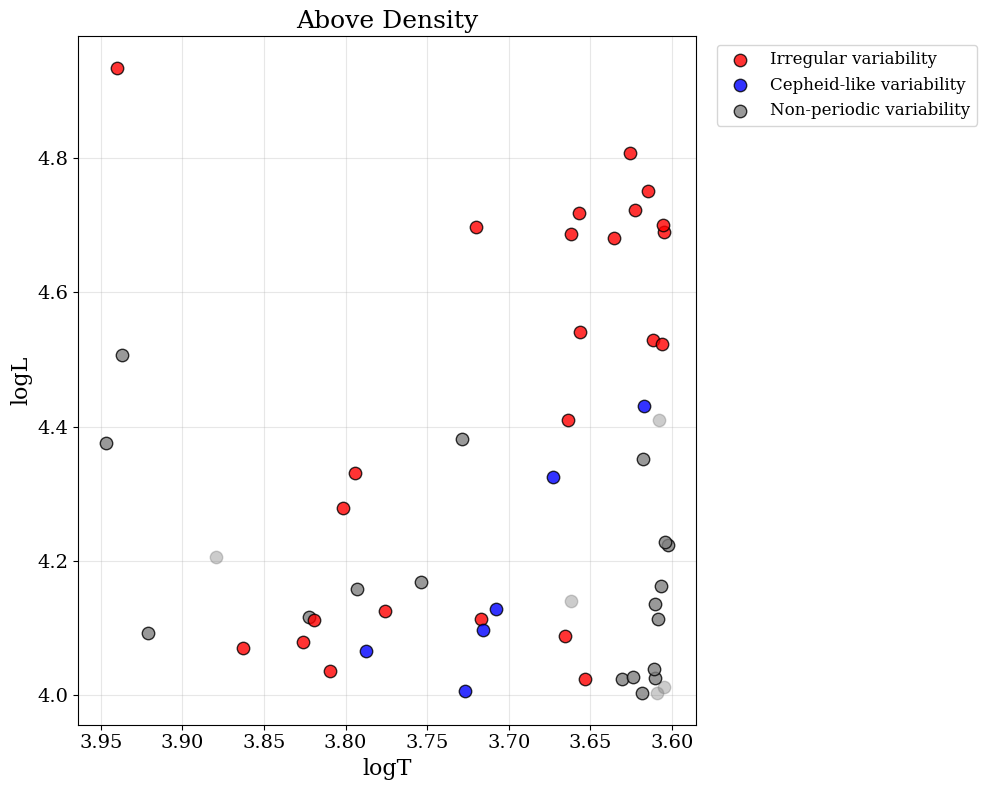

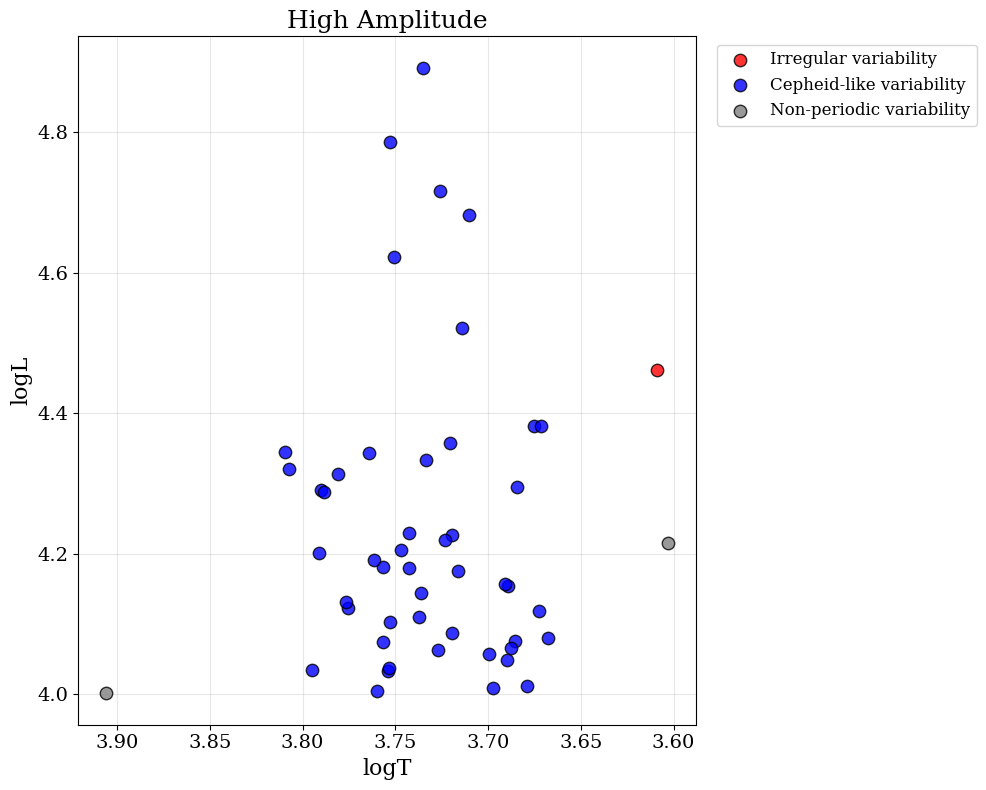

In [29]:
def plot_hr_subset(title, target_indices, annotate=True):
    """
    Plot HR diagram showing ONLY the points in target_indices,
    colored by their membership in combined_red/combined_blue lists.
    
    Parameters:
    -----------
    title : str
        Title for the plot (determines which red/blue lists to use)
    target_indices : list
        List of indices to plot (e.g., above_density_targets or high_amp_targets)
    annotate : bool
        Whether to add index number annotations above each point
    """
    
    # Define red/blue index lists based on title
    if "Above Density" in title:
        combined_red = [96, 105, 114, 156, 172, 188, 241, 250, 299, 307, 537, 584, 592, 596, 597, 613, 668, 669, 696, 716, 719, 780, 788, 834]
        combined_blue = [182, 259, 322, 358, 383, 395]
    elif "High Amplitude" in title:
        combined_red = [729]
        combined_blue = [6,16,17,19,24,36,41,65,78,94,102,154,189,244,247,284,331,341,344,374,384,396,427,436,449,460,470,476,480,486,499,511,516,521,535,546,548,550,559,563,591,640,662,687,702,734,736,817]
    
    # Helper function to annotate points
    def annotate_points(ax, x, y, labels, dy_pts=3, fontsize=8, color='black'):
        for xi, yi, label in zip(x, y, labels):
            ax.annotate(str(label), (xi, yi),
                        textcoords='offset points', xytext=(0, dy_pts),
                        ha='center', va='bottom', fontsize=fontsize, color=color)
    
    # Set up plot
    plt.rcParams['font.family'] = 'serif'
    fig, ax = plt.subplots(figsize=(10, 8))
    
    # Categorize indices
    red_indices = [i for i in target_indices if i in combined_red]
    blue_indices = [i for i in target_indices if i in combined_blue]
    other_indices = [i for i in target_indices if i not in combined_red and i not in combined_blue]
    
    # Plot red points
    if red_indices:
        red_x, red_y = [], []
        for idx in red_indices:  # Fixed: use red_indices instead of combined_red
            red_x.append(stats['logT'].iloc[idx])
            red_y.append(stats['logL'].iloc[idx])

        ax.scatter(red_x, red_y, color='red', alpha=0.8, edgecolors='black', 
                  s=80, label=f'Irregular variability', zorder=3)
        
        if annotate:
            annotate_points(ax, red_x, red_y, red_indices, color='red', fontsize=9)
    
    # Plot blue points
    if blue_indices:
        blue_x, blue_y = [], []
        for idx in blue_indices:
            blue_x.append(stats['logT'].iloc[idx])
            blue_y.append(stats['logL'].iloc[idx])
        
        ax.scatter(blue_x, blue_y, color='blue', alpha=0.8, edgecolors='black', 
                  s=80, label=f'Cepheid-like variability', zorder=3)
        
        if annotate:
            annotate_points(ax, blue_x, blue_y, blue_indices, color='blue', fontsize=9)
    
    # Plot other points (not in red or blue lists)
    if other_indices:
        other_x, other_y = [], []
        for idx in other_indices:
            if stats['alarm_level_flag'].iloc[idx] == 1:
                ax.scatter(stats['logT'].iloc[idx], stats['logL'].iloc[idx], color='gray', alpha=0.4, 
                  s=80, zorder=2) 
            else:
                other_x.append(stats['logT'].iloc[idx])
                other_y.append(stats['logL'].iloc[idx])
        
        ax.scatter(other_x, other_y, color='gray', alpha=0.8, edgecolors='black', 
                  s=80, label=f'Non-periodic variability', zorder=2)
        
        if annotate:
            annotate_points(ax, other_x, other_y, other_indices, color='black', fontsize=9)
    
    # Format plot
    ax.invert_xaxis()
    ax.set_xlabel('logT', fontsize=16)
    ax.set_ylabel('logL', fontsize=16)
    ax.set_title(f'{title}', fontsize=18)
    ax.legend(bbox_to_anchor=(1.02, 1), loc='upper left', fontsize=12)
    ax.grid(True, alpha=0.3)
    
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.tight_layout()
    plt.savefig(f'hr_diagrams/HR_{title.replace(" ", "_").lower()}.png', dpi=300, bbox_inches='tight')
    plt.show()

# Fixed: Use the correct target index lists instead of the DataFrames
plot_hr_subset("Above Density", above_density_targets, annotate=False)
plot_hr_subset("High Amplitude", high_amp_targets, annotate=False)

/var/folders/34/3847lqd14j78mfm70_z1c_r00000gn/T/ipykernel_42756/190483282.py:19: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab20', max(3, len(other_types) + 2))


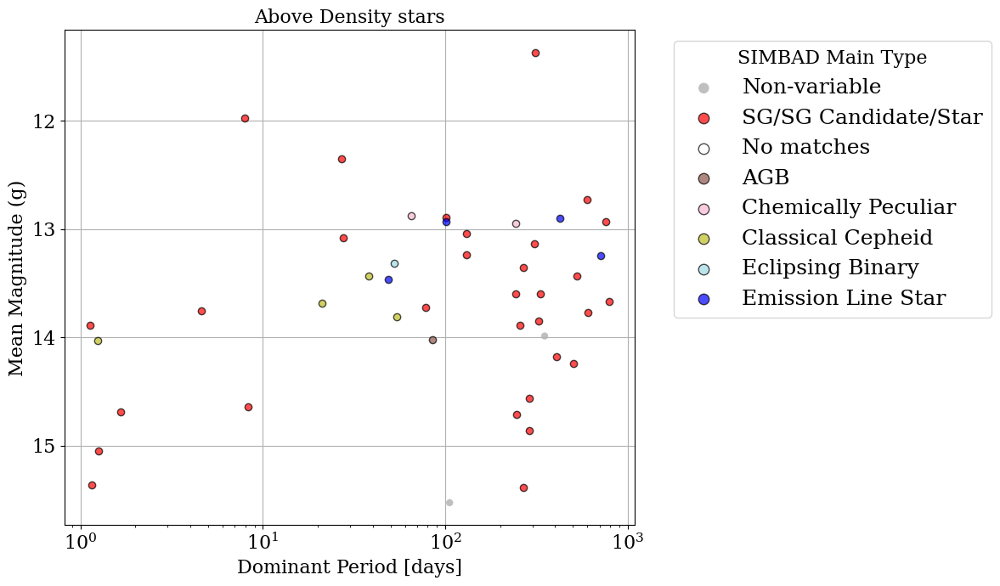

/var/folders/34/3847lqd14j78mfm70_z1c_r00000gn/T/ipykernel_42756/190483282.py:19: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab20', max(3, len(other_types) + 2))


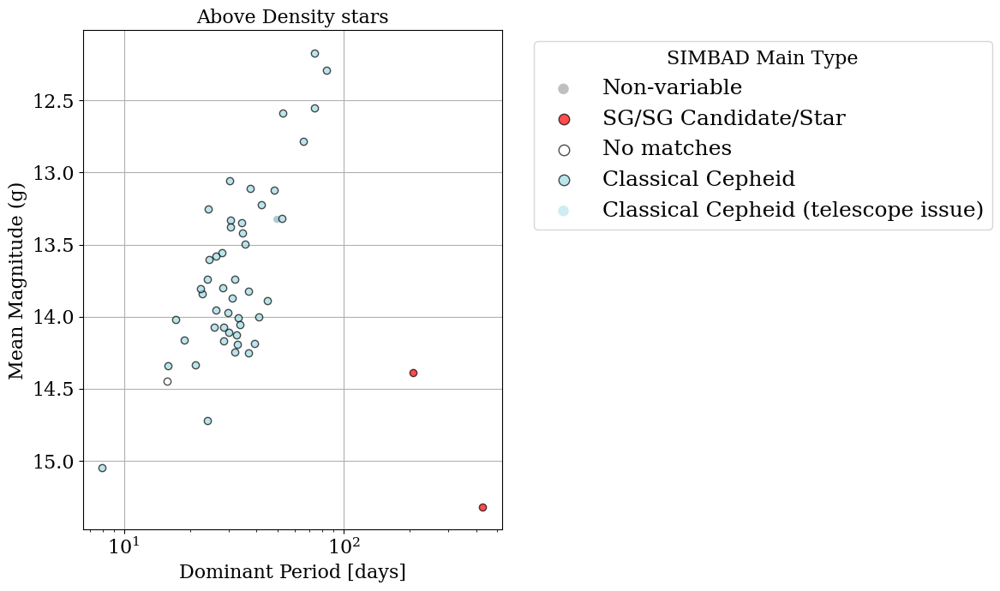

In [30]:
def plot_simbad_crossmatch_subset(xcol, ycol, subset):
    """ Plot the SIMBAD crossmatch data, grouping specified main_types under a single color, and plotting missing main_type as 'Unknown'.
    """
    # plt.figure(figsize=(16, 8))
    plt.figure(figsize=(12,7))
    # Treat empty strings and nan as 'Unknown'
    main_types = subset['main_type'].replace('', np.nan).fillna('Unknown').astype(str)
    # Groups stars, SGs, and candidates together
    grouped_types = set([
        'Star', 'RedSG_Candidate', 'YellowSG', 'RedSG', 'Supergiant',
        'BlueSG', 'YellowSG_Candidate', 'Supergiant_Candidate', 'BlueSG_Candidate'
    ])
    LPV_grouped_types = set(['LongPeriodV*', 'LongPeriodV*_Candidate'])
    is_LPV_grouped = main_types.isin(LPV_grouped_types)
    is_grouped = main_types.isin(grouped_types)
    is_unknown = main_types == 'Unknown'
    other_types = sorted(set(main_types.unique()) - grouped_types - {'Unknown'} - LPV_grouped_types)
    # cmap = cm.get_cmap('nipy_spectral', max(3, len(other_types) + 2))
    cmap = cm.get_cmap('tab20', max(3, len(other_types) + 2))
    grouped_color = cmap(0)
    unknown_color = cmap(1)
    LPV_color = cmap(10)
    other_colors = [cmap(i + 3) for i in range(len(other_types))]

    offset_mask = (subset['offset_flag'] == 0).values
    variable_mask = (subset['alarm_level_flag'] == 0).values
    var_mask = offset_mask & variable_mask
    nonvar_mask = (subset['alarm_level_flag'] == 1).values
    nonvar_mask &= (subset['offset_flag'] == 0).values
    # Plot nonvariable stars in gray
    plt.scatter(subset[xcol][nonvar_mask], subset[ycol][nonvar_mask],
                color='gray', alpha=0.5, edgecolors='none', label='Non-variable', zorder=1)
    # Plot grouped types
    plt.scatter(subset[xcol][var_mask][is_grouped[var_mask]],
                subset[ycol][var_mask][is_grouped[var_mask]],
                label='SG/SG Candidate/Star', color='red', alpha=0.7, edgecolors='black', zorder=3)
    # Plot LPV grouped types
    # plt.scatter(subset[xcol][var_mask][is_LPV_grouped[var_mask]],
    #             subset[ycol][var_mask][is_LPV_grouped[var_mask]],
    #             label='Long Period Variable/Candidate', color='blue', alpha=0.7, edgecolors='black', zorder=4)
    # Plot unknown types (missing main_type)
    plt.scatter(subset[xcol][var_mask][is_unknown[var_mask]],
                subset[ycol][var_mask][is_unknown[var_mask]],
                label='No matches', color='white', alpha=0.7, edgecolors='black', zorder=2)
    # # Plot other types
    for i, t in enumerate(other_types):
        mask = (main_types == t)
        # Plot variable stars of this type
        var_type_mask = var_mask & mask
        if var_type_mask.any():
            if t == 'ChemPec*':
                t = 'Chemically Peculiar'
            if t == 'Be*_Candidate':
                t = 'Be Candidate'
            if t == '**':
                t = 'Close Binary'
            if t == 'C*':
                t = 'Carbon Star'
            if t == 'AGB*':
                t = 'AGB'
            if t == 'ClassicalCep':
                t = 'Classical Cepheid'
            if t == 'EclBin':
                t = 'Eclipsing Binary'
            if t == 'EmLine*':
                t = 'Emission Line Star'
                plt.scatter(subset[xcol][var_type_mask], subset[ycol][var_type_mask],
                        label=f'{t}', color='blue', alpha=0.7, edgecolors='black', zorder=5)
                continue
            if t == 'HighPM*':
                t = 'High Proper Motion Star'
            if t == 'LongPeriodV*' or t == 'LongPeriodV*_Candidate':
                t = 'Long Period Variable/Candidate'
            if t == 'PulsV*':
                t = 'Pulsating Variable'
            if t == 'Variable*':
                t = 'Variable Star'
            plt.scatter(subset[xcol][var_type_mask], subset[ycol][var_type_mask],
                        label=f'{t}', color=other_colors[i], alpha=0.7, edgecolors='black', zorder=5)
        nonvar_type_mask = nonvar_mask & mask
        if nonvar_type_mask.any():
            plt.scatter(subset[xcol][nonvar_type_mask], subset[ycol][nonvar_type_mask],
                label=f'{t} (telescope issue)', color=other_colors[i], alpha=0.5, edgecolors='none')
    # # Plot non-variable stars of this type
    # nonvar_type_mask = nonvar_mask & mask
    # if nonvar_type_mask.any():
    #     plt.scatter(subset[xcol][nonvar_type_mask], subset[ycol][nonvar_type_mask],
    #                 label=f'{t} (Non-variable)', color=other_colors[i], alpha=0.5, edgecolors='none')
    plt.xlabel(xcol, fontsize=18)
    plt.ylabel(ycol, fontsize=18)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.xlabel('Dominant Period [days]', fontsize=16)
    plt.ylabel('Mean Magnitude (g)', fontsize=16)
    # invert y axis
    plt.gca().invert_yaxis()
    plt.xscale('log')
    # plt.ylabel('Amplitude [mag]', fontsize=16)
    # plt.title('SIMBAD Crossmatch: Main Type Distribution', fontsize=16)
    plt.legend(title='SIMBAD Main Type', bbox_to_anchor=(1.05, 1), loc='upper left', title_fontsize=16, fontsize=18, markerscale=1.5)
    plt.grid(True, zorder=0)
    plt.title("Above Density stars", fontsize=16)
    plt.tight_layout()
    # plt.savefig(f'hr_diagrams/simbad_crossmatch_{xcol}_{ycol}.pdf', dpi=300, bbox_inches='tight')
    plt.show()
# plot_simbad_crossmatch_tidy('best_period', 'mag_amplitude_1')
plot_simbad_crossmatch_subset('best_period', 'overall_mean_mag', above_density)
plot_simbad_crossmatch_subset('best_period', 'overall_mean_mag', high_amp)
# plot_simbad_crossmatch('overall_mean_mag', 'mag_amplitude_1')

In [31]:
def mag_amplitude_annotated(column):
    plt.figure(figsize=(16, 8))
    c = stats[column]
    mask = (stats['offset_flag'] == 0).values
    variable_mask = (stats['alarm_level_flag'] == 0).values
    nonvariable_mask = (stats['alarm_level_flag'] == 1).values
    # Combine both masks: only select rows where both are True
    var_mask = mask & variable_mask
    nonvar_mask = mask & nonvariable_mask
    sc2 = plt.scatter(stats['overall_mean_mag'][nonvar_mask], stats['mag_amplitude_1'][nonvar_mask], c='gray', alpha=0.7, edgecolors='none', label='Non-periodic', zorder=1)
    sc1 = plt.scatter(stats['overall_mean_mag'][var_mask], stats['mag_amplitude_1'][var_mask], c=c[var_mask], cmap='inferno', alpha=0.6, edgecolors='black', label = 'Periodic Variable', zorder=2)
    idxs = [760, 729, 267]
    for idx in idxs:
        # Check if the index exists and meets the variable criteria
        if idx < len(stats) and var_mask[idx]:
            annotate_points(
                plt.gca(),
                [stats['overall_mean_mag'].iloc[idx]],
                [stats['mag_amplitude_1'].iloc[idx]],
                [idx],
                color='blue',
                fontsize=9
            )
    # sc2 = plt.scatter(stats['overall_mean_mag'][nonvar_mask], stats['mag_amplitude_1'][nonvar_mask], c='gray', alpha=0.5, edgecolors='none', label='Non-variable')
    cbar = plt.colorbar(sc1)
    cbar.set_label('Dominant Period [days]', fontsize=20)
    cbar.ax.tick_params(labelsize=20)
    plt.legend(fontsize=20)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    plt.xlabel('Mean Magnitude (g)', fontsize=20)
    plt.ylabel('Amplitude [mag]', fontsize=20)
    plt.grid(True, zorder=0)
    plt.savefig(f'hr_diagrams/mag_amp_period_annotated.pdf', dpi=300, bbox_inches='tight')
    plt.show()
# mag_amplitude_annotated('best_period')

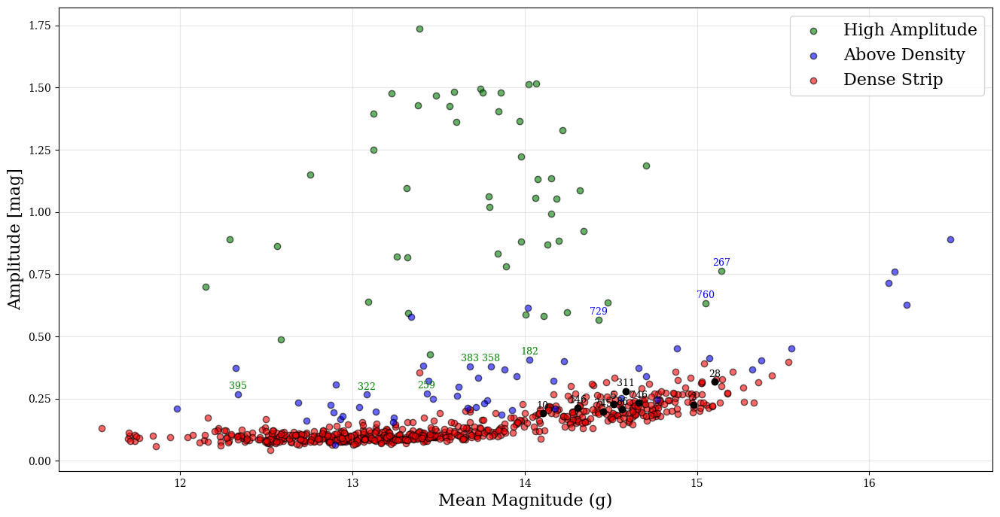

In [32]:
fig, ax = plt.subplots(figsize=(16, 8))

# High Amplitude points
high_amp_x = [stats['overall_mean_mag'][target] for target in high_amp_targets]
high_amp_y = [stats['mag_amplitude_1'][target] for target in high_amp_targets]
ax.scatter(high_amp_x, high_amp_y, c='green', alpha=0.6, edgecolors='black', label='High Amplitude')

# Annotate specific high_amp_targets
for target in high_amp_targets:
    if target in [760, 729, 267]:
        ax.annotate(f'{target}', (stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target]),textcoords='offset points', xytext=(0, 3),
                        ha='center', va='bottom', fontsize=9, color = 'blue')

# Above Density points
above_density_x = [stats['overall_mean_mag'][target] for target in above_density_targets]
above_density_y = [stats['mag_amplitude_1'][target] for target in above_density_targets]
ax.scatter(above_density_x, above_density_y, c='blue', alpha=0.6, edgecolors='black', label='Above Density')

for target in above_density_targets:
    if target in [182, 259, 322, 358, 383, 395]:
        plt.annotate(f'{target}', (stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target]),textcoords='offset points', xytext=(0, 3),
                        ha='center', va='bottom', fontsize=9, color = 'green')
        
dense_strip_x = [stats['overall_mean_mag'][target] for target in dense_strip_targets]
dense_strip_y = [stats['mag_amplitude_1'][target] for target in dense_strip_targets]
ax.scatter(dense_strip_x, dense_strip_y, c='red', alpha=0.6, edgecolors='black', label='Dense Strip', zorder = 0)

for target in dense_strip_targets:
    if stats['RA'][target] in [11.399051, 12.42137, 16.050177, 84.382455, 7.925977, 84.311686,7.981742, 12.779685, 13.378894, 8.763859] and stats['DEC'][target] in [-73.293671, 72.301399, -72.978088, -70.299202, -73.53167, -70.506462, -73.585571, -72.998734,  -72.532722, -74.203384]:
        ax.scatter(stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target], c='black', zorder = 10)
        ax.annotate(f'{target}', (stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target]), textcoords='offset points', xytext=(0, 3),
                    ha='center', va='bottom', fontsize=9, color='black')


from matplotlib.lines import Line2D
custom_lines = [Line2D([0], [0], color='green', lw=2),
                Line2D([0], [0], color='blue', lw=2),
                Line2D([0], [0], color='black', lw=2),]
legend1 = plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', fontsize=10)
# legend2 = plt.legend(custom_lines, ['Irregular', 'Cepheid-like', 'Non-periodic'], 
#                      bbox_to_anchor=(1.02, 0), loc='lower left', fontsize=10, title='By-eye')
ax.add_artist(legend1)
plt.grid(True, alpha=0.3)

plt.ylabel('Amplitude [mag]', fontsize=16)
plt.xlabel('Mean Magnitude (g)', fontsize=16)
plt.legend(fontsize=16)
plt.show()

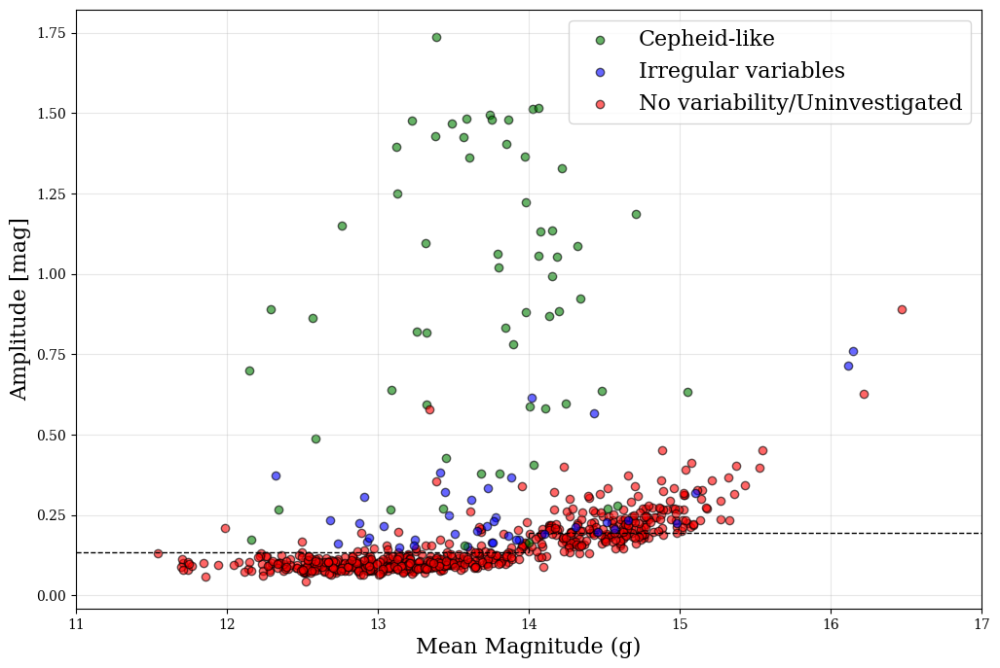

In [33]:
fig, ax = plt.subplots(figsize=(12, 8))

above_density_no_var = [8, 118, 129, 133, 143, 153, 160, 174, 210, 214, 217, 225, 248, 272, 364, 524, 540, 572, 576, 680, 743, 752, 823]
above_density_cephs = [182, 259, 322, 358, 383, 395]

# High Amplitude points
high_amp_x = [stats['overall_mean_mag'][target] for target in high_amp_targets if target not in [760, 729, 267]]
high_amp_y = [stats['mag_amplitude_1'][target] for target in high_amp_targets if target not in [760, 729, 267]]
ax.scatter(high_amp_x, high_amp_y, c='green', alpha=0.6, edgecolors='black', label='Cepheid-like')

# Annotate specific high_amp_targets
for target in high_amp_targets:
    # ax.annotate(f'{target}', (stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target]), textcoords='offset points', xytext=(0, 3),
    #                 ha='center', va='bottom', fontsize=9, color='black')
    if target in [729]:
        ax.scatter(stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target], c='blue', alpha=0.6, edgecolors='black')
    if target in [760]:
        ax.scatter(stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target], c='green', alpha=0.6, edgecolors='black')
        # ax.annotate(f'short-period, high T', (stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target]), textcoords='offset points', xytext=(0, 3),
        #             ha='center', va='bottom', fontsize=9, color='black')
    # if target in [267]:
    #     ax.scatter(stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target], c='red', alpha=0.6, edgecolors='black')
    #     ax.annotate(f'offset', (stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target]), textcoords='offset points', xytext=(-3, 3),
    #                 ha='center', va='bottom', fontsize=9, color='black')
    


# Above Density points
above_density_x = [stats['overall_mean_mag'][target] for target in above_density_targets if target not in above_density_cephs and target not in above_density_no_var]
above_density_y = [stats['mag_amplitude_1'][target] for target in above_density_targets if target not in above_density_cephs and target not in above_density_no_var]
ax.scatter(above_density_x, above_density_y, c='blue', alpha=0.6, edgecolors='black', label='Irregular variables')

for target in above_density_targets:
    # ax.annotate(f'{target}', (stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target]), textcoords='offset points', xytext=(0, 3),
    #                 ha='center', va='bottom', fontsize=9, color='black')
    if target in above_density_cephs:
        ax.scatter(stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target], c='green', alpha=0.6, edgecolors='black')
    if target in above_density_no_var:
        ax.scatter(stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target], c='red', alpha=0.6, edgecolors='black')



dense_strip_cephs_ras = [12.42137, 16.050177, 12.482258, 17.22848, 83.935222]
dense_strip_cephs_decs = [-72.301399, -72.978088, -73.047455, -72.414505, -66.882256]
dense_strip_irreg_ras = [13.863108, 76.938948, 81.775145, 81.135044, 81.00443, 13.14854, 16.571746, 83.069673, 11.399051, 84.382455, 7.925977, 84.311686,7.981742, 12.779685, 13.378894, 8.763859]
dense_strip_irreg_decs = [-71.555687, -69.162407, -66.746681, -68.498512, -71.160744, -72.851479, -72.462975, -66.395912, -73.293671, -70.299202, -73.53167, -70.506462, -73.585571, -72.998734,  -72.532722, -74.203384]
  
dense_strip_x = [stats['overall_mean_mag'][target] for target in dense_strip_targets if stats['RA'][target] not in dense_strip_cephs_ras and stats['DEC'][target] not in dense_strip_cephs_decs and stats['RA'][target] not in dense_strip_irreg_ras and stats['DEC'][target] not in dense_strip_irreg_decs]
dense_strip_y = [stats['mag_amplitude_1'][target] for target in dense_strip_targets if stats['RA'][target] not in dense_strip_cephs_ras and stats['DEC'][target] not in dense_strip_cephs_decs and stats['RA'][target] not in dense_strip_irreg_ras and stats['DEC'][target] not in dense_strip_irreg_decs]
ax.scatter(dense_strip_x, dense_strip_y, c='red', alpha=0.6, edgecolors='black', label='No variability/Uninvestigated', zorder = 0)

for target in dense_strip_targets:
    # if stats['mag_amplitude_1'][target] > 0.1335 and stats['overall_mean_mag'][target] < 14:
    #     ax.annotate(f'{target}', (stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target]), textcoords='offset points', xytext=(0, 3),
    #                 ha='center', va='bottom', fontsize=9, color='black')
    # if stats['mag_amplitude_1'][target] > 0.1927 and stats['overall_mean_mag'][target] > 14:
    #     ax.annotate(f'{target}', (stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target]), textcoords='offset points', xytext=(0, 3),
    #                 ha='center', va='bottom', fontsize=9, color='black') 
    if stats['RA'][target] in dense_strip_cephs_ras and stats['DEC'][target] in dense_strip_cephs_decs:
        ax.scatter(stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target], c='green',alpha = 0.6,edgecolors='black', zorder = 10)
    if stats['RA'][target] in dense_strip_irreg_ras and stats['DEC'][target] in dense_strip_irreg_decs:
        ax.scatter(stats['overall_mean_mag'][target], stats['mag_amplitude_1'][target], c='blue', alpha=0.6, edgecolors='black', zorder=10)

from matplotlib.lines import Line2D
custom_lines = [Line2D([0], [0], color='green', lw=2),
                Line2D([0], [0], color='blue', lw=2),
                Line2D([0], [0], color='black', lw=2),]
legend1 = plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', fontsize=10)
# legend2 = plt.legend(custom_lines, ['Irregular', 'Cepheid-like', 'Non-periodic'], 
#                      bbox_to_anchor=(1.02, 0), loc='lower left', fontsize=10, title='By-eye')
ax.add_artist(legend1)
plt.grid(True, alpha=0.3)
# plt.axhline(y=0.1927, color='k', linestyle='--', lw=1)
plt.hlines(y=0.1335, xmin=11, xmax=14, colors='black', linestyles='dashed', linewidth=1)
plt.hlines(y=0.1927, xmin=14, xmax=17, colors='black', linestyles='dashed', linewidth=1)
plt.vlines(x=14, ymin=0.1335, ymax=0.1927, colors='black', linestyles='dashed', linewidth=1)
plt.xlim(11, 17)
plt.ylabel('Amplitude [mag]', fontsize=16)
plt.xlabel('Mean Magnitude (g)', fontsize=16)
plt.legend(fontsize=16)
plt.savefig('hr_diagrams/visual_examination.png', dpi = 300, bbox_inches='tight')
plt.show()

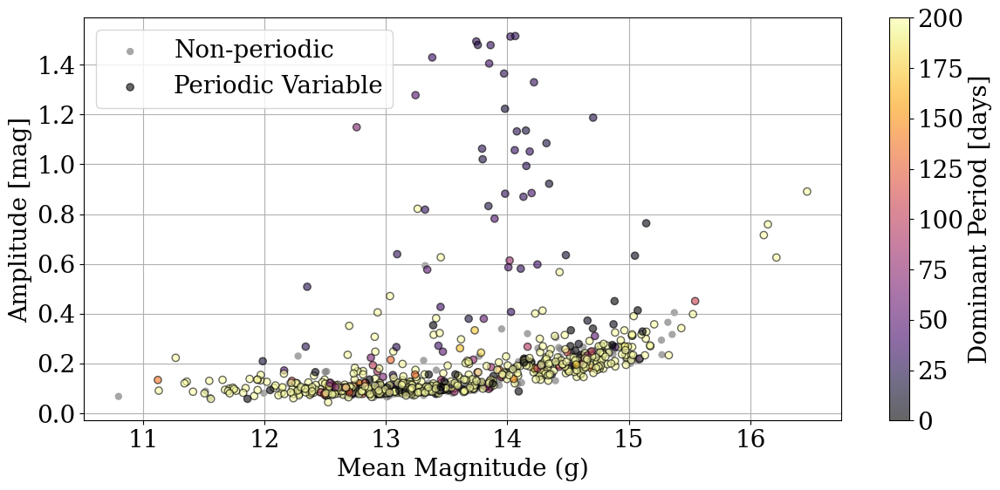

In [34]:
mag_amplitude_plot('best_period', 200)

telescope i 74 0.1544885177453027
telescope j 75 0.16778523489932887
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope n 26 0.09352517985611511
telescope m 14 0.050724637681159424
telescope E 83 0.1873589164785553
telescope F 71 0.16397228637413394
telescope G 126 0.20621931260229132
Most data telescope in window: G
RA: 15.993419, DEC: -71.90551


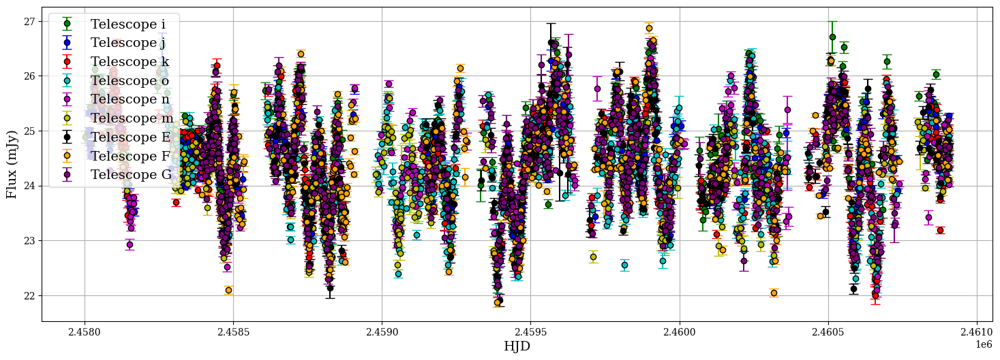

In [35]:
fit_plotter_flux(307, newfiles=False)

telescope i 66 0.11092436974789915
telescope m 99 0.14666666666666667
telescope E 173 0.2386206896551724
Most data telescope in window: E
RA: 78.285377, DEC: -70.139542


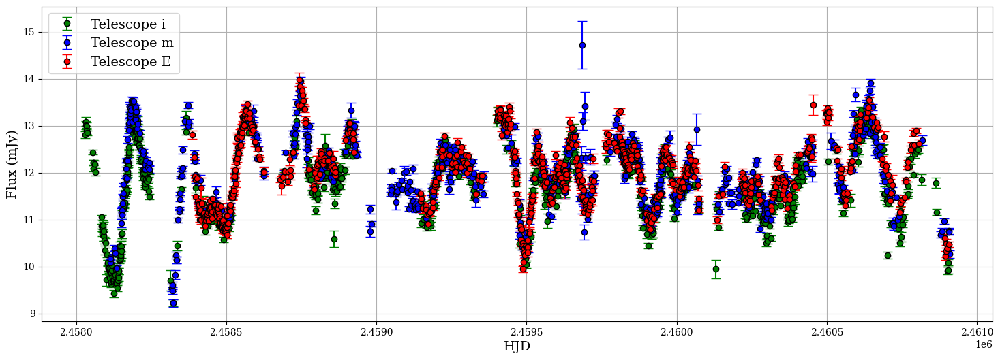

telescope k 56 0.12147505422993492
telescope o 107 0.16411042944785276
telescope H 130 0.21885521885521886
telescope G 127 0.2081967213114754
Most data telescope in window: H
RA: 15.056647, DEC: -72.352814


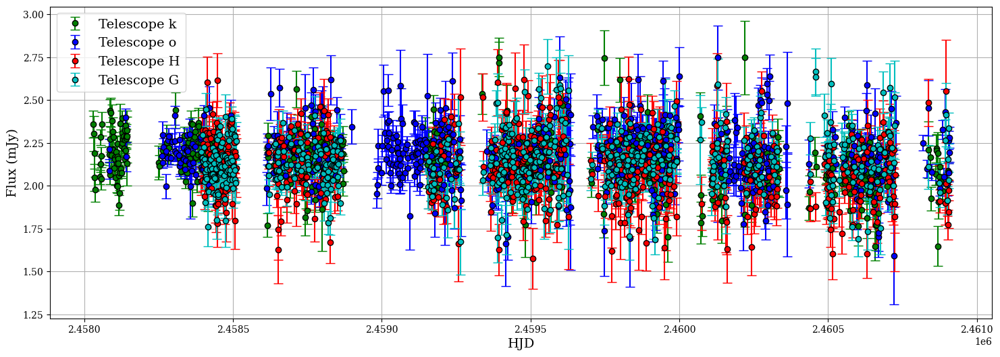

telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope G 127 0.20751633986928106
Most data telescope in window: G
RA: 18.325872, DEC: -73.363472


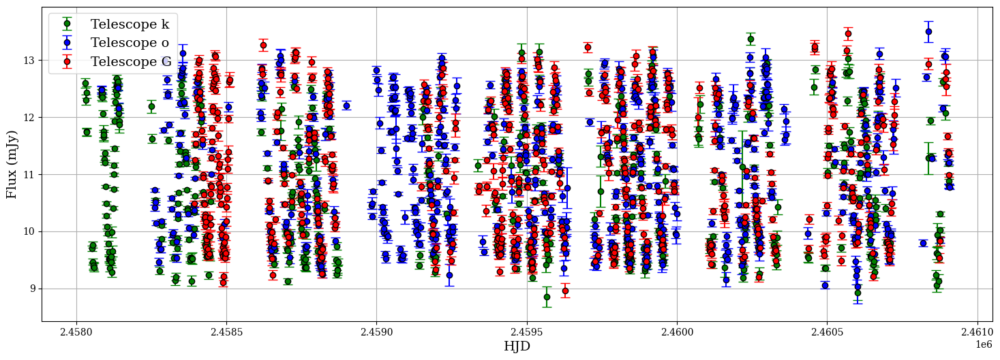

telescope i 74 0.15416666666666667
telescope j 75 0.16741071428571427
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope n 20 0.09009009009009009
telescope m 14 0.050724637681159424
telescope E 83 0.18778280542986425
telescope F 57 0.1743119266055046
telescope G 127 0.20751633986928106
Most data telescope in window: G
RA: 15.787205, DEC: -71.930763


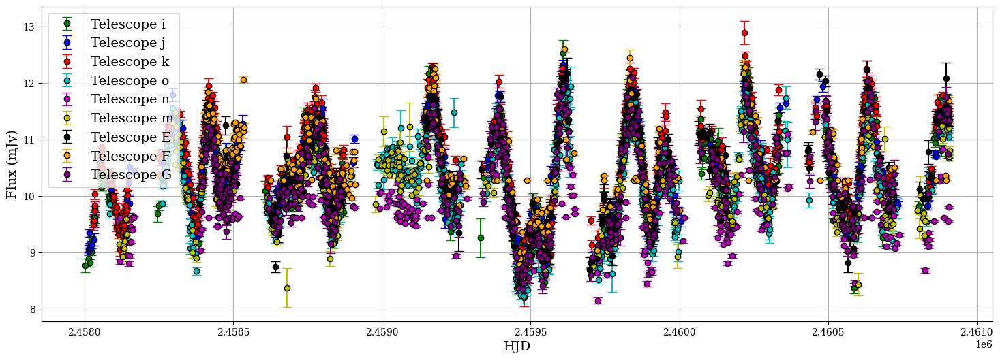

In [36]:
fit_plotter_flux(584)
# fit_plotter_flux(383)
fit_plotter_flux(272)
fit_plotter_flux(358)
fit_plotter_flux(299)

Text(0, 0.5, 'logL')

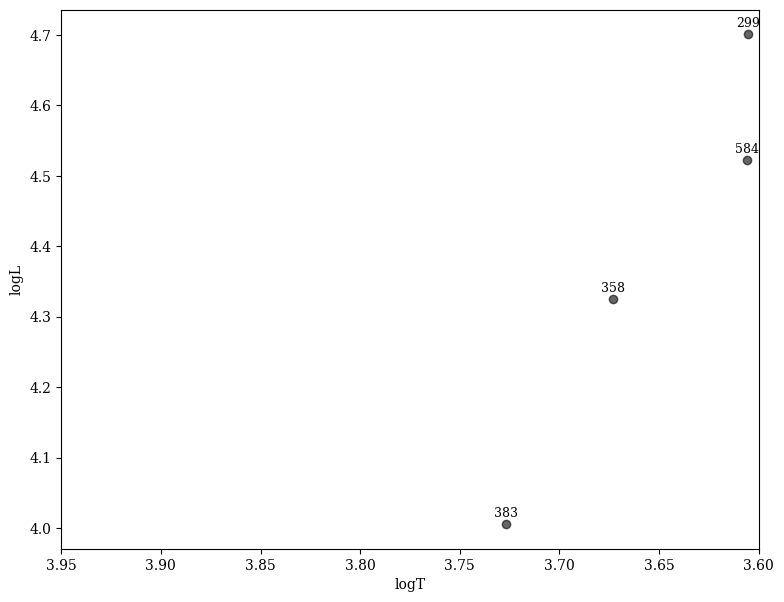

In [37]:
# plot hr diagram of just targets 299, 383, 358, 584
fig, ax = plt.subplots(figsize=(9, 7))
plt.scatter([stats['logT'][target] for target in [299, 383, 358, 584]],
            [stats['logL'][target] for target in [299, 383, 358, 584]],
            c='black', alpha=0.6, edgecolors='black')
plt.annotate(f'299', (stats['logT'][299], stats['logL'][299]), textcoords='offset points', xytext=(0, 3),
             ha='center', va='bottom', fontsize=9, color='black')
plt.annotate(f'358', (stats['logT'][358], stats['logL'][358]), textcoords='offset points', xytext=(0, 3),
             ha='center', va='bottom', fontsize=9, color='black')
plt.annotate(f'383', (stats['logT'][383], stats['logL'][383]), textcoords='offset points', xytext=(0, 3),
             ha='center', va='bottom', fontsize=9, color='black')
plt.annotate(f'584', (stats['logT'][584], stats['logL'][584]), textcoords='offset points', xytext=(0, 3),
             ha='center', va='bottom', fontsize=9, color='black')
ax.invert_xaxis()
ax.set_xlim(3.95, 3.6)
ax.set_xlabel('logT')
ax.set_ylabel('logL')

target: 311


telescope k 56 0.12121212121212122
telescope o 108 0.16338880484114976
telescope G 127 0.20751633986928106
Most data telescope in window: G
RA: 16.050177, DEC: -72.978088


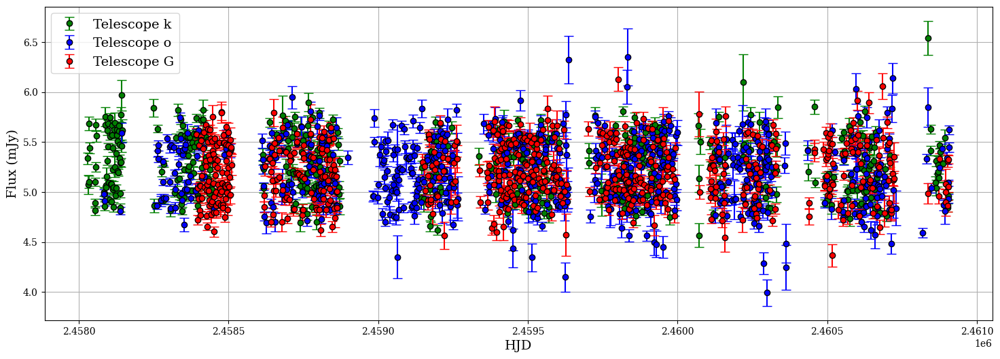

target: 66
telescope k 56 0.12173913043478261
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 134 0.22112211221122113
Most data telescope in window: H
RA: 12.42137, DEC: -72.301399


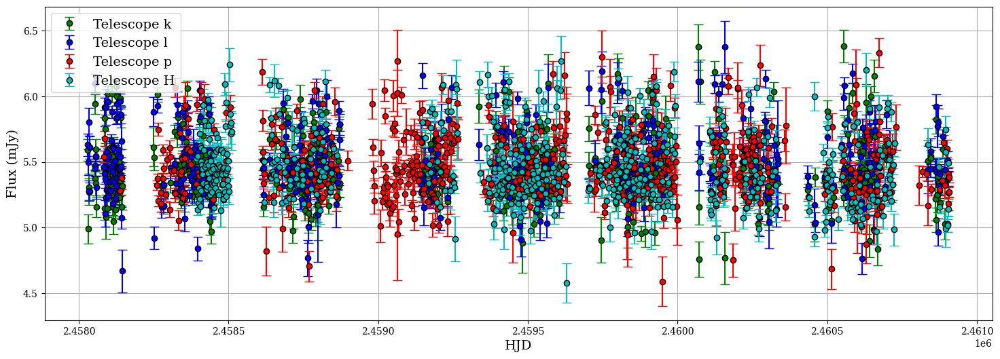

target: 315
telescope j 75 0.16741071428571427
telescope k 56 0.12121212121212122
telescope o 107 0.16187594553706505
telescope E 60 0.1791044776119403
telescope G 127 0.2078559738134206
Most data telescope in window: G
RA: 16.197788, DEC: -72.044441


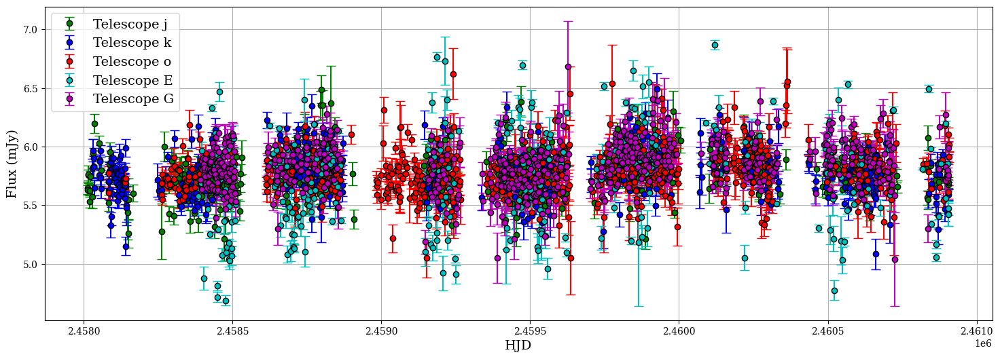

Text(0, 0.5, 'logL')

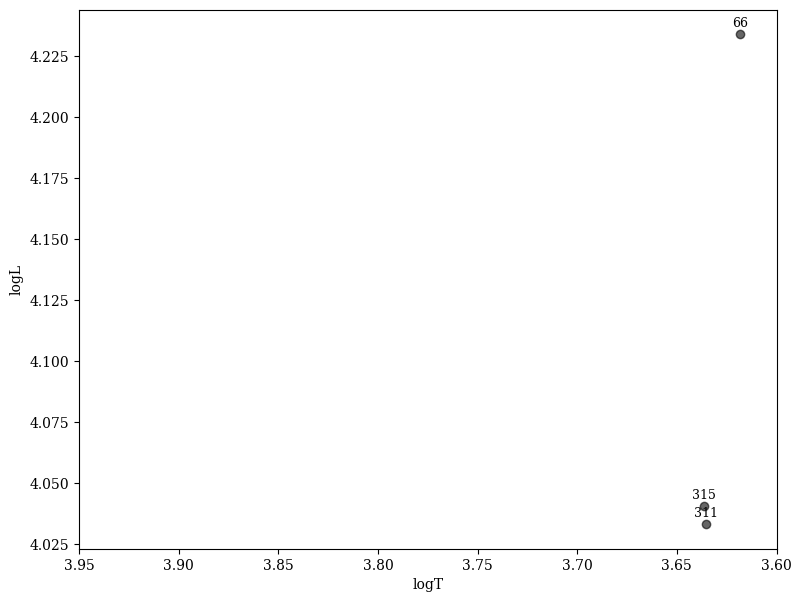

In [38]:
print(f"target: {311}")
fit_plotter_flux(311)
print(f"target: {66}")
fit_plotter_flux(66)
print(f"target: {315}")
fit_plotter_flux(315)

# plot hr diagram of just targets 311, 66, 315
fig, ax = plt.subplots(figsize=(9, 7))
plt.scatter([stats['logT'][target] for target in [311, 66, 315]],
            [stats['logL'][target] for target in [311, 66, 315]],
            c='black', alpha=0.6, edgecolors='black')
plt.annotate(f'311', (stats['logT'][311], stats['logL'][311]), textcoords='offset points', xytext=(0, 3),
             ha='center', va='bottom', fontsize=9, color='black')
plt.annotate(f'66', (stats['logT'][66], stats['logL'][66]), textcoords='offset points', xytext=(0, 3),
             ha='center', va='bottom', fontsize=9, color='black')
plt.annotate(f'315', (stats['logT'][315], stats['logL'][315]), textcoords='offset points', xytext=(0, 3),
             ha='center', va='bottom', fontsize=9, color='black')
ax.invert_xaxis()
ax.set_xlim(3.95, 3.6)
ax.set_xlabel('logT')
ax.set_ylabel('logL')

telescope l 52 0.12682926829268293
telescope k 56 0.12307692307692308
telescope o 101 0.16777408637873753
telescope p 103 0.16118935837245696
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 13.611973, DEC: -72.883247


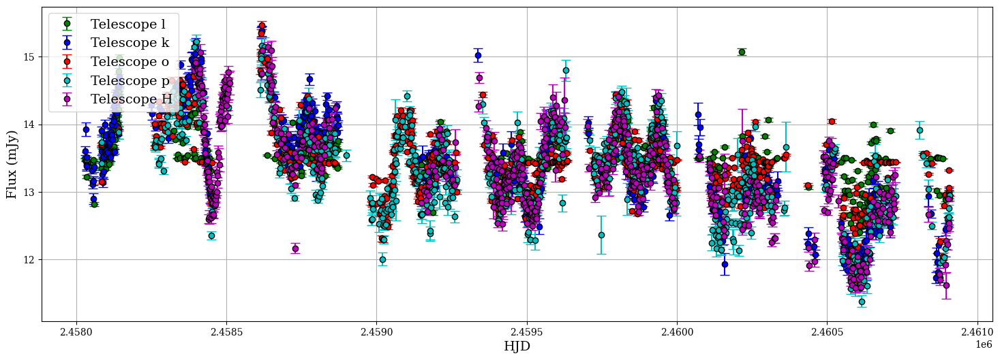

telescope k 56 0.12147505422993492
telescope o 108 0.16314199395770393
telescope G 127 0.20751633986928106
Most data telescope in window: G
RA: 18.861405, DEC: -73.337494


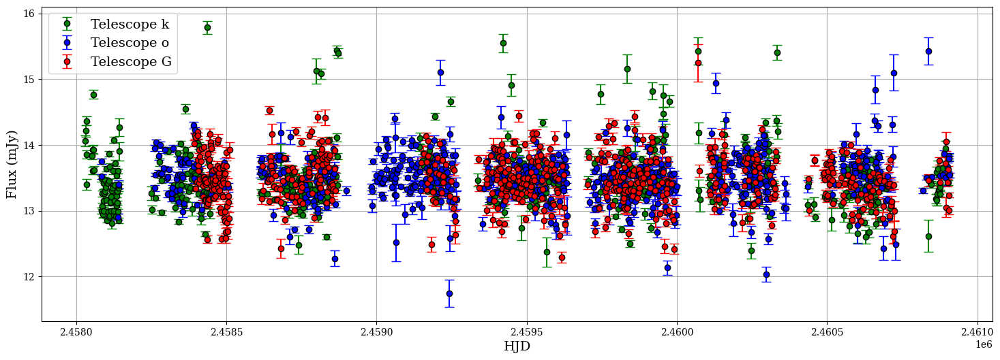

In [39]:
fit_plotter_flux(172)
fit_plotter_flux(364)

telescope k 60 0.10507880910683012
telescope o 125 0.18221574344023322
Most data telescope in window: o
RA: 86.507263, DEC: -66.990051


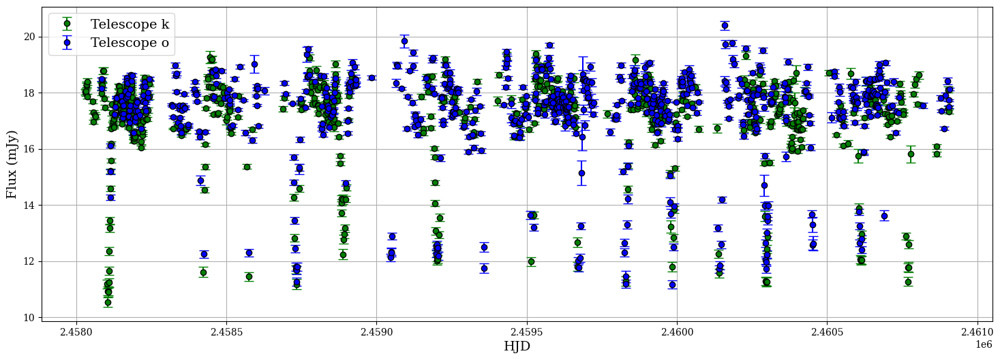

telescope k 60 0.10507880910683012
telescope o 125 0.18221574344023322
telescope n 30 0.06993006993006994
Most data telescope in window: o
RA: 86.136478, DEC: -67.576225


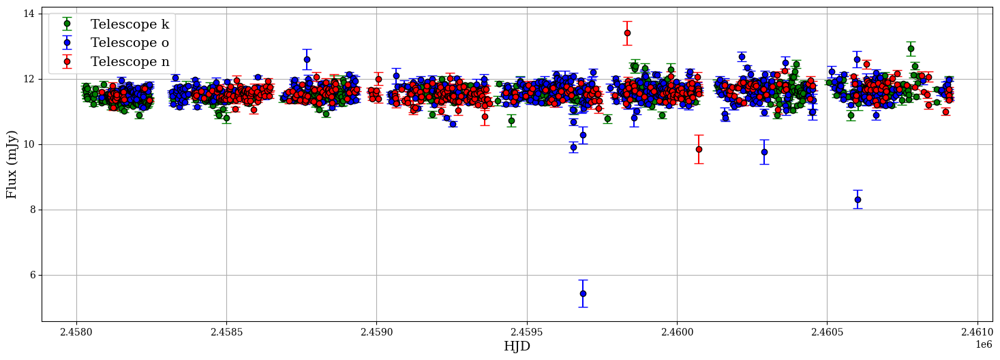

In [40]:
fit_plotter_flux(823)
fit_plotter_flux(813)

In [41]:
for target in high_amp_targets:
    if target in [760, 729, 267]:
        print(f'{stats["RA"][target]},{stats["DEC"][target]}')
print('above_density cephs')
for target in above_density_cephs:
    print(f'{stats["RA"][target]},{stats["DEC"][target]}')
print('above_density no var')
for target in above_density_no_var:
    print(f'{stats["RA"][target]},{stats["DEC"][target]}')

14.925954,-72.163506
83.724042,-69.133911
84.783639,-70.337944
above_density cephs
13.673452,-73.128853
14.729435,-72.552078
16.445653,-71.772797
18.325872,-73.363472
71.327625,-69.27739
72.485769,-69.755859
above_density no var
8.637665,-73.873337
13.1687,-72.745171
13.256099,-72.399757
13.279305,-72.171394
13.350006,-73.11042
13.42474,-72.908089
13.477901,-72.437256
13.627097,-72.570183
14.004046,-72.460983
14.037303,-72.277908
14.061519,-72.42244
14.127534,-72.231476
14.472561,-72.083511
15.056647,-72.352814
18.861405,-73.337494
76.209054,-68.13121
76.614966,-68.364449
77.660807,-69.715027
77.946825,-69.4328
82.256902,-66.649391
84.266308,-69.167656
84.661939,-69.13736
86.507263,-66.990051


## Close to each other on the magnitude-amplitude diagram:

telescope k 56 0.12147505422993492
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 13.14854, DEC: -72.851479


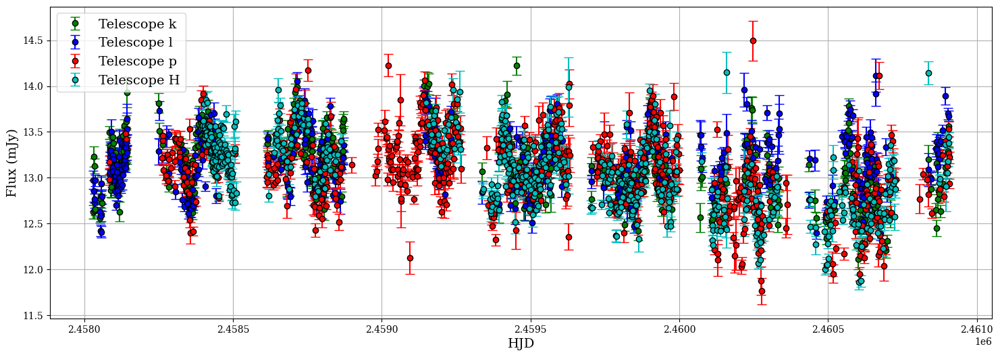

telescope k 56 0.12200435729847495
telescope o 106 0.16434108527131783
telescope G 123 0.20534223706176963
Most data telescope in window: G
RA: 17.22848, DEC: -72.414505


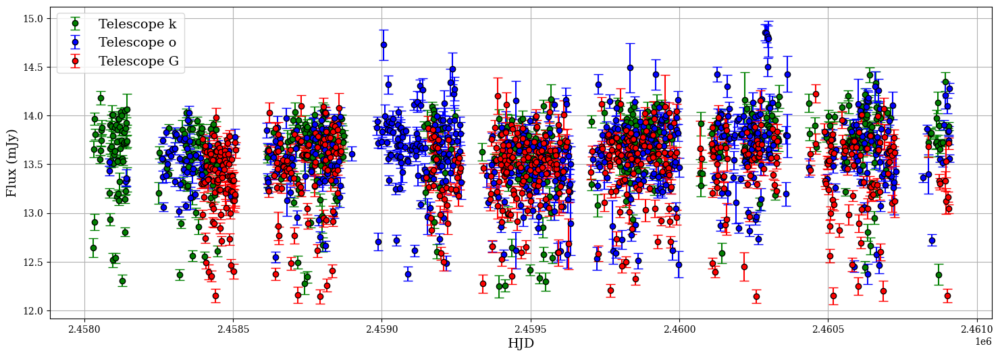

telescope i 66 0.1116751269035533
telescope m 98 0.14605067064083457
telescope E 170 0.23809523809523808
Most data telescope in window: E
RA: 81.00443, DEC: -71.160744


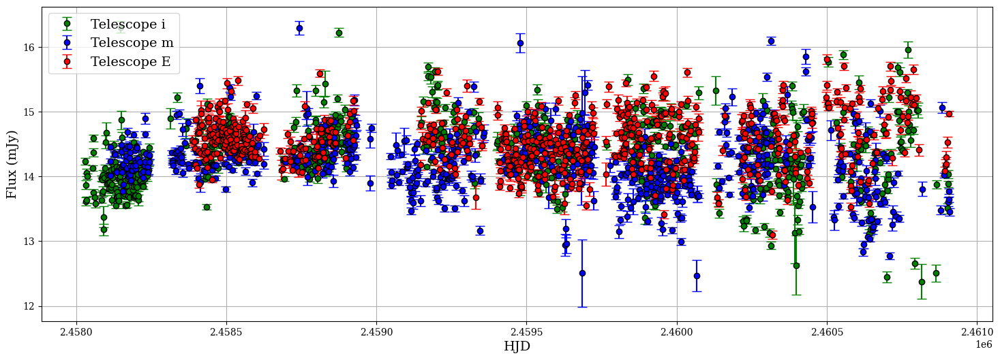

In [42]:
fit_plotter_flux(115)
fit_plotter_flux(347)
fit_plotter_flux(635)

telescope l 52 0.12682926829268293
telescope k 56 0.12307692307692308
telescope o 101 0.16777408637873753
telescope p 103 0.16118935837245696
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 13.611973, DEC: -72.883247


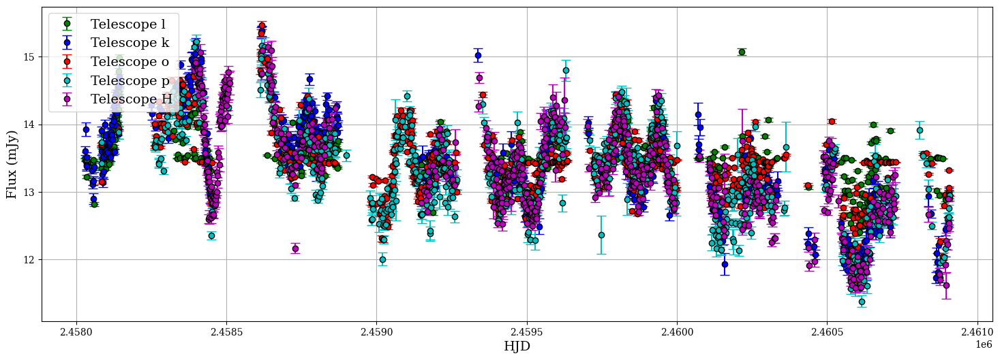

telescope k 56 0.12147505422993492
telescope o 108 0.16314199395770393
telescope G 127 0.20751633986928106
Most data telescope in window: G
RA: 18.861405, DEC: -73.337494


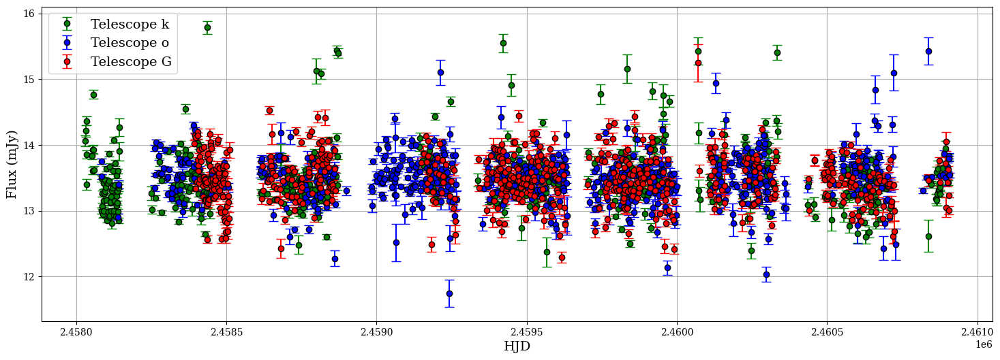

In [43]:
fit_plotter_flux(172)
fit_plotter_flux(364)

telescope k 56 0.12147505422993492
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22203947368421054
Most data telescope in window: H
RA: 12.419711, DEC: -73.236916


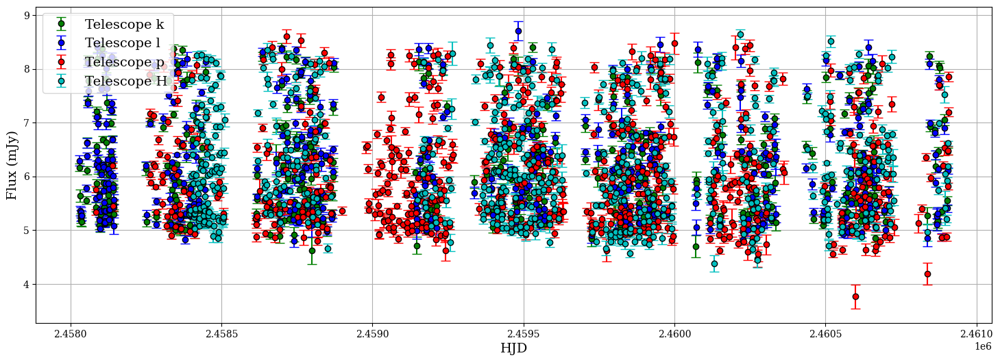

telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 102 0.15987460815047022
telescope H 135 0.22240527182866557
telescope G 127 0.2078559738134206
Most data telescope in window: H
RA: 14.925954, DEC: -72.163506


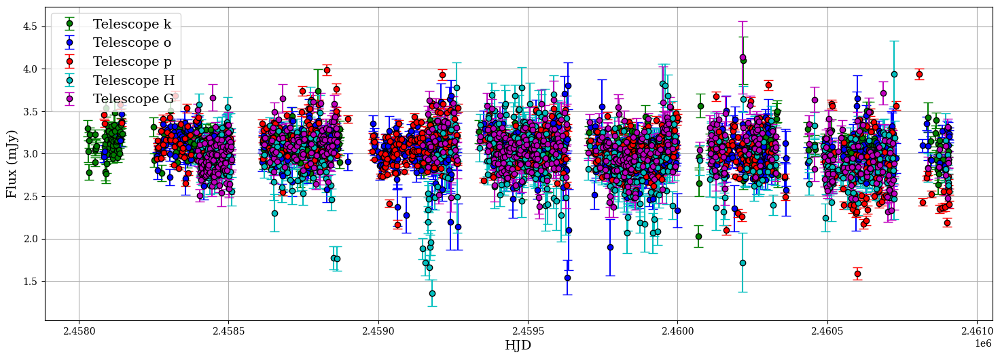

telescope i 74 0.15416666666666667
telescope j 75 0.16741071428571427
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope n 27 0.09473684210526316
telescope m 14 0.050724637681159424
telescope E 83 0.1873589164785553
telescope F 76 0.1613588110403397
telescope G 127 0.2113144758735441
Most data telescope in window: G
RA: 16.445653, DEC: -71.772797


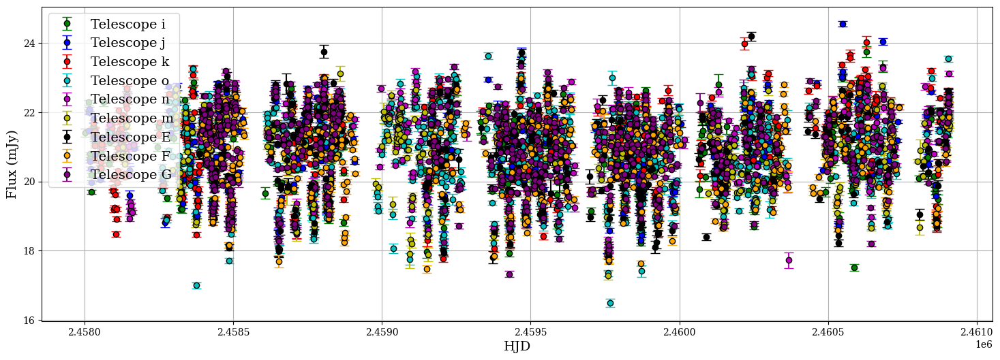

In [44]:
fit_plotter_flux(65)
fit_plotter_flux(267)
fit_plotter_flux(322)

# looking at high T, short-period star

telescope i 66 0.11092436974789915
telescope j 97 0.1658119658119658
telescope n 30 0.06993006993006994
telescope m 97 0.14434523809523808
telescope E 173 0.2386206896551724
Most data telescope in window: E
RA: 84.783639, DEC: -70.337944


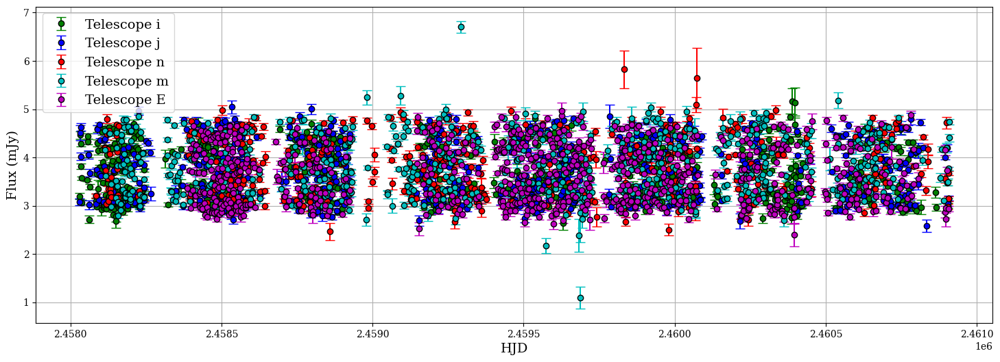

In [45]:
fit_plotter_flux(760)

In [46]:
print(stats.iloc[760])

RA                        84.783639
DEC                      -70.337944
overall_mean               3.713816
overall_median             3.655000
overall_mean_mag          15.050462
overall_median_mag        15.055000
offset_flag                0.000000
chi_squared_68        265706.821673
chi2_threshold_68       3040.732610
chi_flag_68                0.000000
chi_squared_95        265706.821673
chi2_threshold_95       3133.642809
chi_flag_95                0.000000
chi_squared_997       265706.821673
chi2_threshold_997      3222.388224
chi_flag_997               0.000000
amplitude_5                1.749537
lower_percentile_5         2.916865
upper_percentile_5         4.666403
mag_amplitude_5            0.521750
amplitude_1                2.130221
lower_percentile_1         2.736085
upper_percentile_1         4.866306
mag_amplitude_1            0.632900
largest_amp                5.609266
best_period                7.962833
alarm_level_flag           0.000000
std_amplitude              0

In [47]:
# # Read both CSV files
# dense_strip = pd.read_csv('dense_strip.csv')
# high_amp = pd.read_csv('high_amp.csv')

# # Find the star to move (RA: 12.419711, DEC: -73.236916)
# target_ra = 12.419711
# target_dec = -73.236916

# # Find the row in dense_strip.csv
# star_mask = (abs(dense_strip['RA'] - target_ra) < 1e-6) & (abs(dense_strip['DEC'] - target_dec) < 1e-6)
# star_row = dense_strip[star_mask].copy()

# if len(star_row) == 0:
#     print("Star not found in dense_strip.csv")
# else:
#     print(f"Found star: RA={star_row['RA'].iloc[0]}, DEC={star_row['DEC'].iloc[0]}")
    
#     # Remove from dense_strip
#     dense_strip_updated = dense_strip[~star_mask].copy()
    
#     # Prepare the row for high_amp.csv
#     # Get the columns that exist in both files
#     common_columns = list(set(dense_strip.columns) & set(high_amp.columns))
    
#     # Create a new row with all high_amp columns
#     new_row = pd.DataFrame(index=[0], columns=high_amp.columns)
    
#     # Fill in the common columns
#     for col in common_columns:
#         new_row[col] = star_row[col].iloc[0]
    
#     # Fill additional columns with NaN or empty strings as appropriate
#     simbad_columns = set(high_amp.columns) - set(dense_strip.columns)
#     for col in simbad_columns:
#         if high_amp[col].dtype == 'object':  # String columns
#             new_row[col] = ''
#         else:  # Numeric columns
#             new_row[col] = pd.NA
    
#     # Find insertion position (after RA 11.793363, before RA 12.619976)
#     insert_position = high_amp[high_amp['RA'] > 11.793363].index[0]
    
#     # Insert the new row at the correct position
#     high_amp_updated = pd.concat([
#         high_amp.iloc[:insert_position],
#         new_row,
#         high_amp.iloc[insert_position:]
#     ]).reset_index(drop=True)
    
#     # Save the updated files
#     dense_strip_updated.to_csv('dense_strip.csv', index=False)
#     high_amp_updated.to_csv('high_amp.csv', index=False)
    
#     print(f"Successfully moved star from dense_strip.csv to high_amp.csv")
#     print(f"Dense strip now has {len(dense_strip_updated)} rows (was {len(dense_strip)})")
#     print(f"High amp now has {len(high_amp_updated)} rows (was {len(high_amp)})")
#     print(f"Star inserted at position {insert_position} in high_amp.csv")

# Looking at above_density stars individually

In [48]:
# main_types = simbad_df['main_type'].replace('', np.nan).fillna('Unknown').astype(str)

# for i in [696, 719, 716, 729]:
#     print(f'target {i}')
#     print(f"main type: {main_types.iloc[i]}")
#     print(f'offset flag: {simbad_df["offset_flag"].iloc[i]}')
#     print(f'alarm level flag: {simbad_df["alarm_level_flag"].iloc[i]}')
#     fit_plotter_flux(i, g=True)

target 8
main type: ChemPec*
offset flag: 0
alarm level flag: 0
logT and logL: 3.87934638199243, 4.206011752897837
telescope p 103 0.1606864274570983
Most data telescope in window: p
RA: 8.637665, DEC: -73.873337


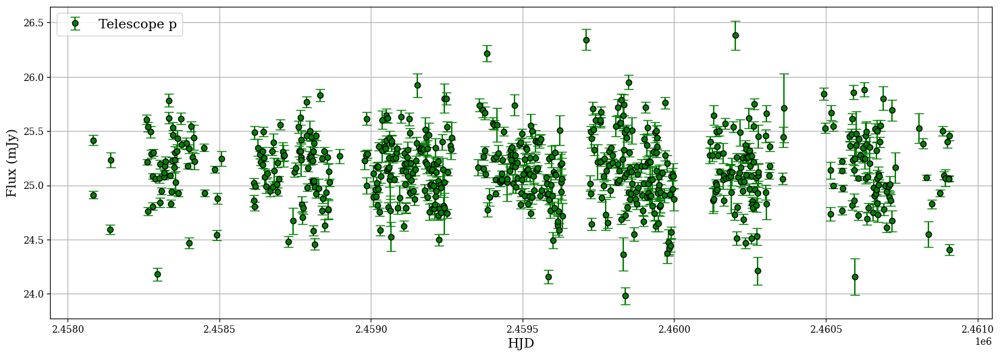

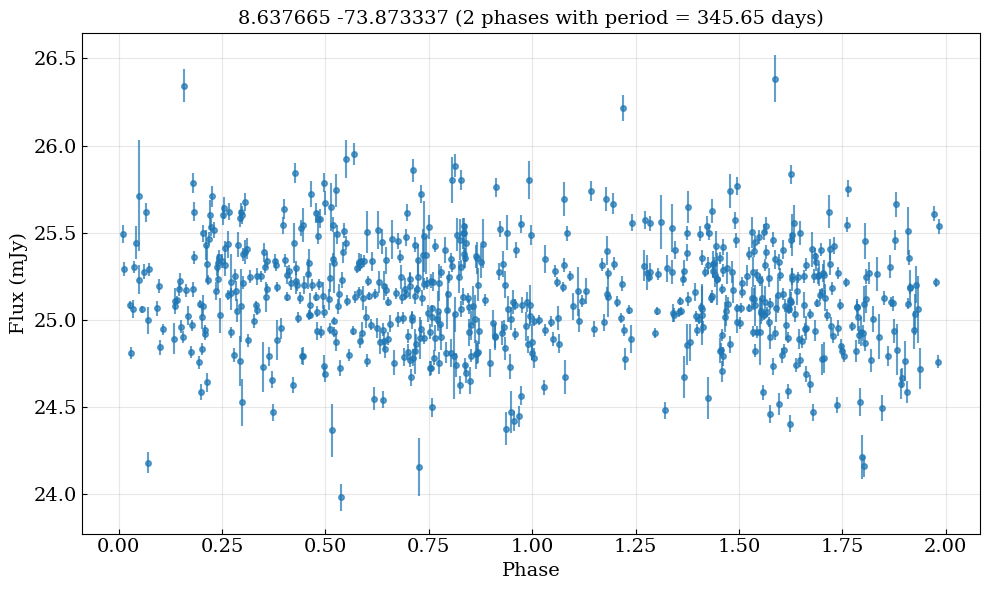

Average scatter (amplitude) per 10 point phase bin: 0.920 mJy
target 96
main type: YellowSG
offset flag: 0
alarm level flag: 0
logT and logL: 3.604752553224549, 4.690516826834151
telescope k 56 0.12121212121212122
telescope l 56 0.11740041928721175
telescope p 103 0.1609375
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 12.90685, DEC: -72.433243


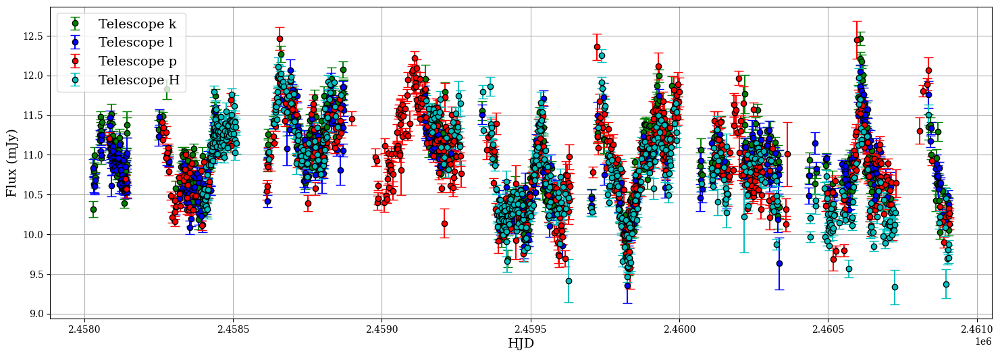

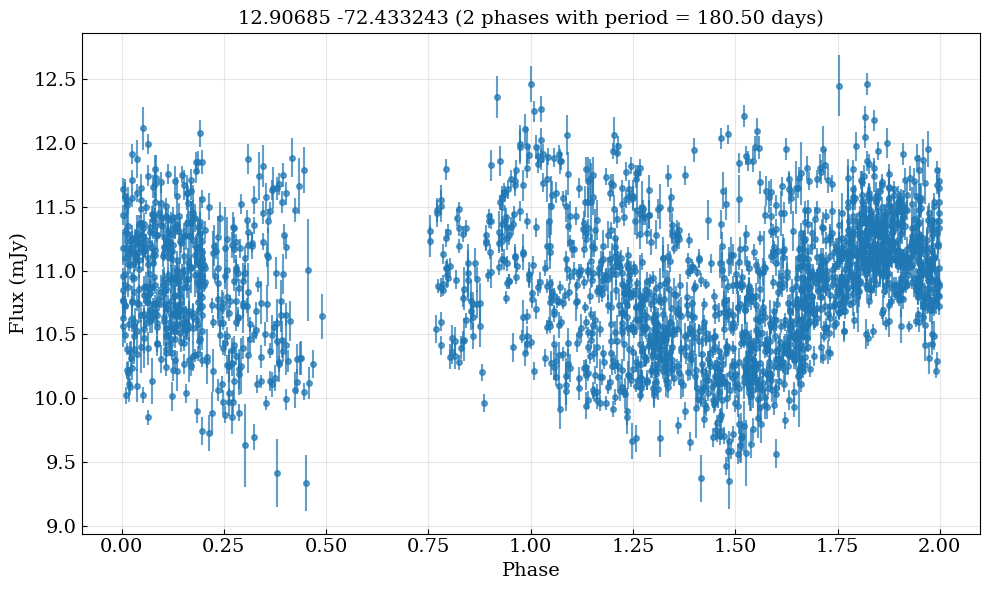

Average scatter (amplitude) per 10 point phase bin: 1.402 mJy
target 105
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.6634484144978976, 4.409909306674881
telescope k 56 0.12121212121212122
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 13.048194, DEC: -73.329536


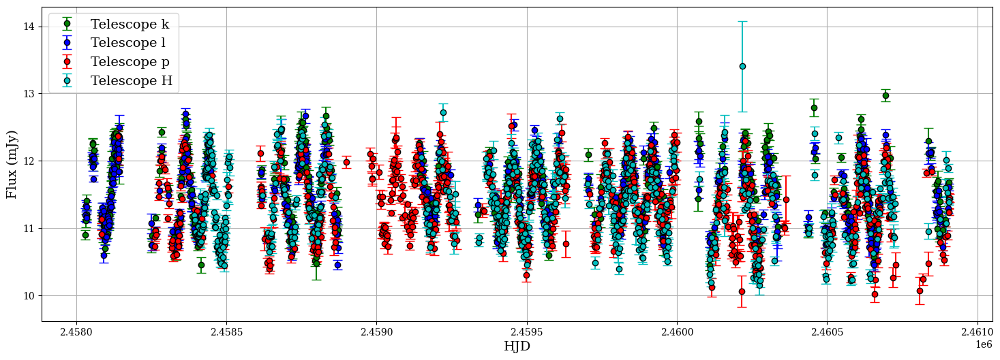

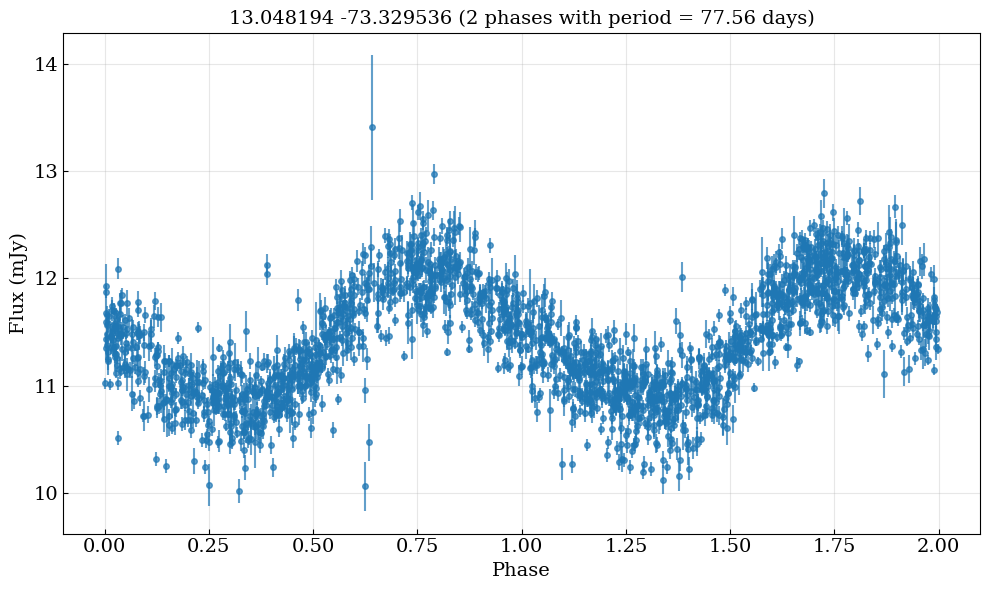

Average scatter (amplitude) per 10 point phase bin: 0.791 mJy
target 114
main type: RedSG
offset flag: 0
alarm level flag: 0
logT and logL: 3.611652804809298, 4.529406636024296
telescope l 56 0.11740041928721175
telescope k 56 0.12147505422993492
telescope p 103 0.1609375
telescope H 134 0.22039473684210525
Most data telescope in window: H
RA: 13.1457, DEC: -72.433815


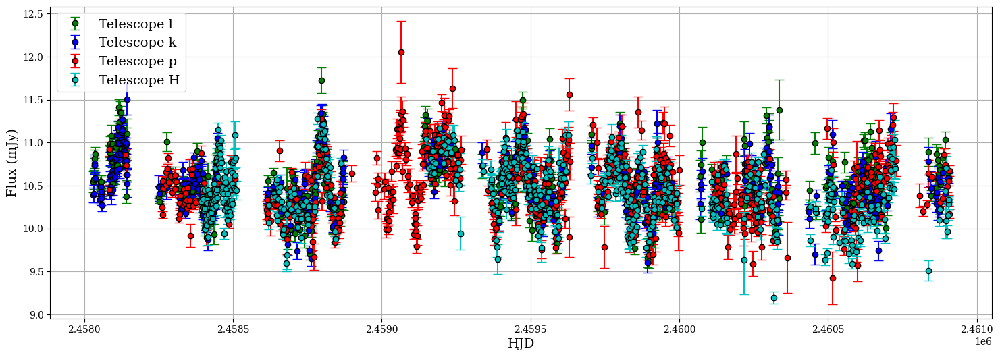

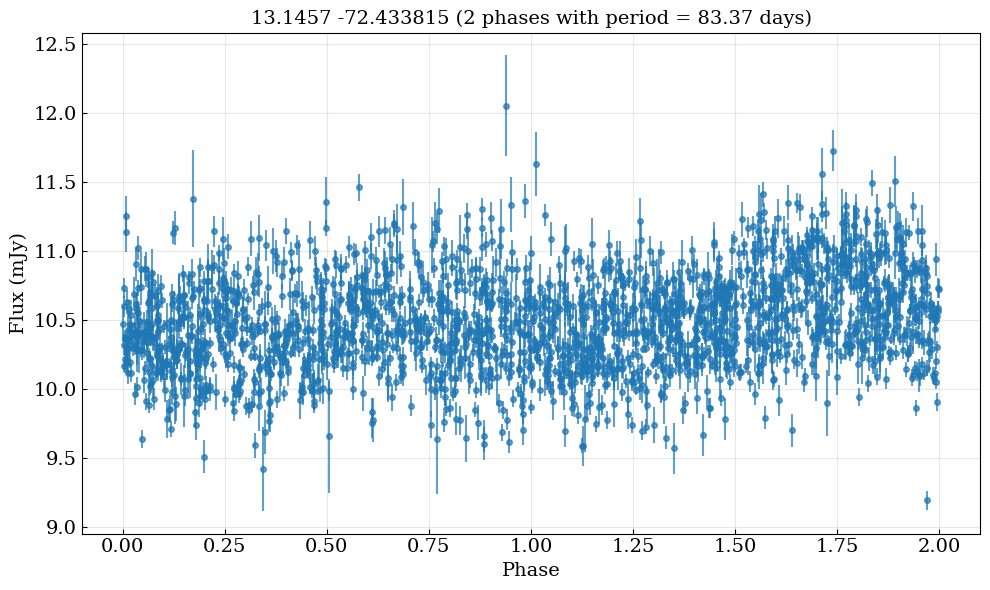

Average scatter (amplitude) per 10 point phase bin: 0.951 mJy
target 118
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.6105957663102055, 4.135870943866776
telescope k 56 0.12147505422993492
telescope l 56 0.11764705882352941
telescope p 102 0.16012558869701726
telescope H 135 0.22240527182866557
Most data telescope in window: H
RA: 13.1687, DEC: -72.745171


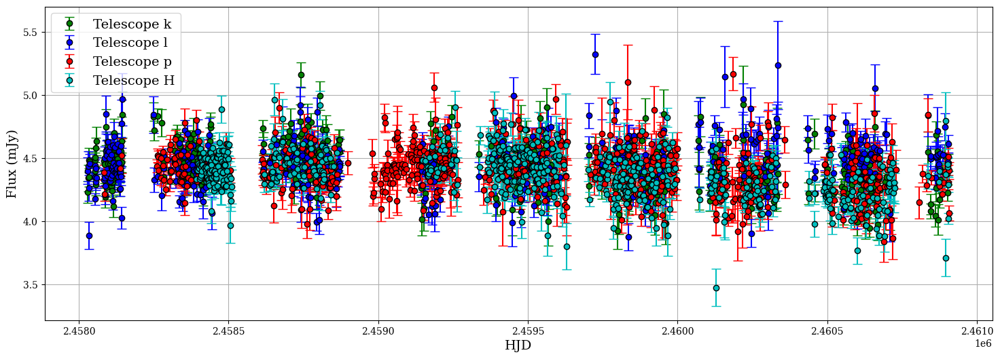

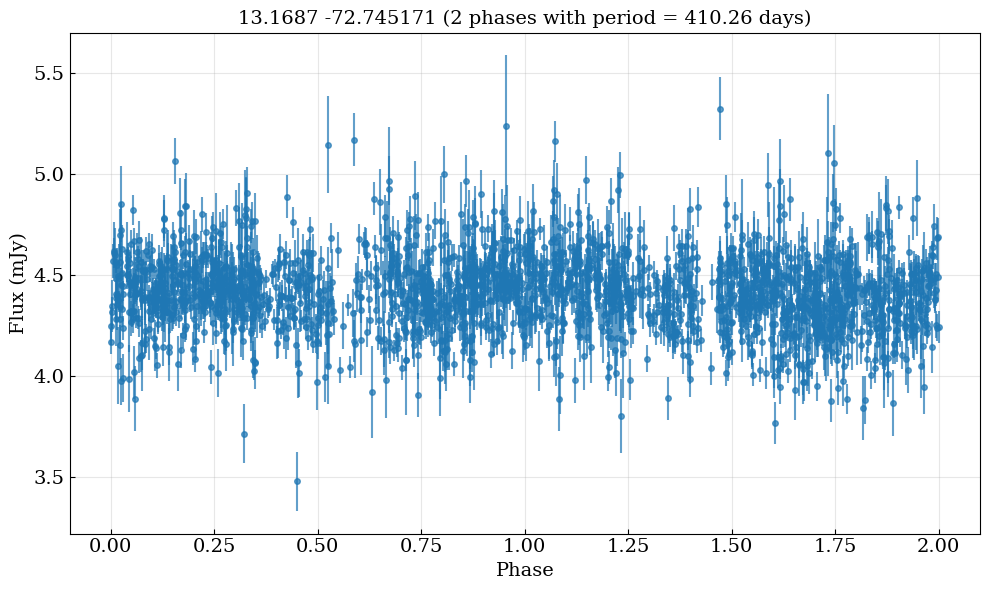

Average scatter (amplitude) per 10 point phase bin: 0.545 mJy
target 129
main type: YellowSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.617888734270881, 4.351310276301404
telescope k 56 0.12121212121212122
telescope l 56 0.11789473684210526
telescope p 103 0.1609375
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 13.256099, DEC: -72.399757


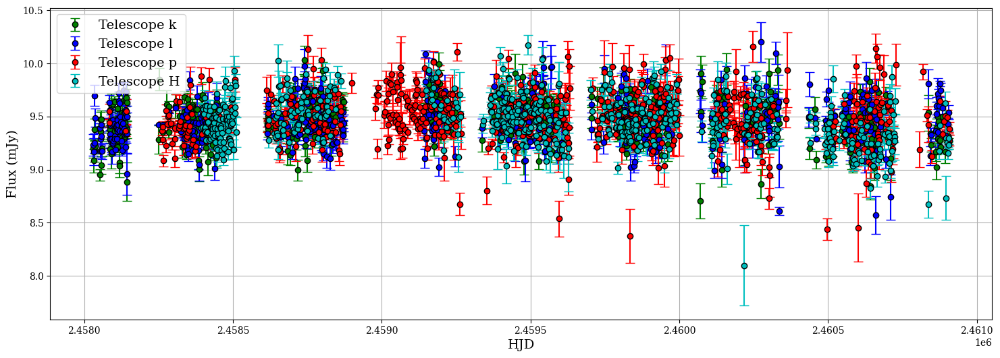

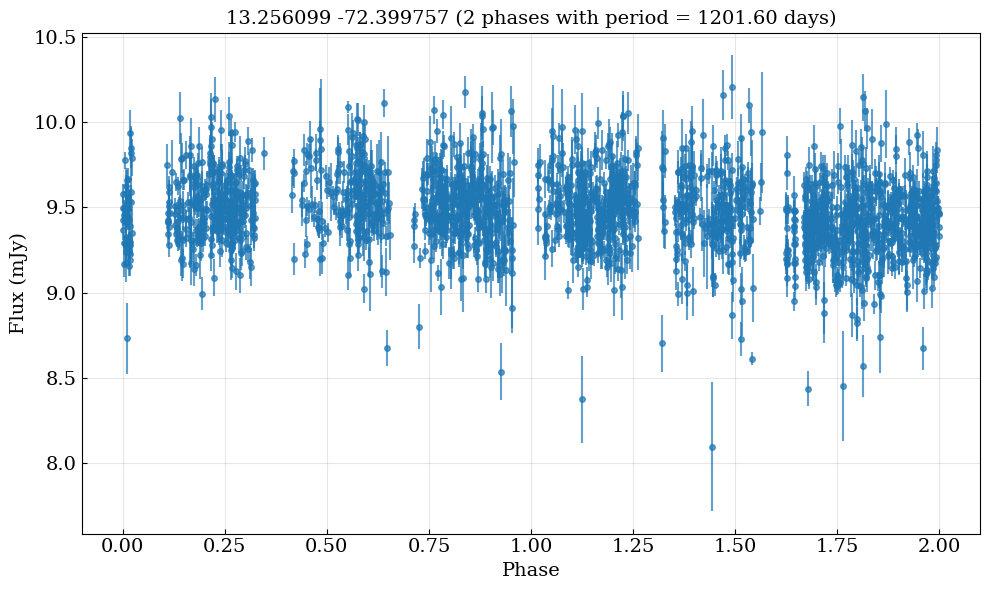

Average scatter (amplitude) per 10 point phase bin: 0.656 mJy
target 133
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.604996569477069, 4.012438473079172
telescope k 56 0.12121212121212122
telescope l 55 0.11956521739130435
telescope p 103 0.16118935837245696
telescope H 132 0.2185430463576159
Most data telescope in window: H
RA: 13.279305, DEC: -72.171394


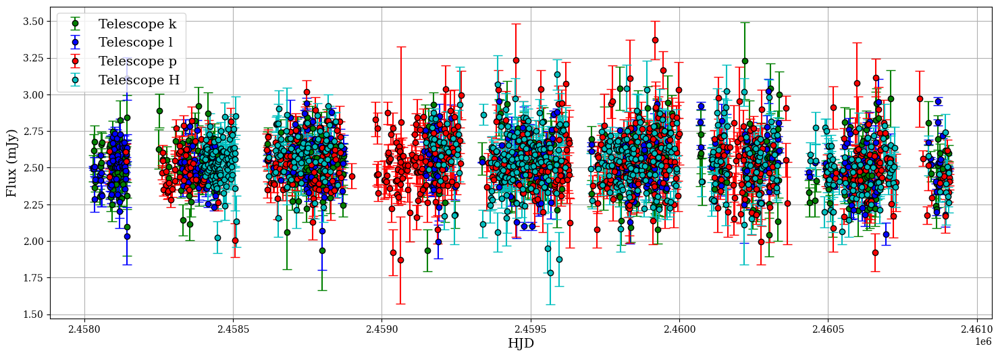

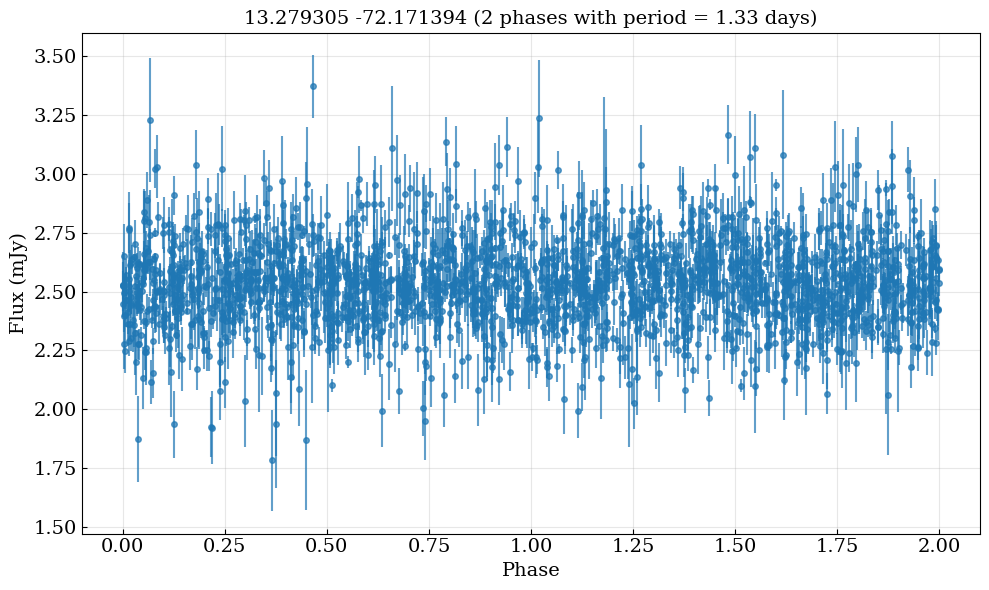

Average scatter (amplitude) per 10 point phase bin: 0.541 mJy
target 143
main type: LongPeriodV*
offset flag: 0
alarm level flag: 0
logT and logL: 3.7929873773482505, 4.157086327454488
telescope l 56 0.11764705882352941
telescope k 56 0.12121212121212122
telescope p 102 0.16037735849056603
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 13.350006, DEC: -73.11042


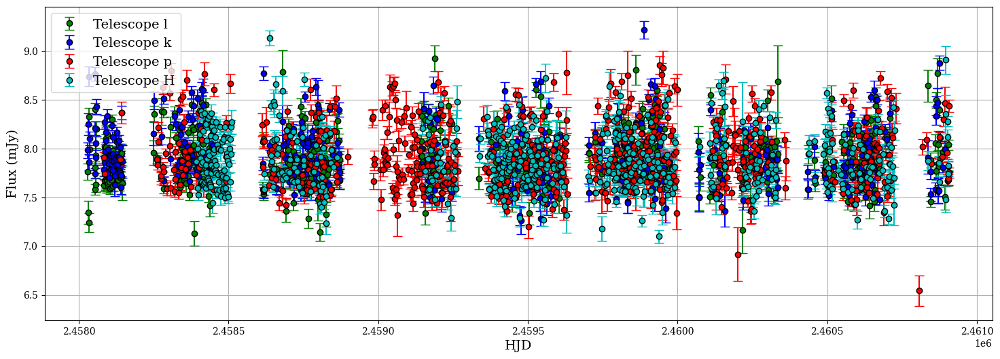

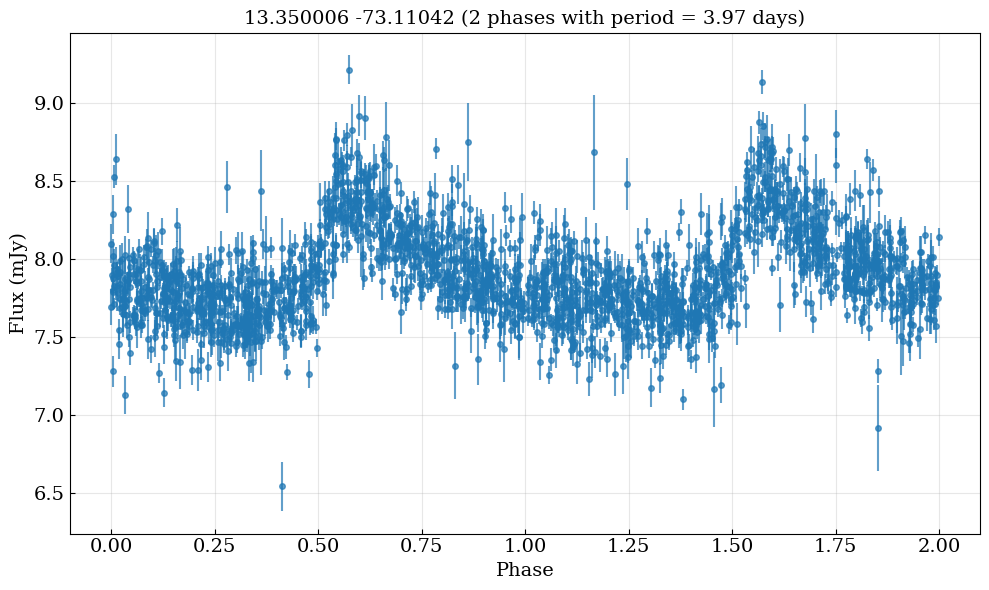

Average scatter (amplitude) per 10 point phase bin: 0.603 mJy
target 153
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.630799581142971, 4.024147790555068
telescope k 56 0.12121212121212122
telescope l 56 0.11764705882352941
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 13.42474, DEC: -72.908089


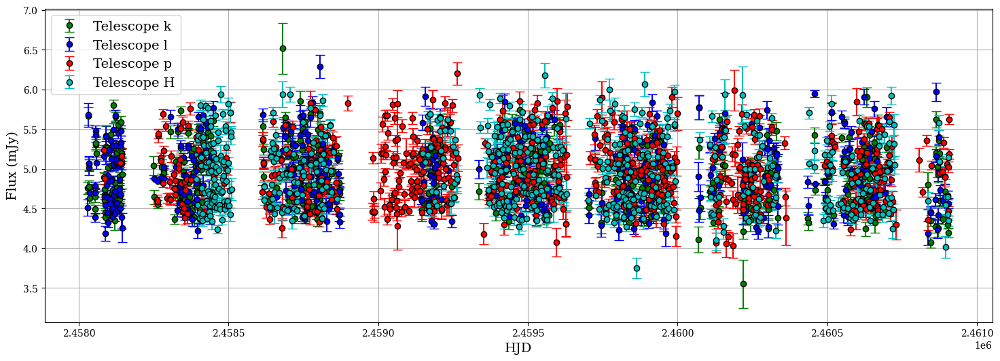

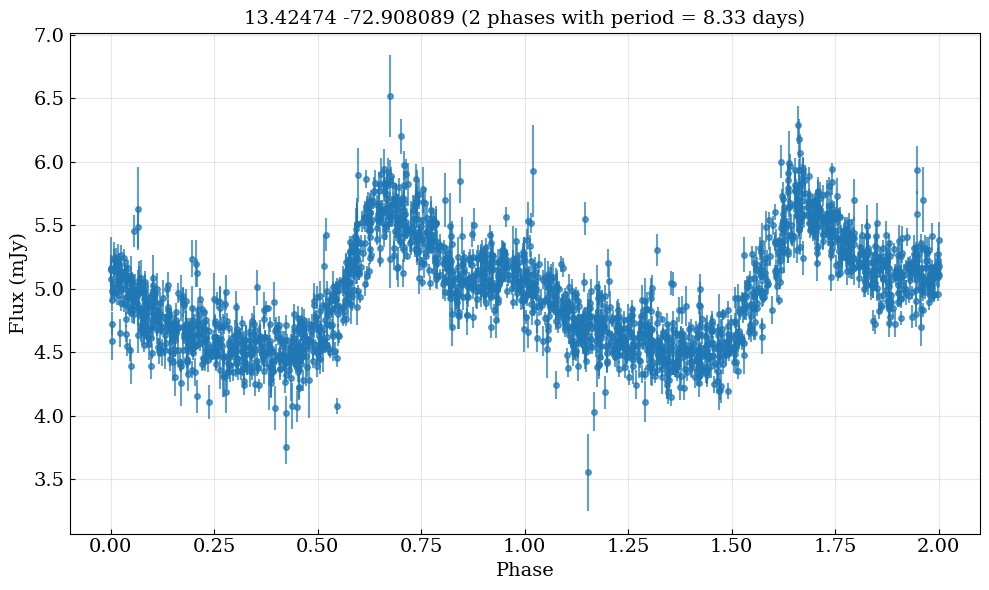

Average scatter (amplitude) per 10 point phase bin: 0.535 mJy
target 156
main type: RedSG
offset flag: 0
alarm level flag: 0
logT and logL: 3.6226162954782497, 4.722848177942705
telescope l 56 0.11814345991561181
telescope k 56 0.12121212121212122
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 13.440647, DEC: -72.894165


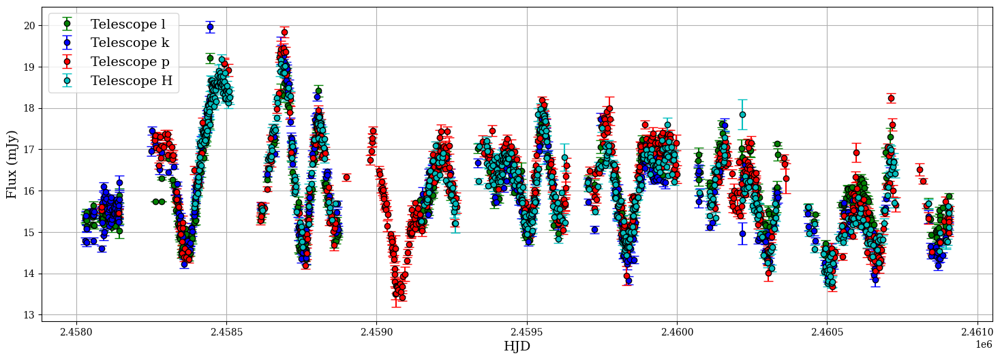

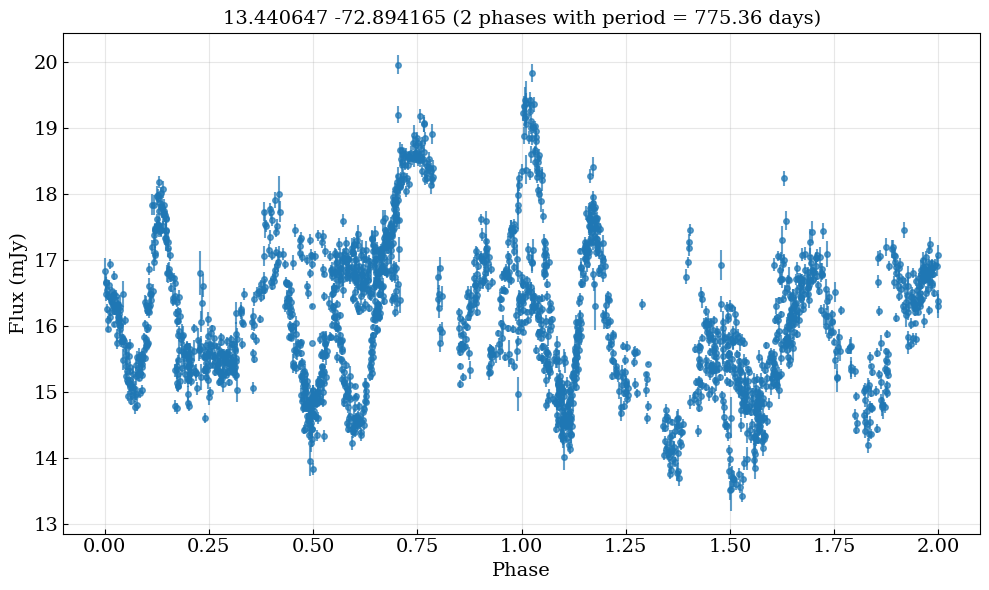

Average scatter (amplitude) per 10 point phase bin: 1.288 mJy
target 160
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.609289202294641, 4.0023884558386165
telescope k 56 0.12200435729847495
telescope p 103 0.1627172195892575
telescope H 134 0.22148760330578512
Most data telescope in window: H
RA: 13.477901, DEC: -72.437256


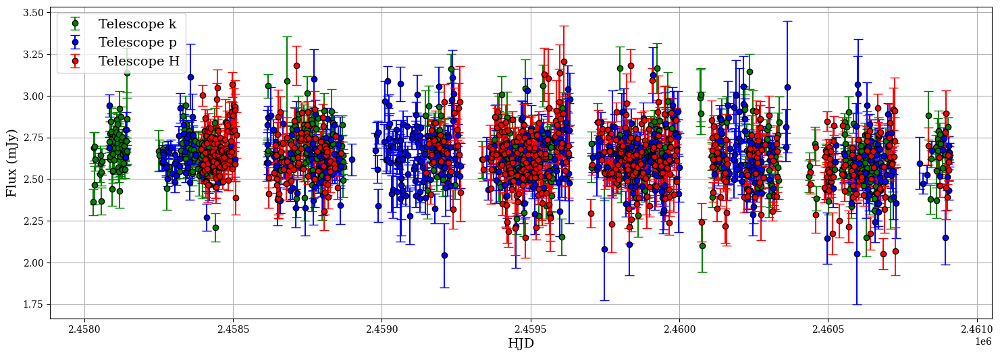

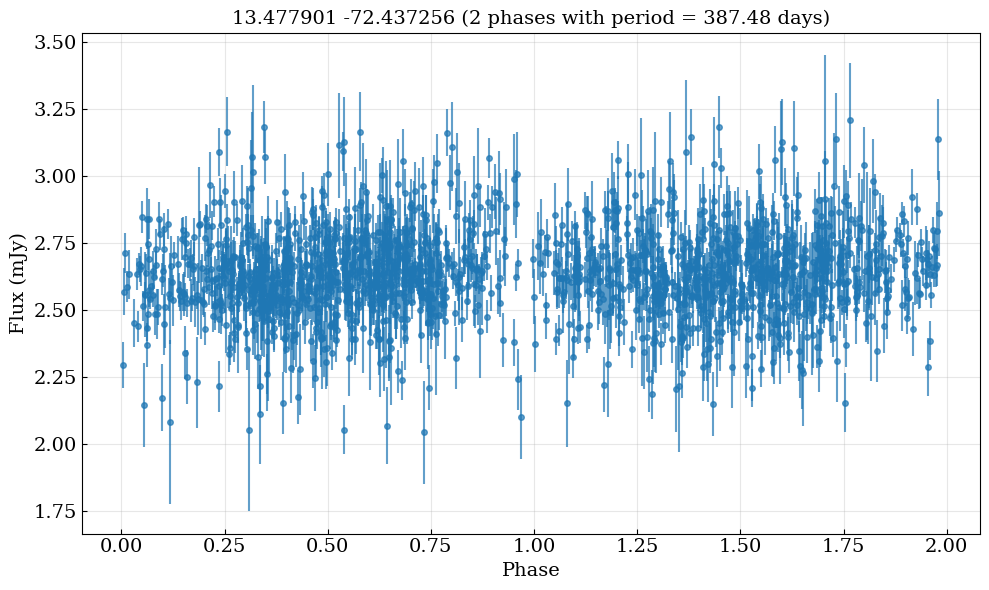

Average scatter (amplitude) per 10 point phase bin: 0.483 mJy
target 172
main type: YellowSG
offset flag: 0
alarm level flag: 0
logT and logL: 3.6148771424392656, 4.751321444939647
telescope l 52 0.12682926829268293
telescope k 56 0.12307692307692308
telescope o 101 0.16777408637873753
telescope p 103 0.16118935837245696
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 13.611973, DEC: -72.883247


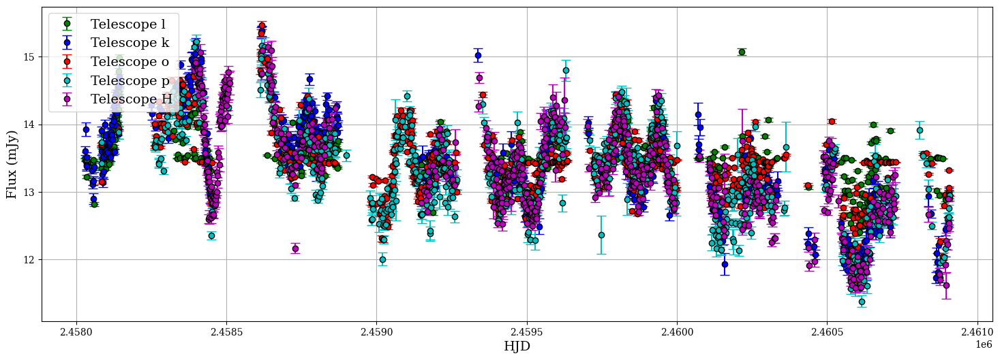

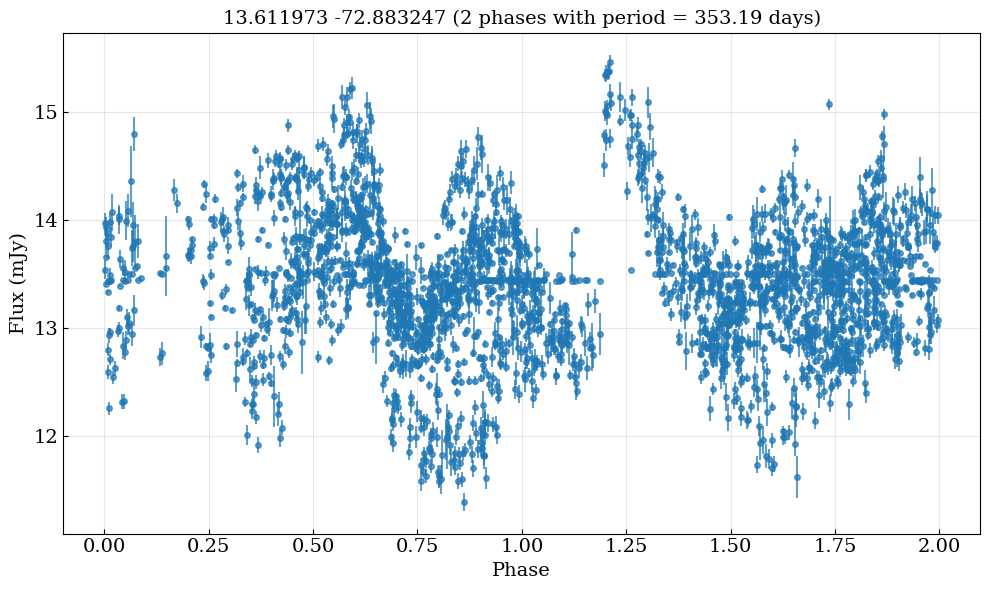

Average scatter (amplitude) per 10 point phase bin: 1.365 mJy
target 174
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 1
logT and logL: 3.607745585119329, 4.409397767559655
telescope k 56 0.12121212121212122
telescope o 105 0.16355140186915887
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
Most data telescope in window: H
RA: 13.627097, DEC: -72.570183


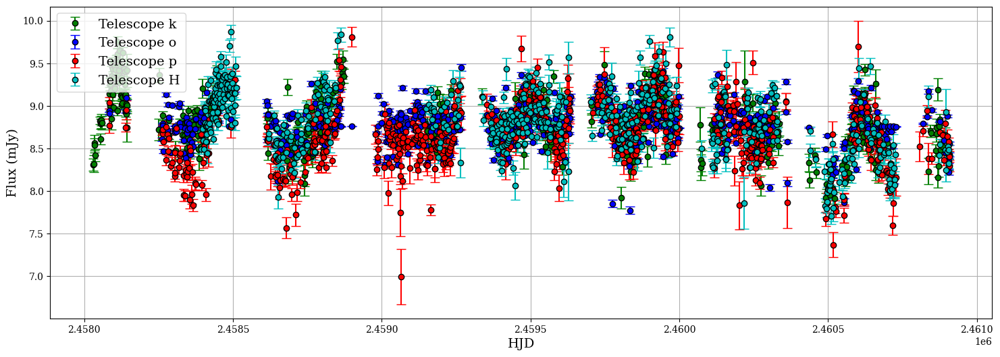

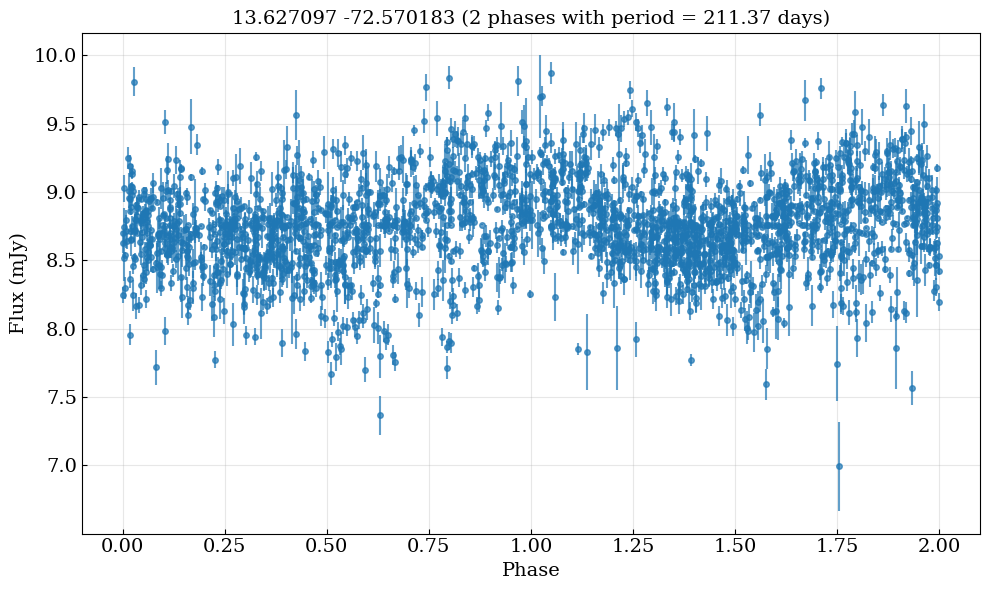

Average scatter (amplitude) per 10 point phase bin: 0.946 mJy
target 182
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.7159697800108633, 4.0966044338160055
telescope k 56 0.12121212121212122
telescope l 55 0.12168141592920353
telescope o 108 0.1641337386018237
telescope p 103 0.1606864274570983
telescope H 135 0.22203947368421054
Most data telescope in window: H
RA: 13.673452, DEC: -73.128853


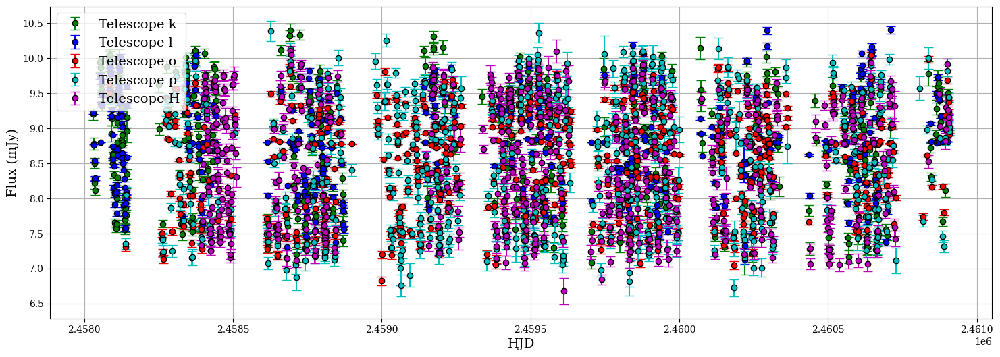

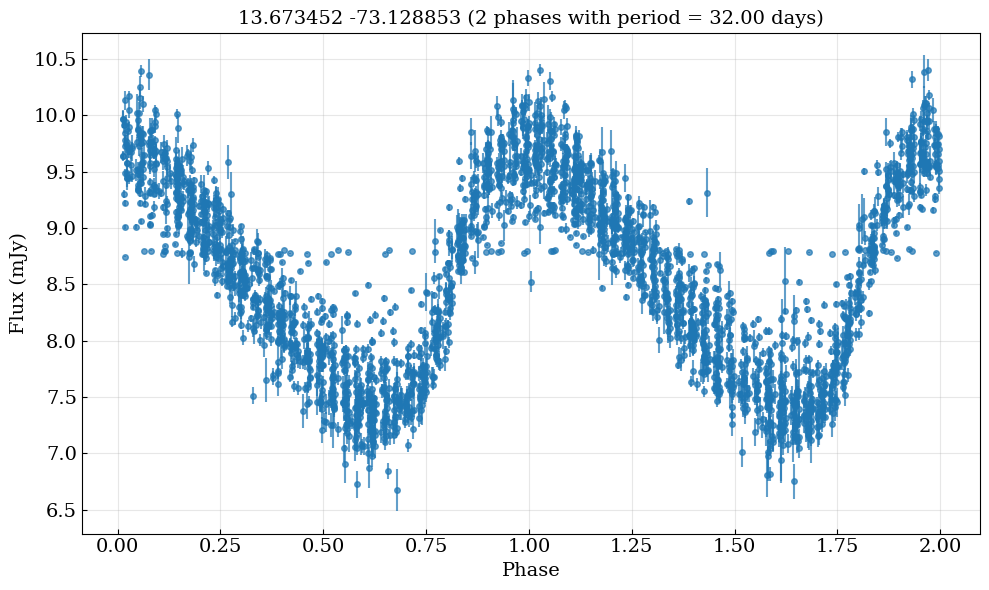

Average scatter (amplitude) per 10 point phase bin: 0.851 mJy
target 188
main type: YellowSG
offset flag: 0
alarm level flag: 0
logT and logL: 3.656365237907991, 4.540862360653636
telescope k 56 0.12121212121212122
telescope l 52 0.12839506172839507
telescope o 108 0.16314199395770393
telescope p 103 0.1606864274570983
telescope H 135 0.22203947368421054
Most data telescope in window: H
RA: 13.726891, DEC: -73.15094


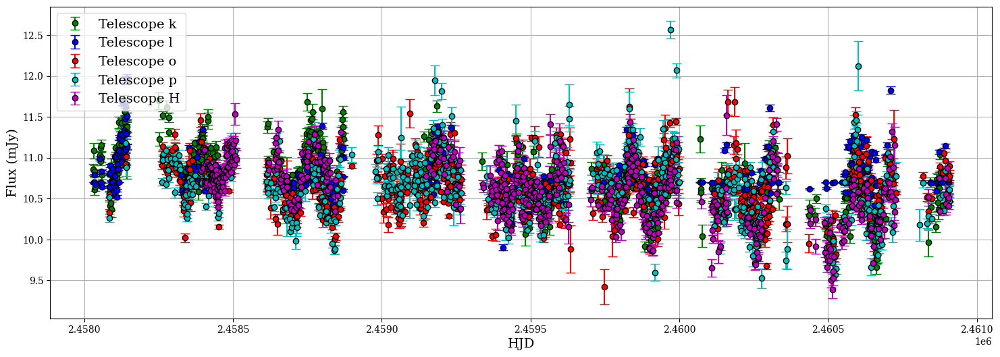

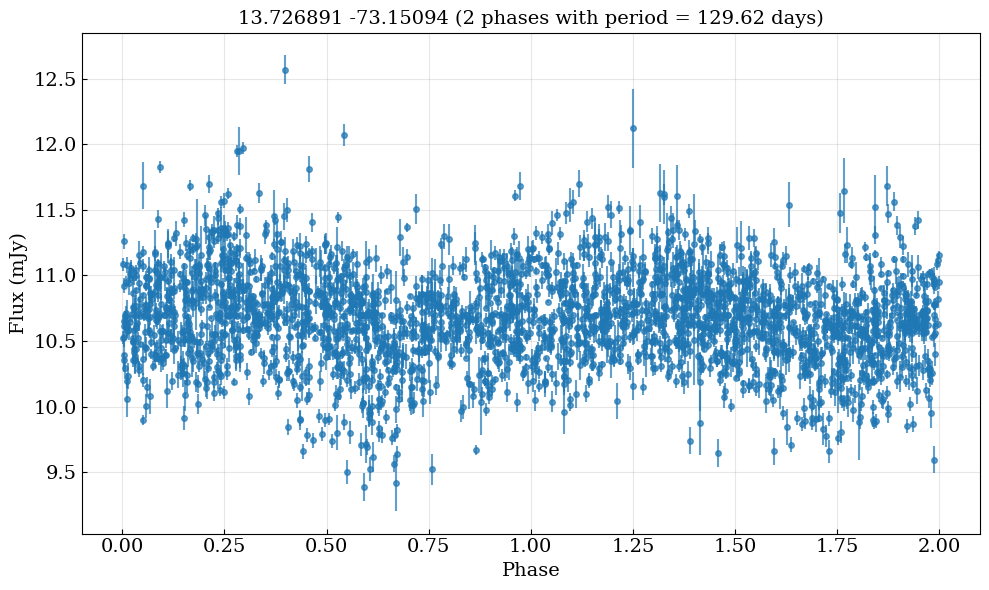

Average scatter (amplitude) per 10 point phase bin: 0.997 mJy
target 210
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.661665313799341, 4.140059353813025
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 103 0.1606864274570983
telescope H 135 0.22203947368421054
telescope G 127 0.20888157894736842
Most data telescope in window: H
RA: 14.004046, DEC: -72.460983


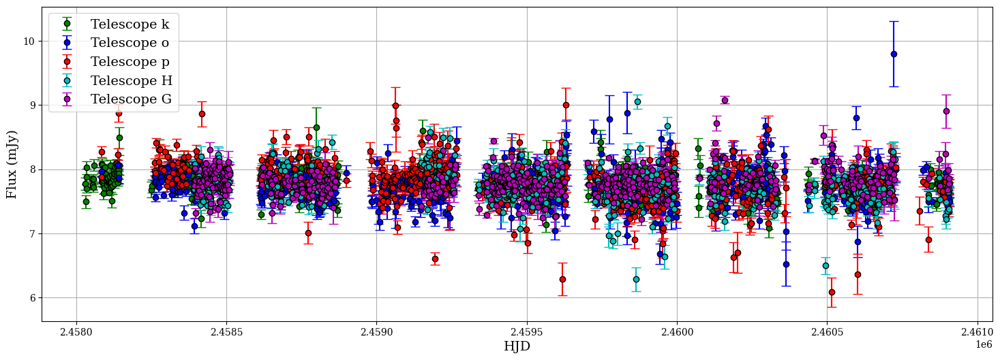

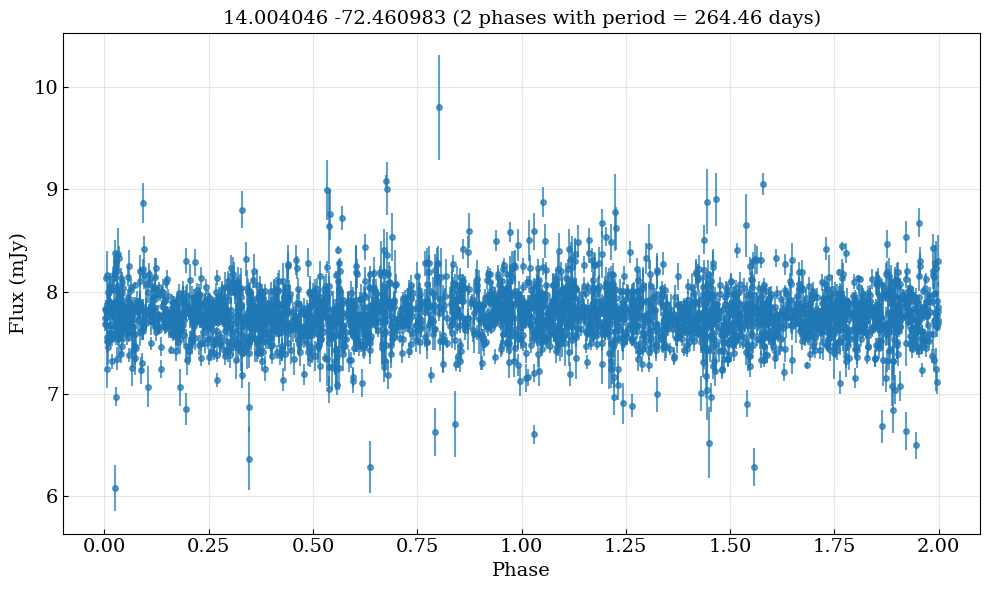

Average scatter (amplitude) per 10 point phase bin: 0.749 mJy
target 214
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.606482004994043, 4.162442381310022
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 103 0.1614420062695925
telescope H 135 0.22203947368421054
telescope G 127 0.2081967213114754
Most data telescope in window: H
RA: 14.037303, DEC: -72.277908


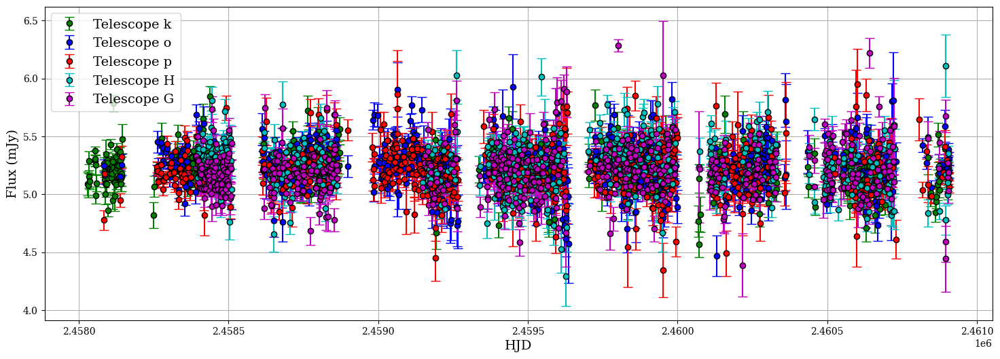

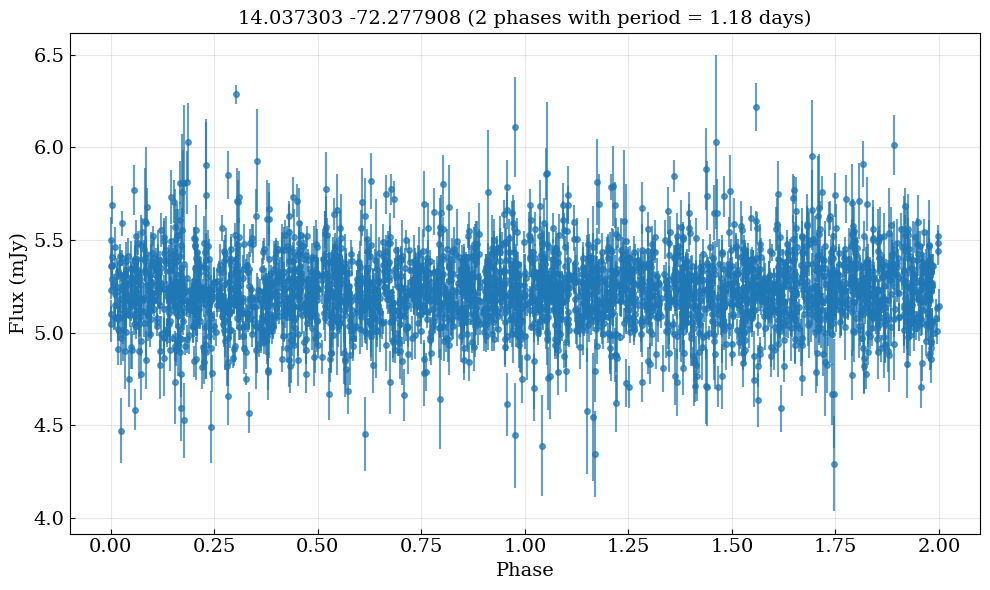

Average scatter (amplitude) per 10 point phase bin: 0.579 mJy
target 217
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.6105957663102055, 4.025070943866776
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 103 0.1609375
telescope H 135 0.22203947368421054
telescope G 126 0.20689655172413793
Most data telescope in window: H
RA: 14.061519, DEC: -72.42244


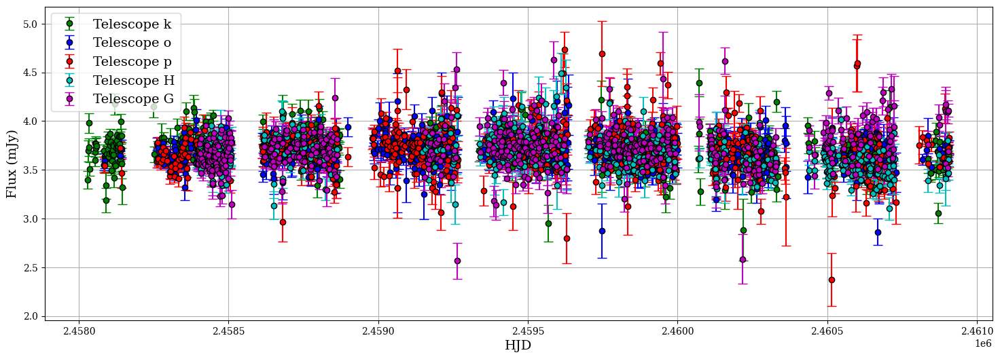

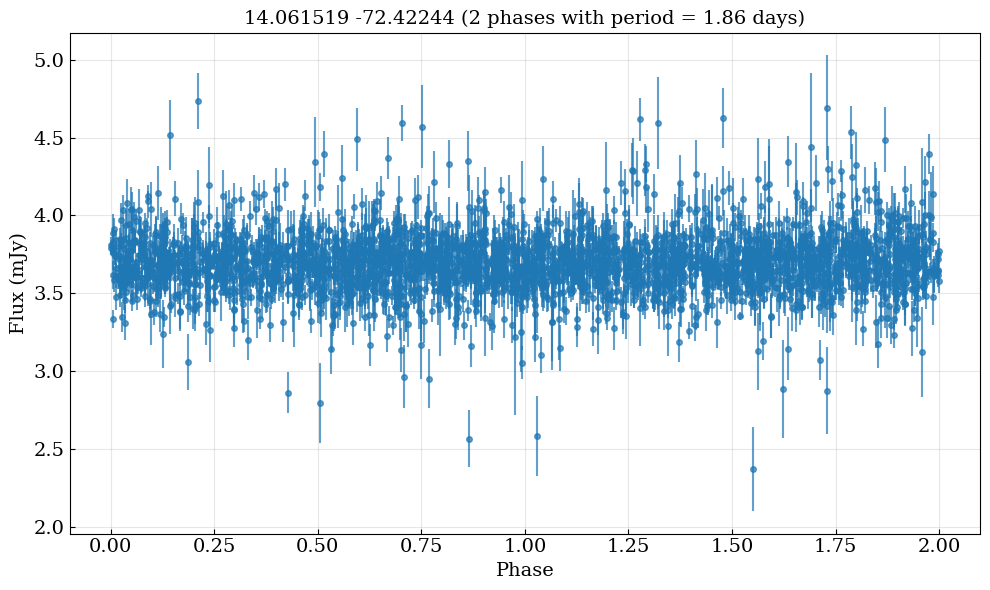

Average scatter (amplitude) per 10 point phase bin: 0.565 mJy
target 225
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.624018930509914, 4.025993905988754
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 103 0.1609375
telescope H 135 0.22240527182866557
telescope G 127 0.2081967213114754
Most data telescope in window: H
RA: 14.127534, DEC: -72.231476


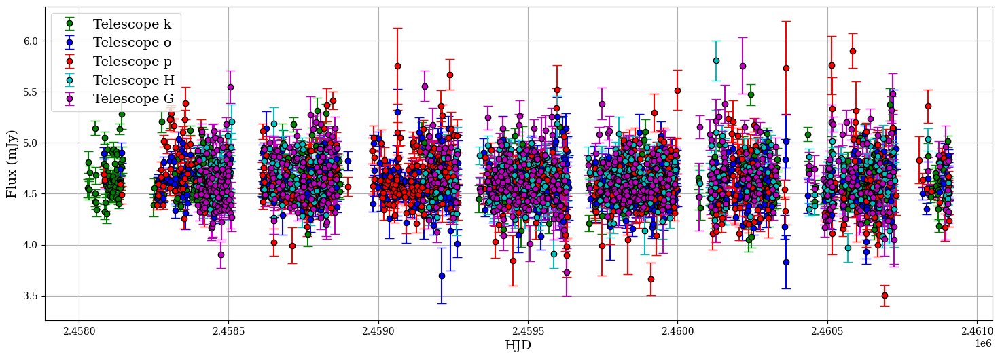

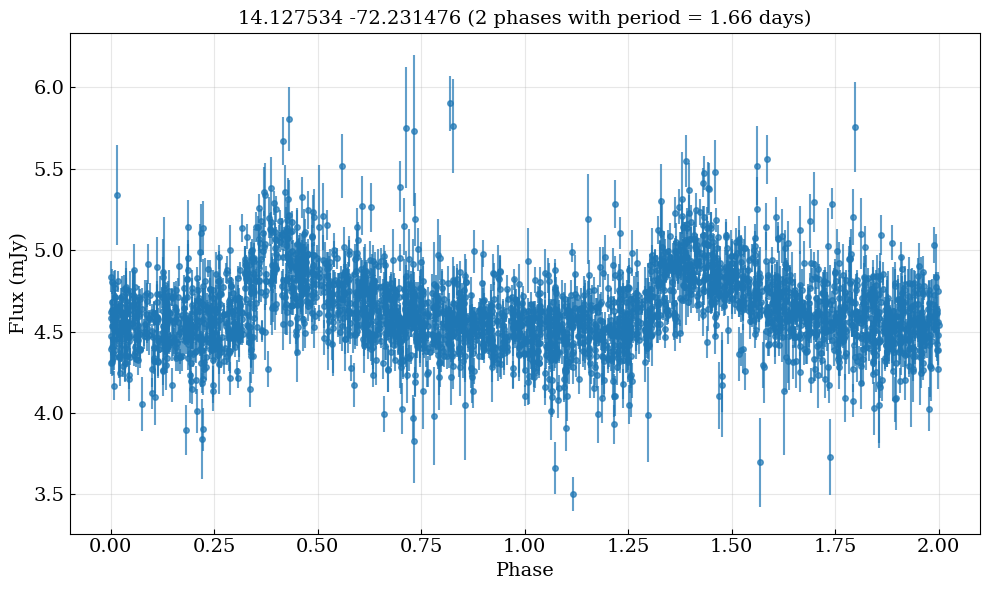

Average scatter (amplitude) per 10 point phase bin: 0.574 mJy
target 241
main type: EmLine*
offset flag: 0
alarm level flag: 0
logT and logL: 3.8260120925073937, 4.078238259389327
telescope i 74 0.15546218487394958
telescope j 75 0.16741071428571427
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 103 0.1609375
telescope m 14 0.050724637681159424
telescope E 83 0.1873589164785553
telescope H 135 0.22240527182866557
telescope G 127 0.20751633986928106
Most data telescope in window: H
RA: 14.347047, DEC: -72.02668


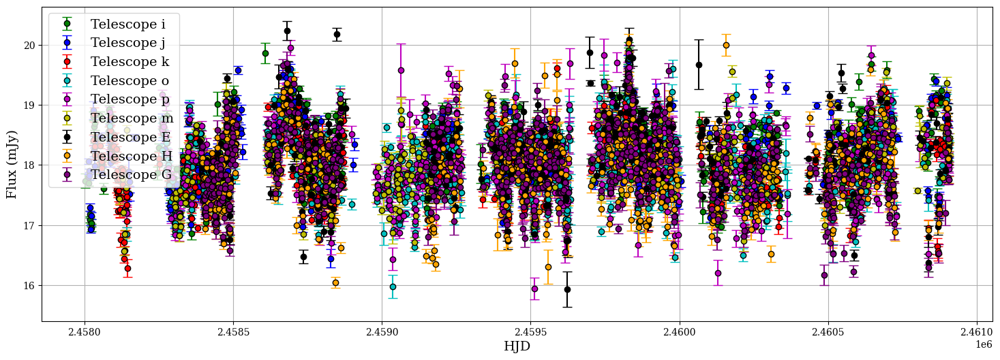

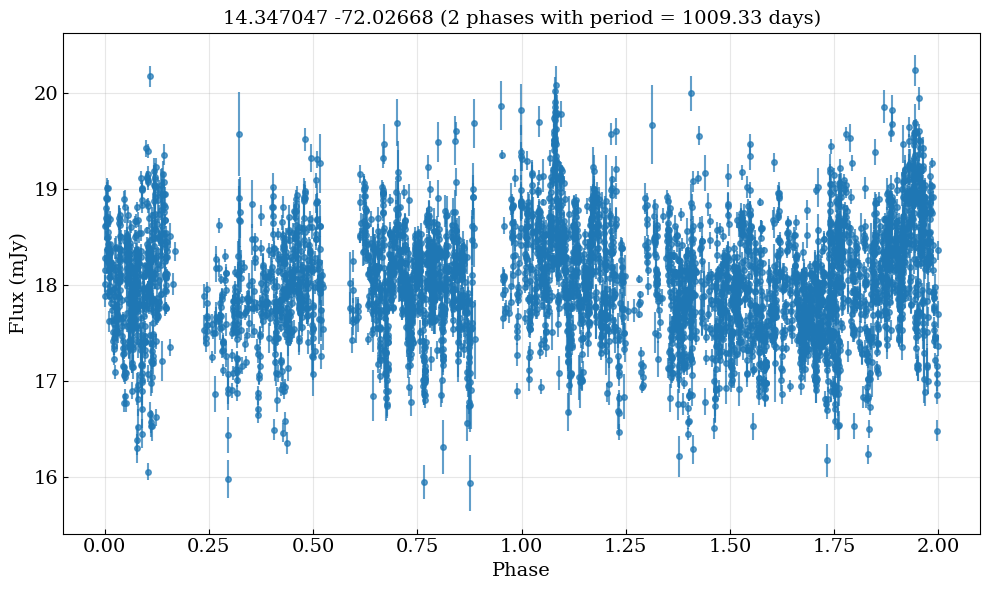

Average scatter (amplitude) per 10 point phase bin: 1.191 mJy
target 248
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.608513883384824, 4.11288274465806
telescope j 75 0.1681614349775785
telescope k 56 0.12147505422993492
telescope o 105 0.16055045871559634
telescope p 101 0.15930599369085174
telescope m 14 0.053231939163498096
telescope E 77 0.19642857142857142
telescope H 135 0.22203947368421054
telescope G 127 0.2078559738134206
Most data telescope in window: H
RA: 14.472561, DEC: -72.083511


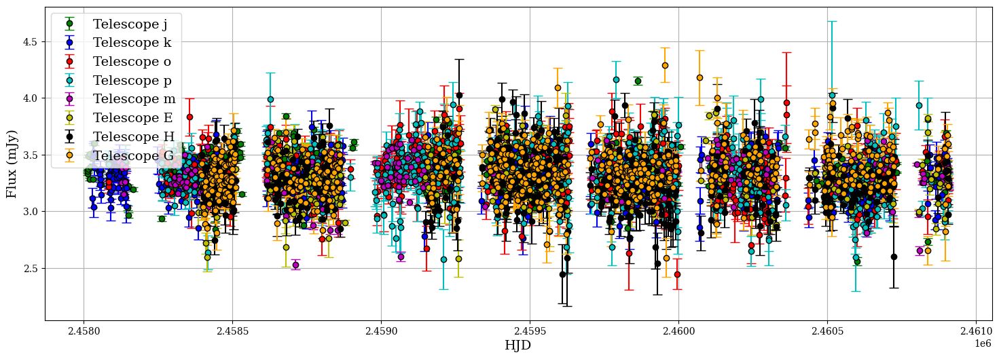

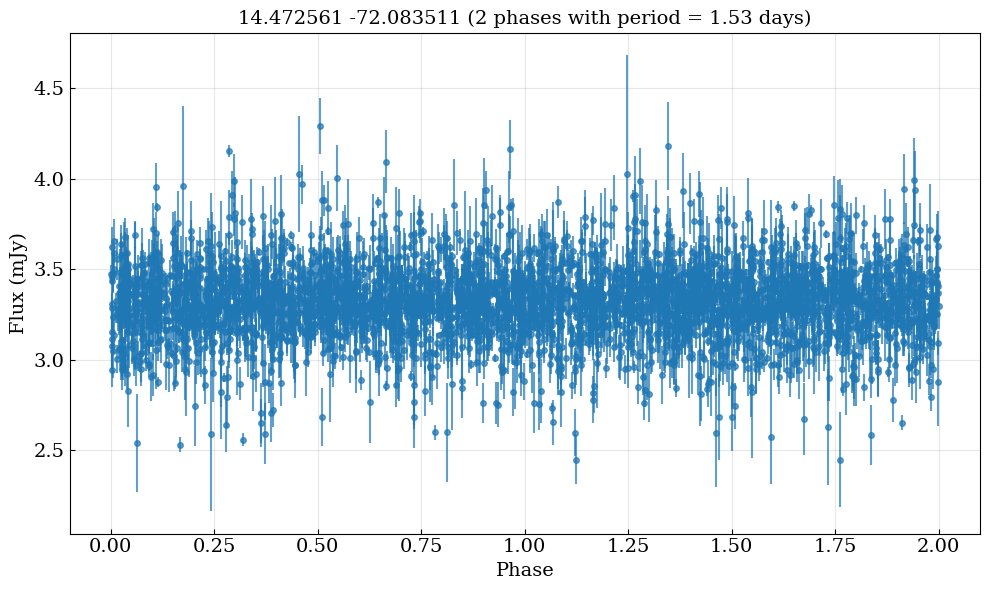

Average scatter (amplitude) per 10 point phase bin: 0.581 mJy
target 250
main type: YellowSG
offset flag: 0
alarm level flag: 0
logT and logL: 3.656657929931996, 4.718310038867891
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 103 0.1606864274570983
telescope H 135 0.22203947368421054
telescope G 127 0.20751633986928106
Most data telescope in window: H
RA: 14.487046, DEC: -73.562134


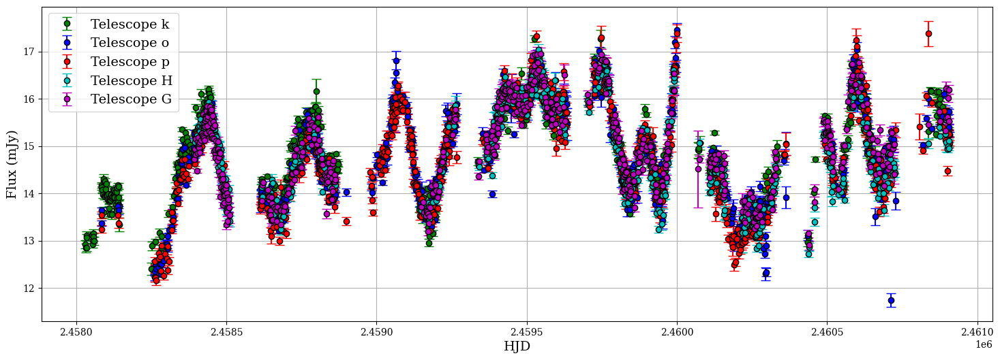

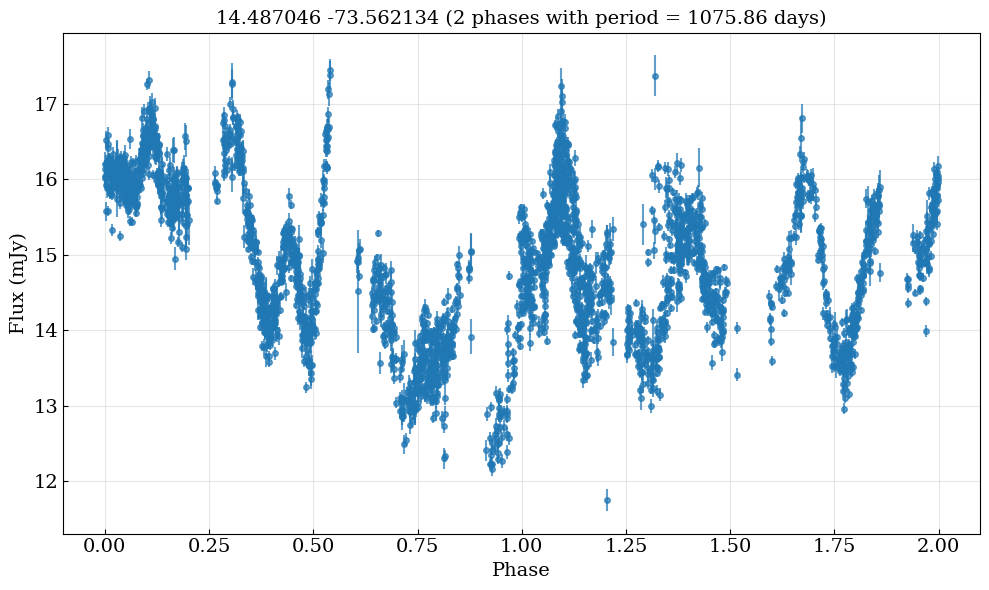

Average scatter (amplitude) per 10 point phase bin: 0.945 mJy
target 259
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.707664505144991, 4.12727020638415
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 103 0.1606864274570983
telescope H 135 0.22203947368421054
telescope G 127 0.20751633986928106
Most data telescope in window: H
RA: 14.729435, DEC: -72.552078


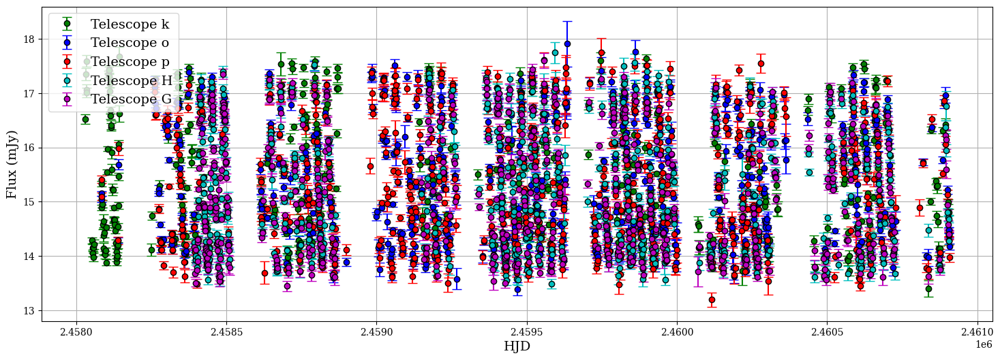

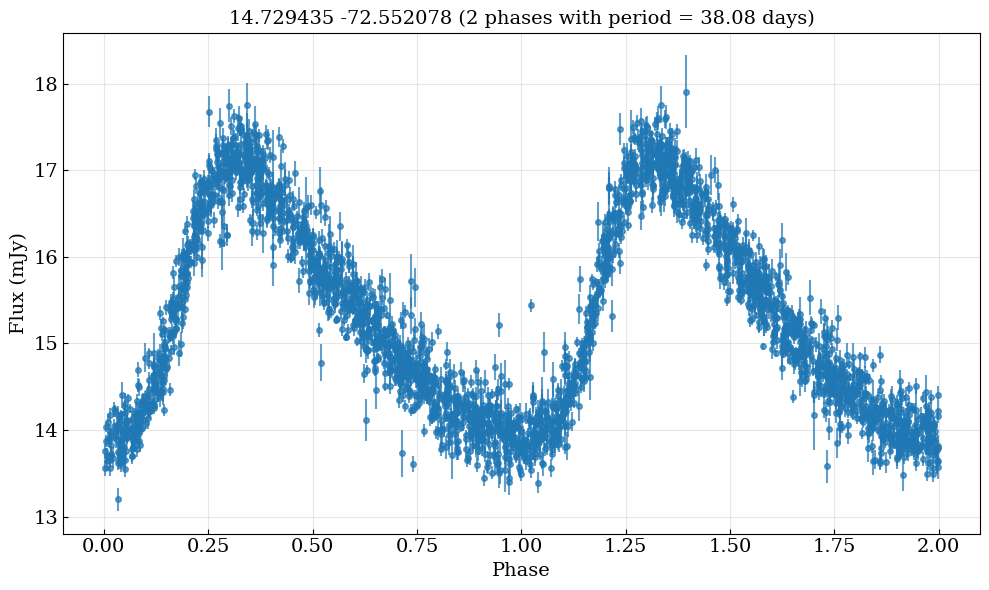

Average scatter (amplitude) per 10 point phase bin: 0.761 mJy
target 272
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 1
logT and logL: 3.6184408712790006, 4.002108867806062
telescope k 56 0.12147505422993492
telescope o 107 0.16411042944785276
telescope H 130 0.21885521885521886
telescope G 127 0.2081967213114754
Most data telescope in window: H
RA: 15.056647, DEC: -72.352814


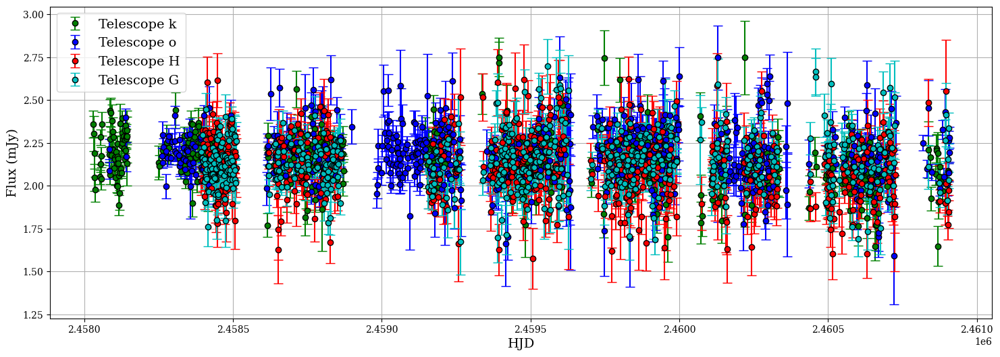

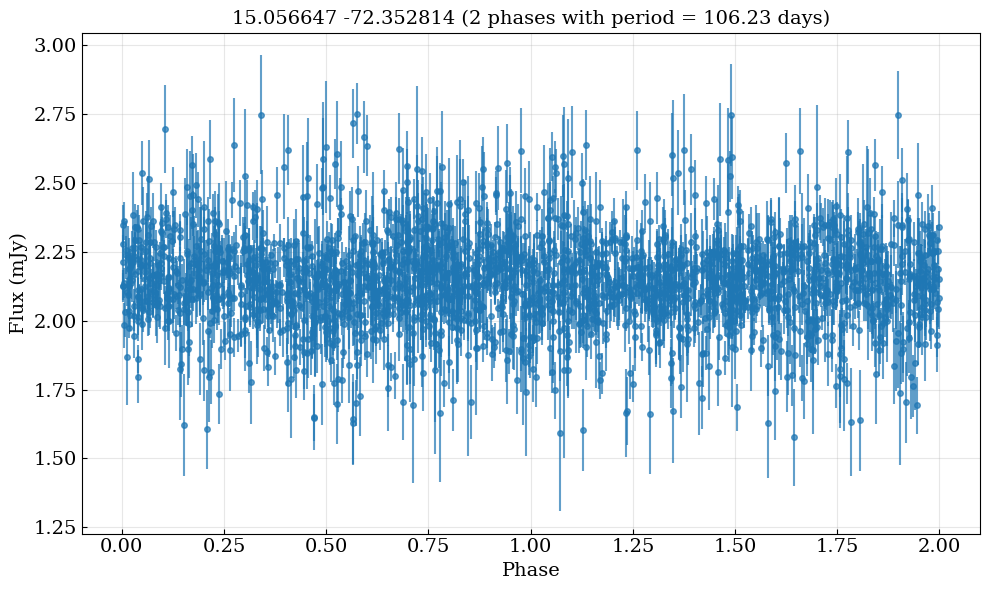

Average scatter (amplitude) per 10 point phase bin: 0.497 mJy
target 299
main type: YellowSG
offset flag: 0
alarm level flag: 0
logT and logL: 3.605487733860952, 4.701092771918669
telescope i 74 0.15416666666666667
telescope j 75 0.16741071428571427
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope n 20 0.09009009009009009
telescope m 14 0.050724637681159424
telescope E 83 0.18778280542986425
telescope F 57 0.1743119266055046
telescope G 127 0.20751633986928106
Most data telescope in window: G
RA: 15.787205, DEC: -71.930763


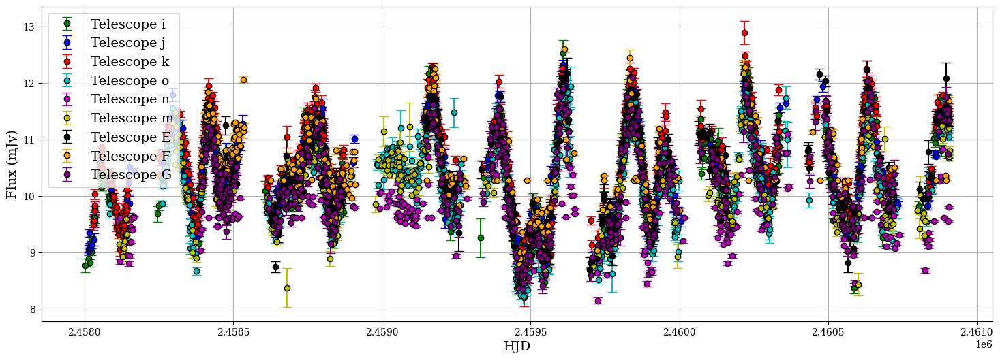

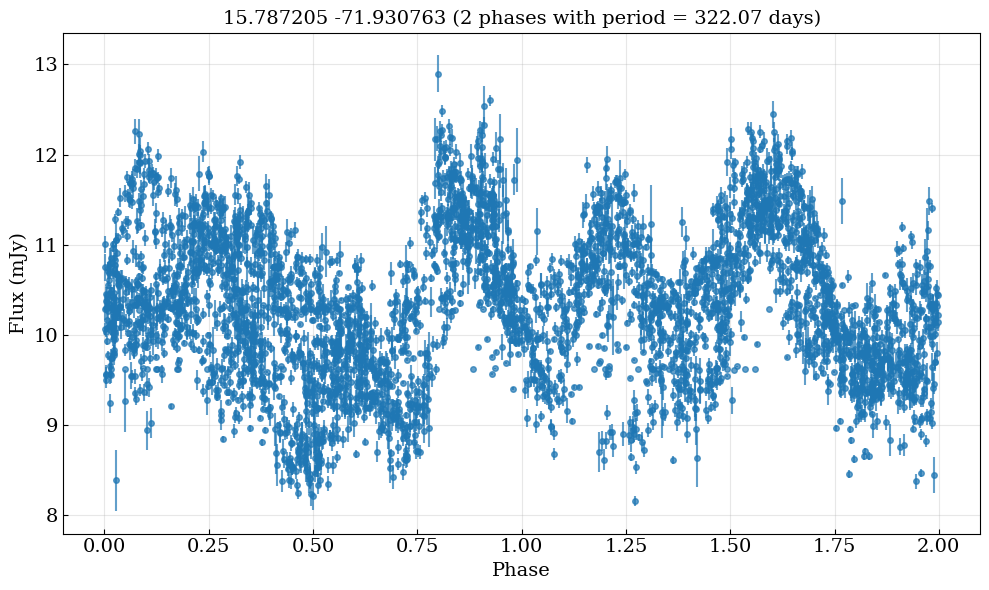

Average scatter (amplitude) per 10 point phase bin: 1.633 mJy
target 307
main type: EmLine*
offset flag: 0
alarm level flag: 0
logT and logL: 3.793981758418051, 4.330333661777989
telescope i 74 0.1544885177453027
telescope j 75 0.16778523489932887
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope n 26 0.09352517985611511
telescope m 14 0.050724637681159424
telescope E 83 0.1873589164785553
telescope F 71 0.16397228637413394
telescope G 126 0.20621931260229132
Most data telescope in window: G
RA: 15.993419, DEC: -71.90551


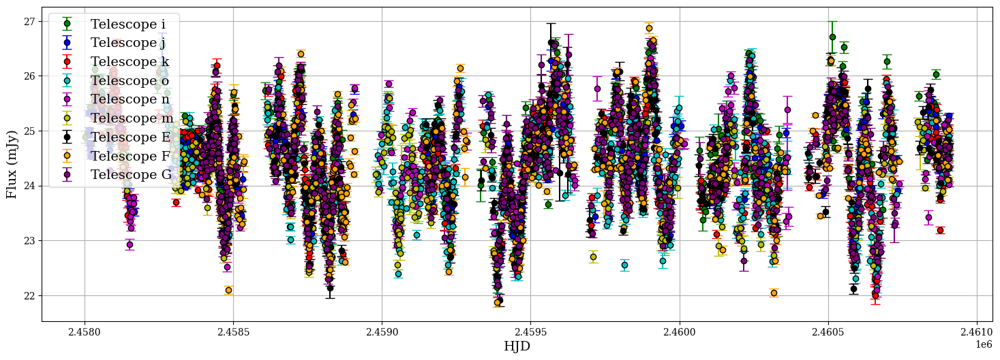

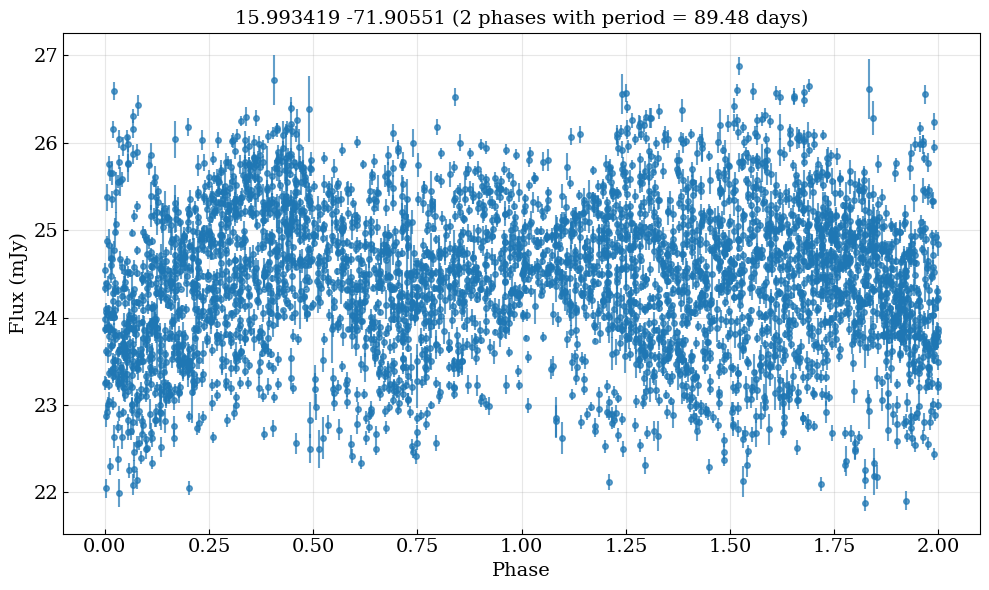

Average scatter (amplitude) per 10 point phase bin: 2.228 mJy
target 322
main type: BlueSG
offset flag: 0
alarm level flag: 0
logT and logL: 3.787745128417957, 4.065798329099198
telescope i 74 0.15416666666666667
telescope j 75 0.16741071428571427
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope n 27 0.09473684210526316
telescope m 14 0.050724637681159424
telescope E 83 0.1873589164785553
telescope F 76 0.1613588110403397
telescope G 127 0.2113144758735441
Most data telescope in window: G
RA: 16.445653, DEC: -71.772797


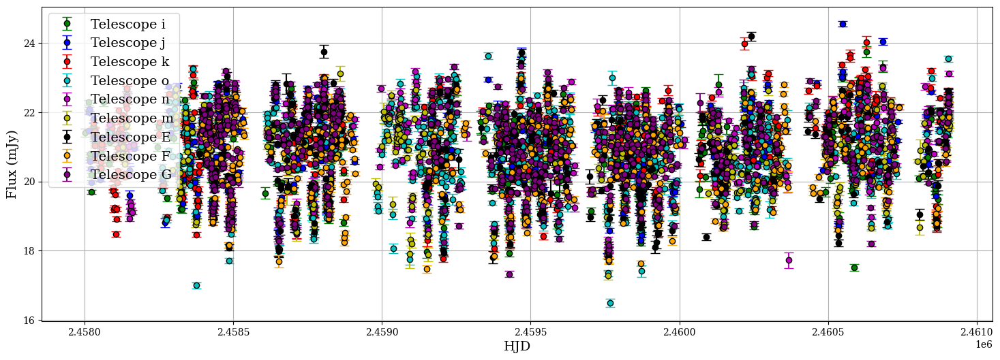

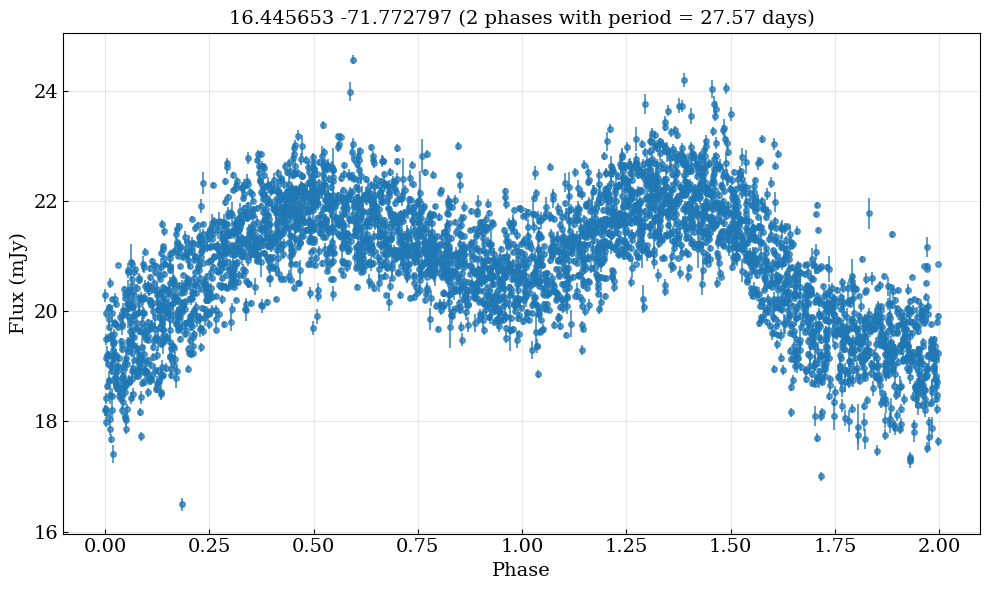

Average scatter (amplitude) per 10 point phase bin: 1.855 mJy
target 358
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.6731262208280193, 4.3253860807513815
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope G 127 0.20751633986928106
Most data telescope in window: G
RA: 18.325872, DEC: -73.363472


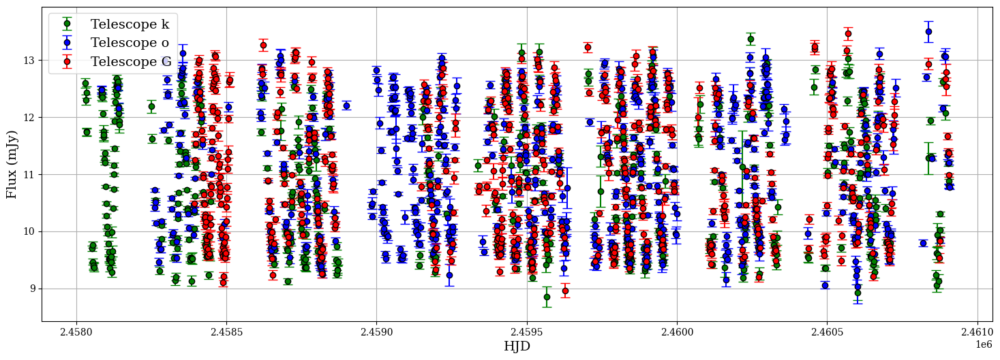

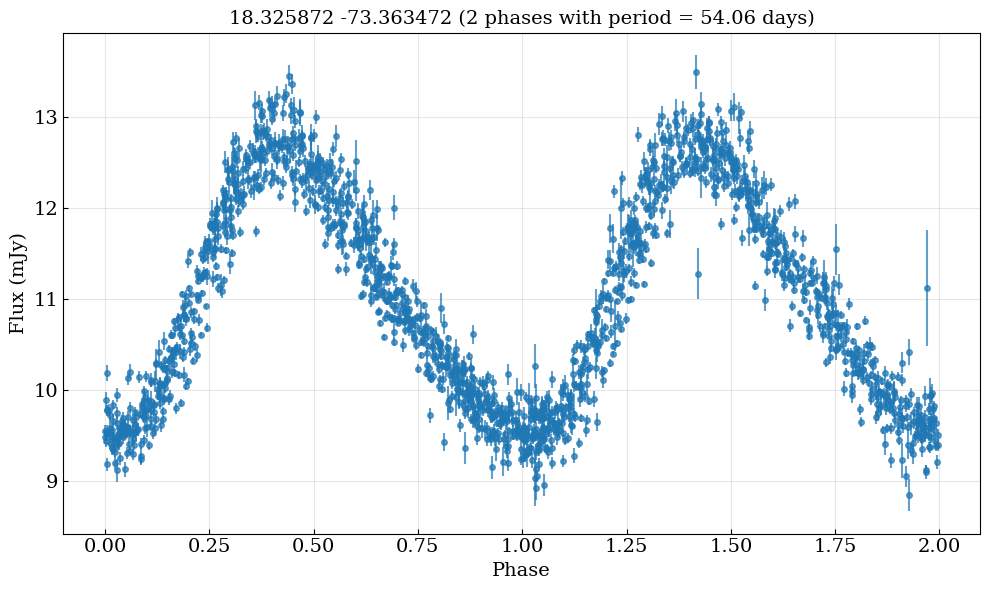

Average scatter (amplitude) per 10 point phase bin: 0.851 mJy
target 364
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.602375100038098, 4.222729305916982
telescope k 56 0.12147505422993492
telescope o 108 0.16314199395770393
telescope G 127 0.20751633986928106
Most data telescope in window: G
RA: 18.861405, DEC: -73.337494


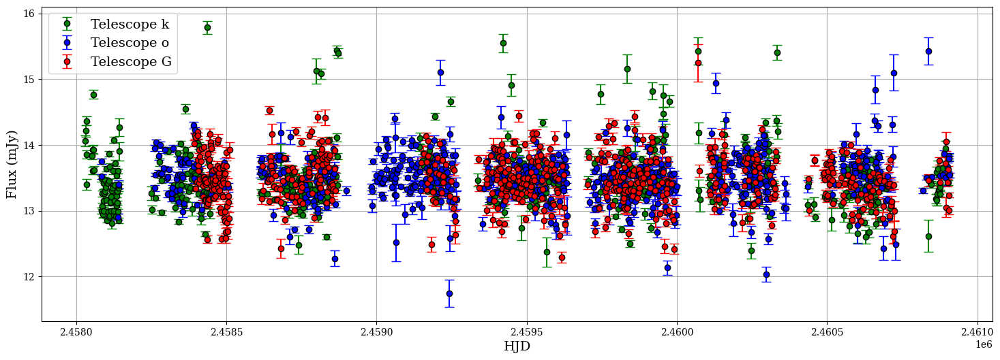

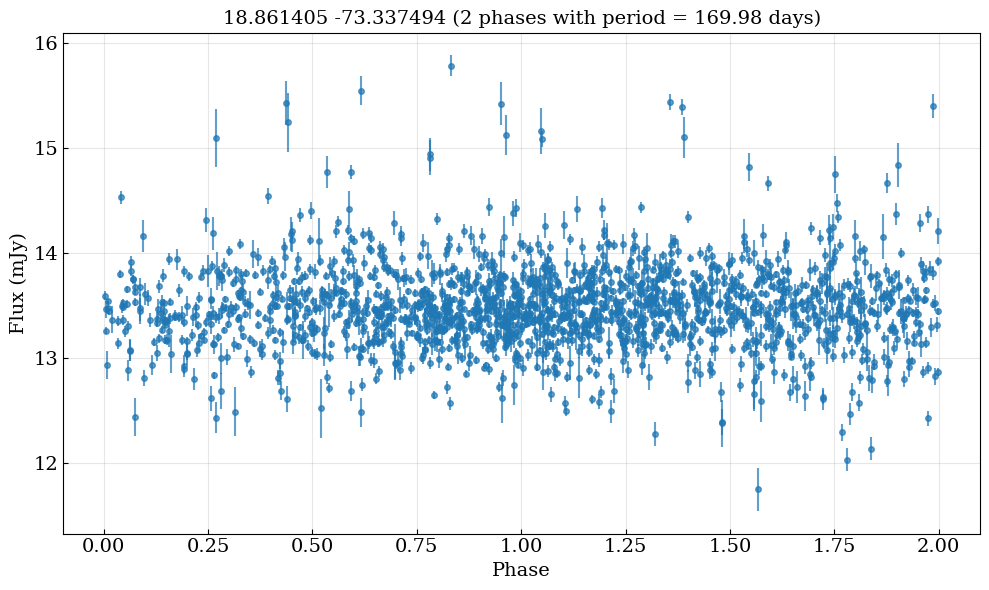

Average scatter (amplitude) per 10 point phase bin: 1.148 mJy
target 383
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
3.7270764462500794, 4.005322128585668
telescope j 63 0.10843373493975904
telescope n 116 0.17365269461077845
Most data telescope in window: n
RA: 71.327625, DEC: -69.27739


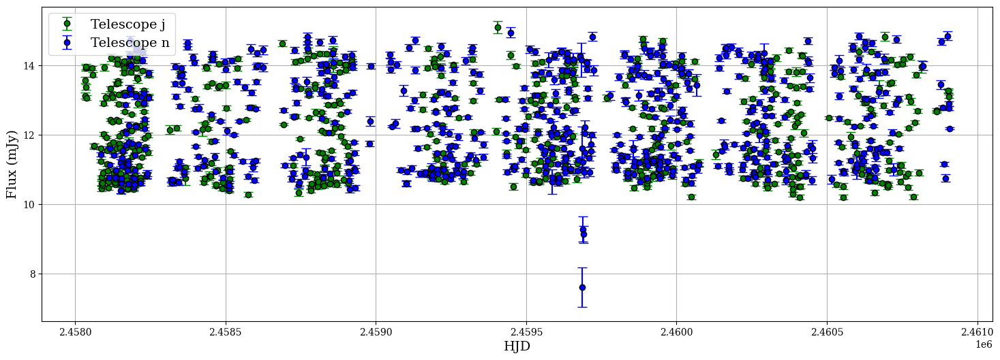

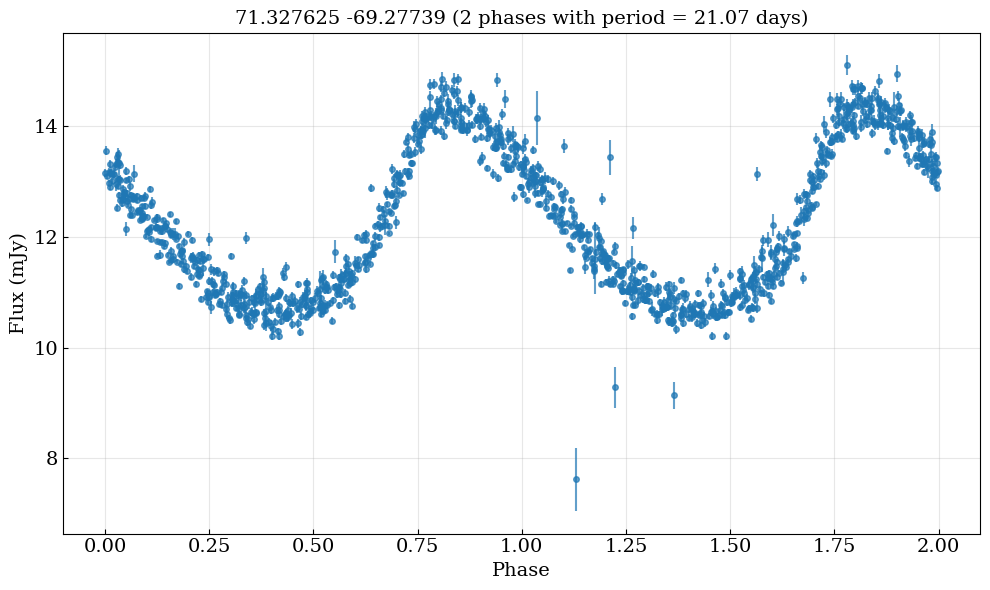

Average scatter (amplitude) per 10 point phase bin: 0.904 mJy
target 395
main type: Star
offset flag: 0
alarm level flag: 0
3.61706730114941, 4.431224807703229
telescope j 63 0.10843373493975904
telescope n 116 0.17365269461077845
Most data telescope in window: n
RA: 72.485769, DEC: -69.755859


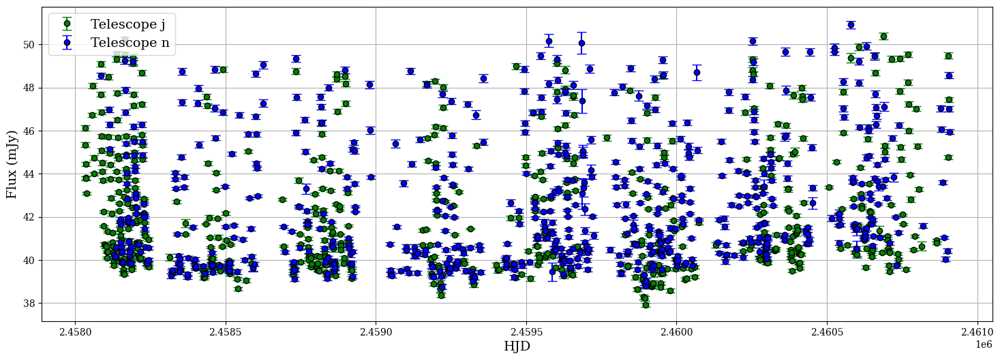

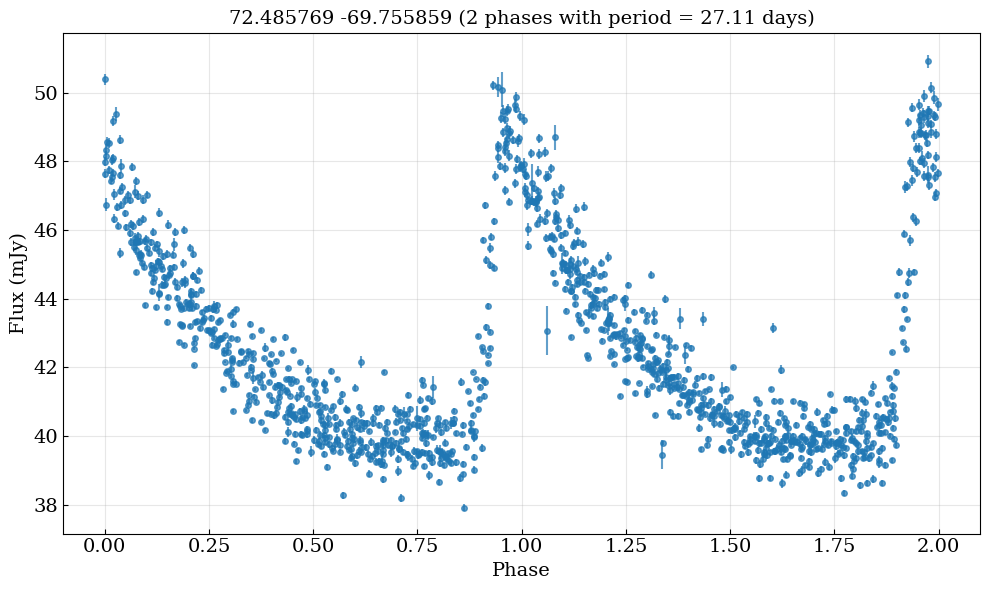

Average scatter (amplitude) per 10 point phase bin: 2.468 mJy
target 524
main type: BlueSG
offset flag: 0
alarm level flag: 0
3.937230033109724, 4.506311688023997
telescope l 65 0.10851419031719532
telescope j 63 0.10862068965517241
telescope p 108 0.17115689381933438
telescope n 116 0.17365269461077845
telescope H 168 0.23829787234042554
Most data telescope in window: H
RA: 76.209054, DEC: -68.13121


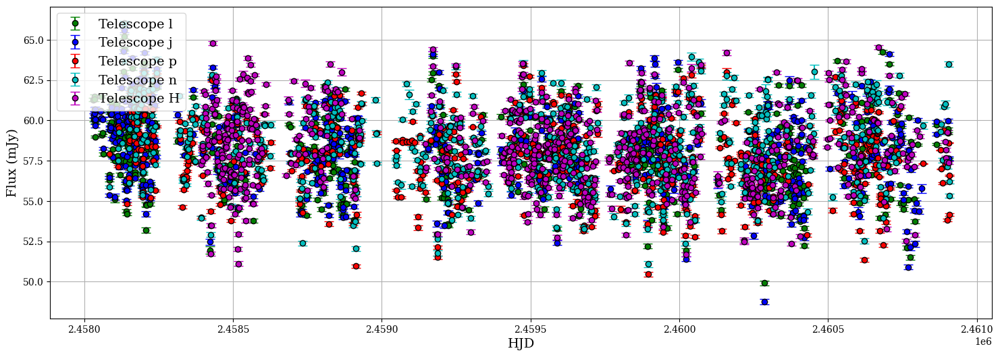

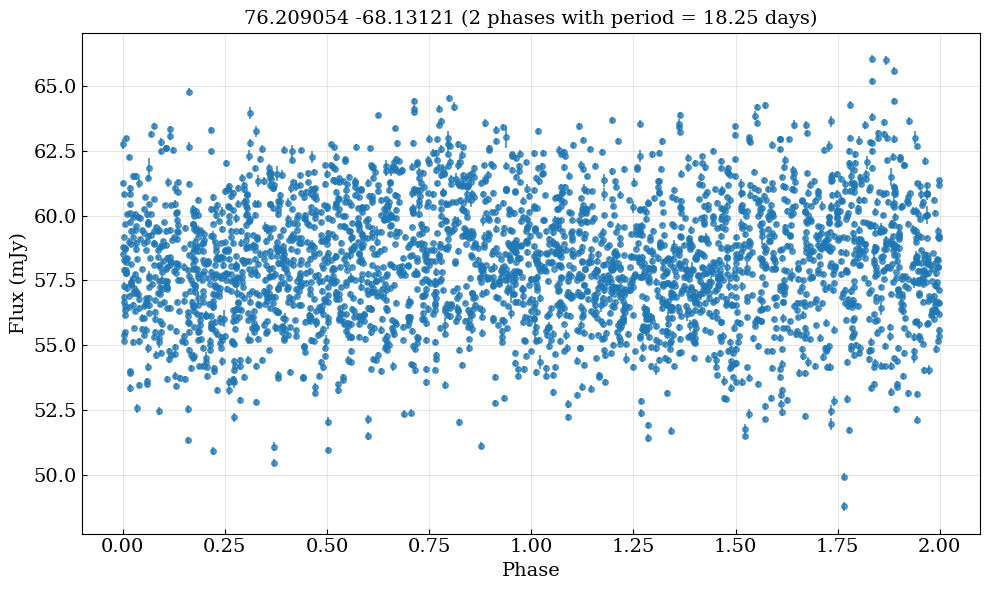

Average scatter (amplitude) per 10 point phase bin: 6.289 mJy
target 537
main type: Supergiant
offset flag: 0
alarm level flag: 0
3.8096134140925497, 4.035552545829724
telescope i 66 0.11092436974789915
telescope j 63 0.10843373493975904
telescope n 116 0.17365269461077845
telescope m 98 0.14561664190193166
telescope E 173 0.2386206896551724
Most data telescope in window: E
RA: 76.580081, DEC: -71.470123


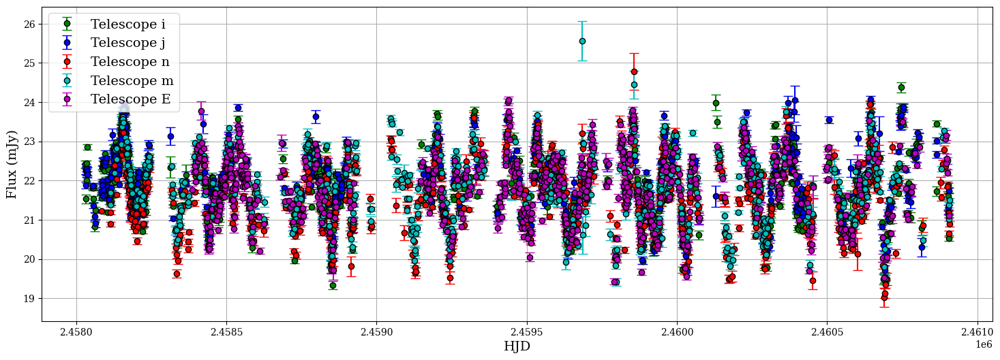

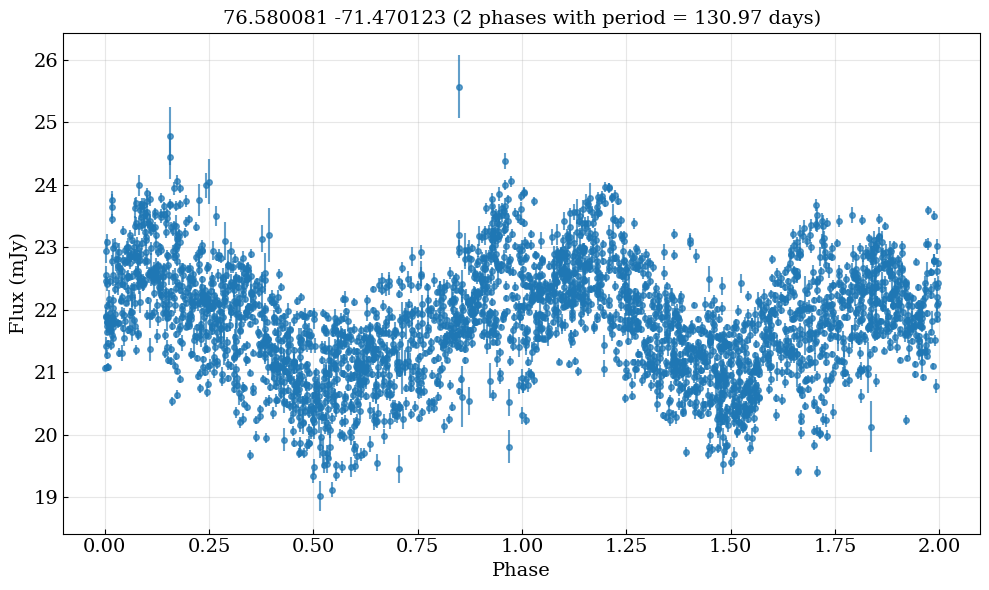

Average scatter (amplitude) per 10 point phase bin: 1.874 mJy
target 540
main type: Star
offset flag: 0
alarm level flag: 0
3.610997038180849, 4.039254879872736
telescope i 66 0.11092436974789915
telescope j 63 0.10843373493975904
telescope n 116 0.17365269461077845
telescope m 99 0.14688427299703263
telescope E 173 0.2392807745504841
Most data telescope in window: E
RA: 76.614966, DEC: -68.364449


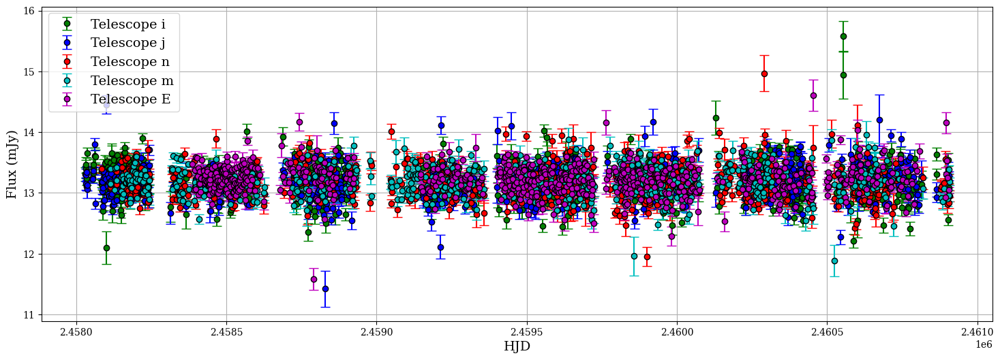

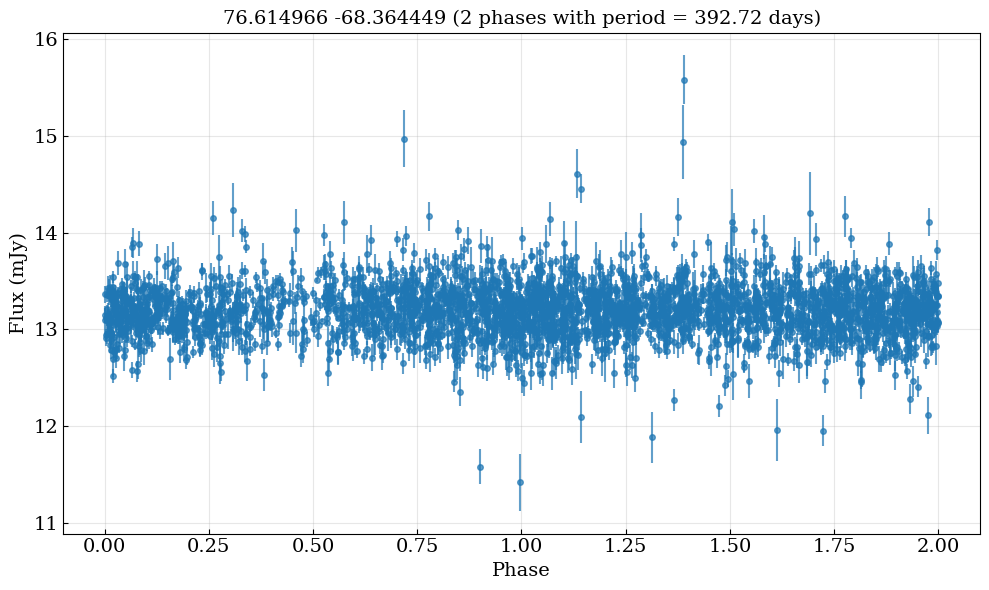

Average scatter (amplitude) per 10 point phase bin: 0.771 mJy
target 572
main type: LongPeriodV*
offset flag: 0
alarm level flag: 0
3.753950816431925, 4.16767276481191
telescope i 66 0.11186440677966102
telescope m 89 0.1354642313546423
telescope E 173 0.23895027624309392
Most data telescope in window: E
RA: 77.660807, DEC: -69.715027


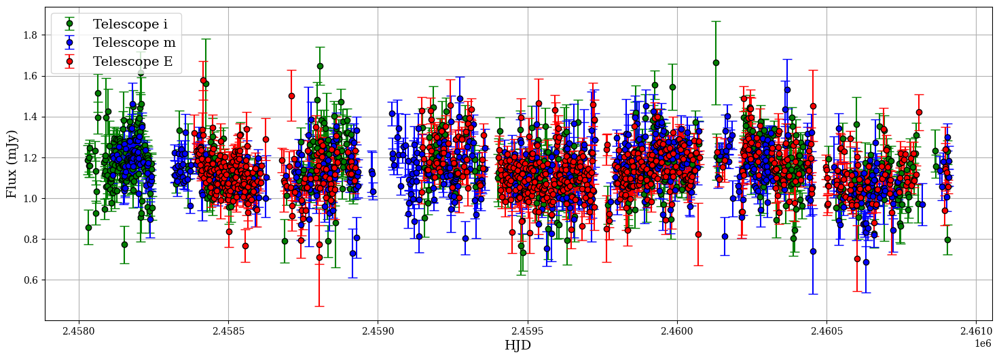

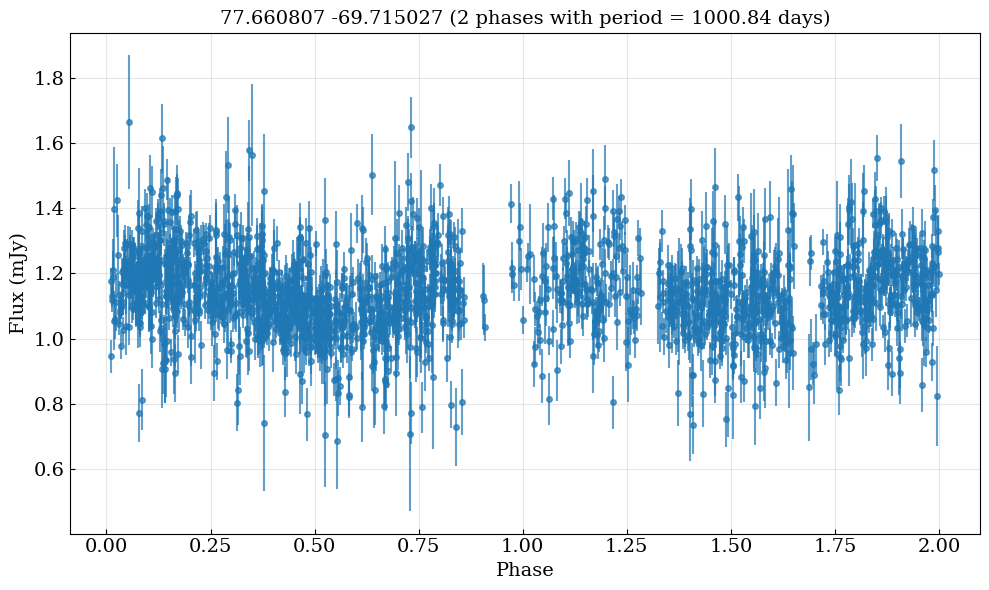

Average scatter (amplitude) per 10 point phase bin: 0.351 mJy
target 576
main type: LongPeriodV*
offset flag: 0
alarm level flag: 0
3.946672757033849, 4.374919963982601
telescope i 66 0.11224489795918367
telescope m 92 0.138763197586727
telescope E 173 0.2392807745504841
Most data telescope in window: E
RA: 77.946825, DEC: -69.4328


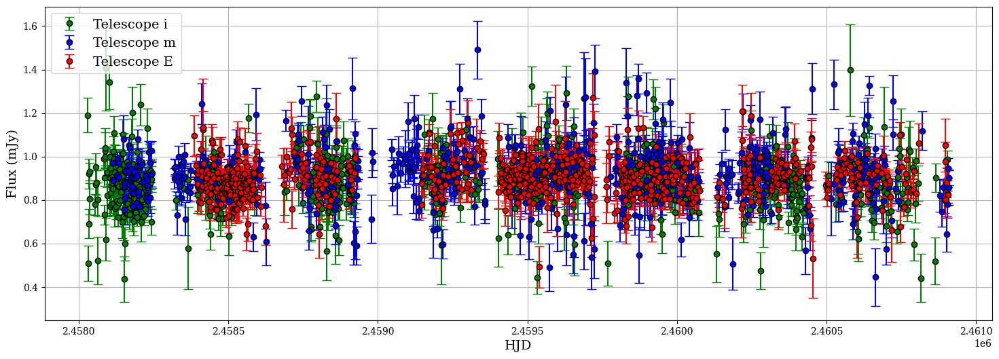

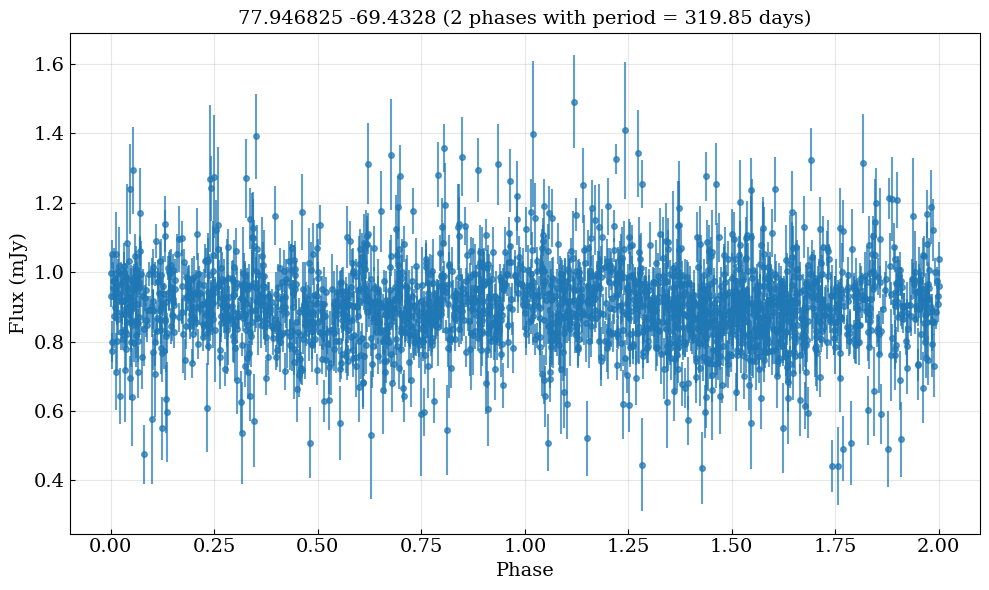

Average scatter (amplitude) per 10 point phase bin: 0.363 mJy
target 584
main type: LongPeriodV*
offset flag: 0
alarm level flag: 0
3.606068574908339, 4.5227667628735135
telescope i 66 0.11092436974789915
telescope m 99 0.14666666666666667
telescope E 173 0.2386206896551724
Most data telescope in window: E
RA: 78.285377, DEC: -70.139542


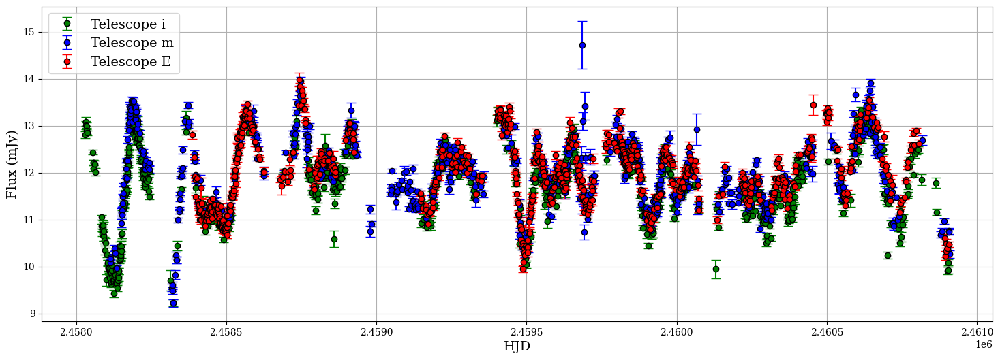

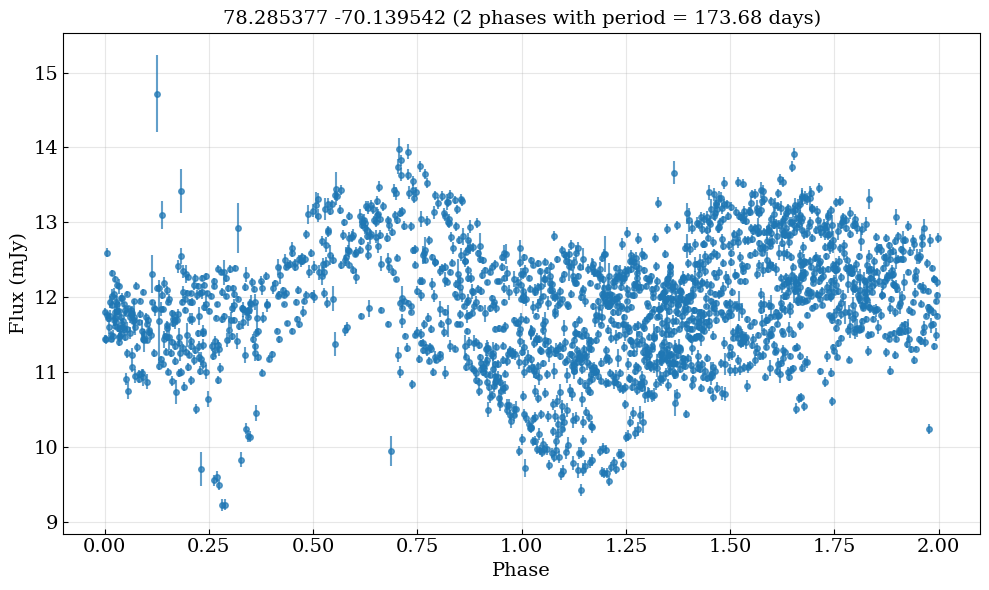

Average scatter (amplitude) per 10 point phase bin: 1.832 mJy
target 592
main type: BlueSG
offset flag: 0
alarm level flag: 0
3.9403174570568833, 4.935084121938359
Error occurred while plotting flux (likely discarded lc).
target 596
main type: Star
offset flag: 0
alarm level flag: 0
3.6253810629434584, 4.808216034704698
telescope l 65 0.10851419031719532
telescope p 115 0.1750380517503805
telescope H 168 0.23829787234042554
Most data telescope in window: H
RA: 78.578573, DEC: -67.263702


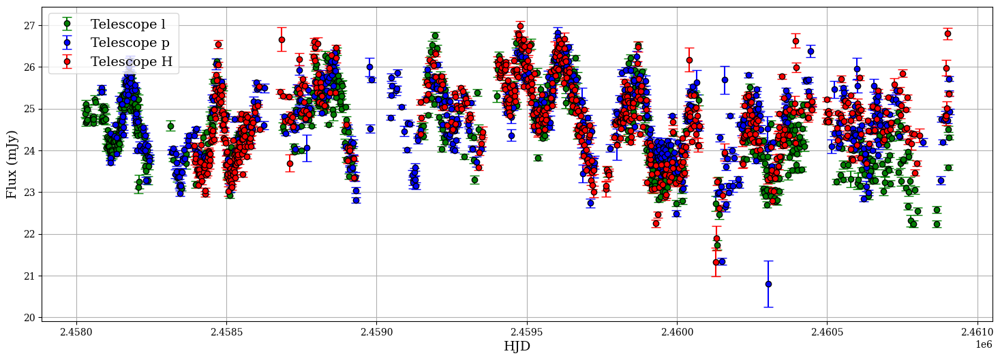

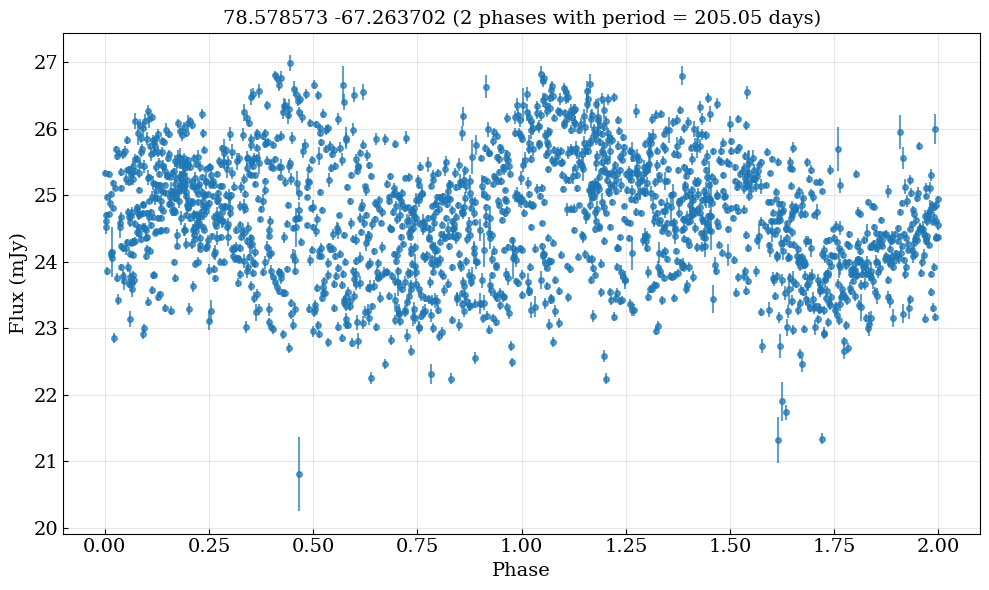

Average scatter (amplitude) per 10 point phase bin: 2.354 mJy
target 597
main type: ChemPec*
offset flag: 0
alarm level flag: 0
3.801576267603688, 4.278263935449397
telescope l 65 0.10851419031719532
telescope p 114 0.17378048780487804
telescope H 168 0.23829787234042554
Most data telescope in window: H
RA: 78.870786, DEC: -66.810394


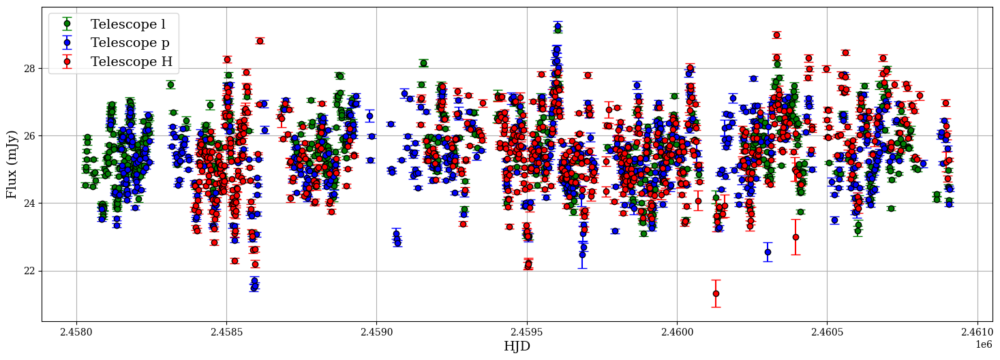

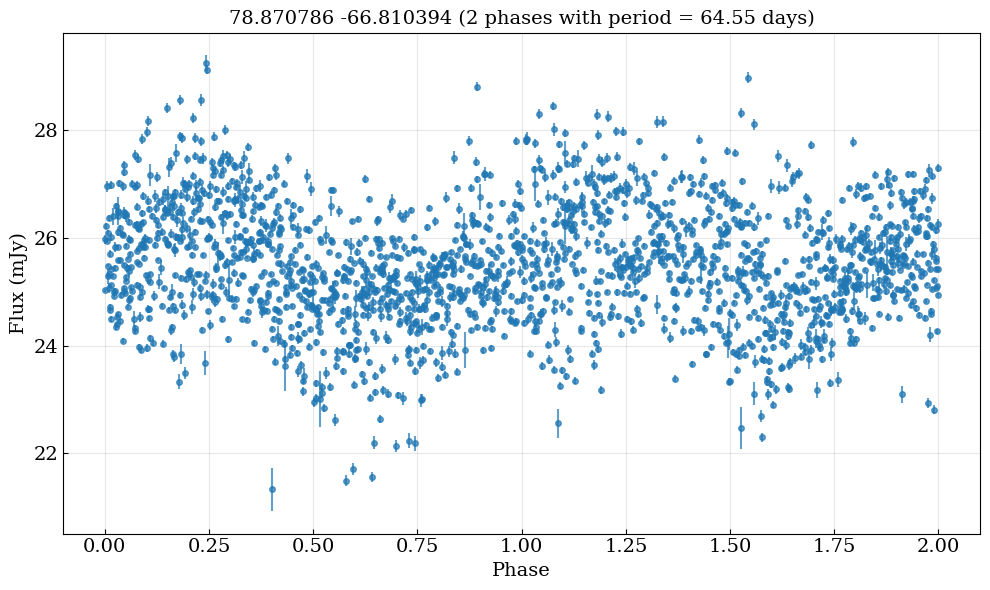

Average scatter (amplitude) per 10 point phase bin: 3.000 mJy
target 613
main type: LongPeriodV*
offset flag: 0
alarm level flag: 0
3.7199057671799745, 4.698184530216541
telescope l 65 0.10851419031719532
telescope i 66 0.11092436974789915
telescope p 115 0.1750380517503805
telescope m 99 0.14666666666666667
telescope E 173 0.23895027624309392
telescope H 168 0.23829787234042554
Most data telescope in window: E
RA: 80.009071, DEC: -68.063393


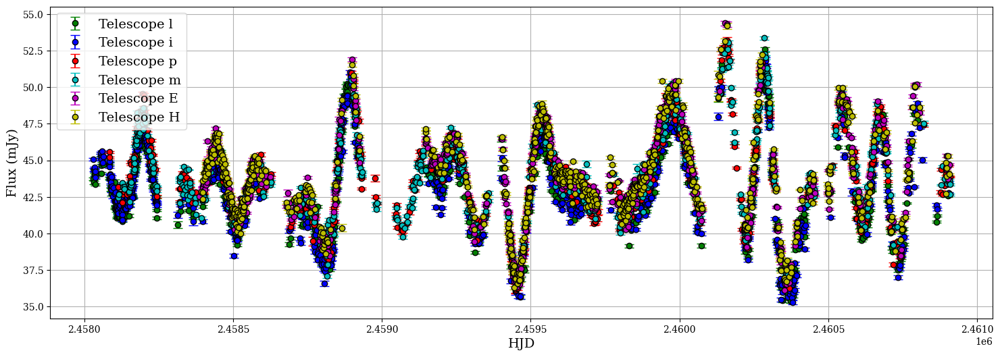

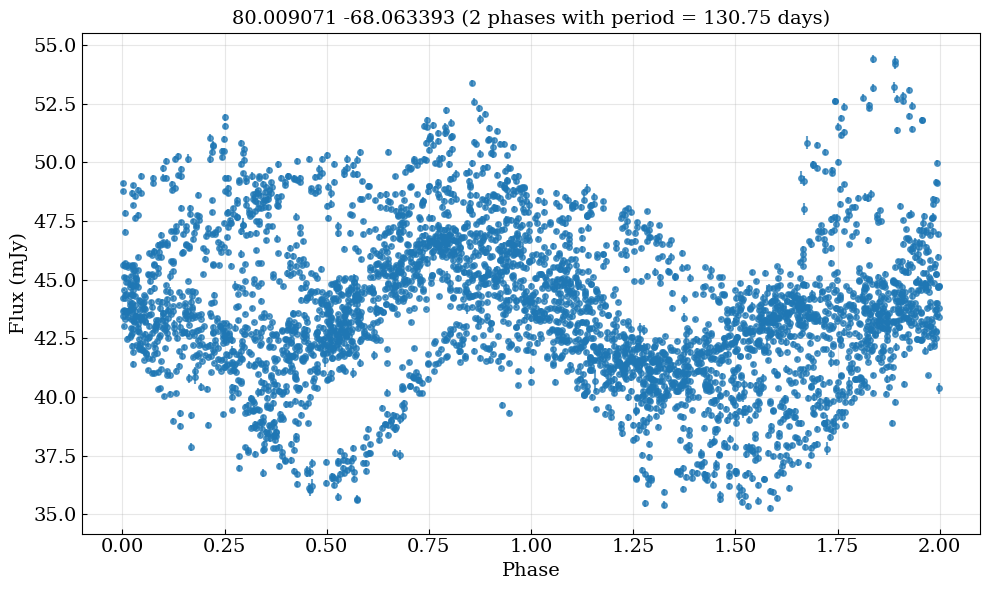

Average scatter (amplitude) per 10 point phase bin: 7.045 mJy
target 668
main type: LongPeriodV*
offset flag: 0
alarm level flag: 0
3.6532172938084857, 4.024282457738858
telescope i 65 0.1097972972972973
telescope m 97 0.14456035767511177
telescope E 173 0.2392807745504841
Most data telescope in window: E
RA: 81.97569, DEC: -68.328835


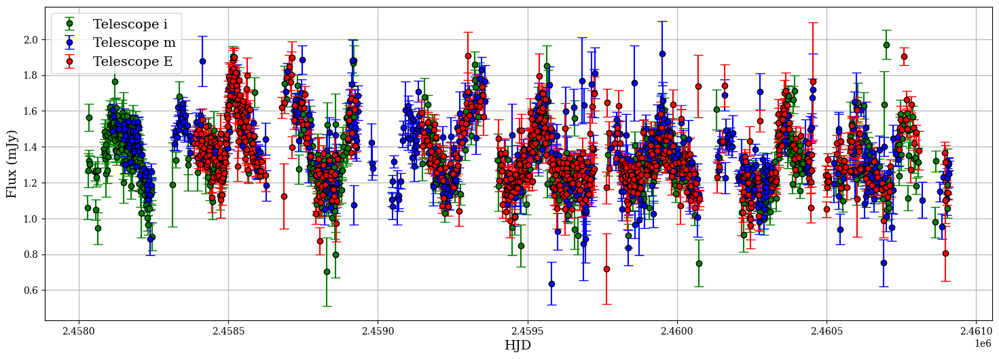

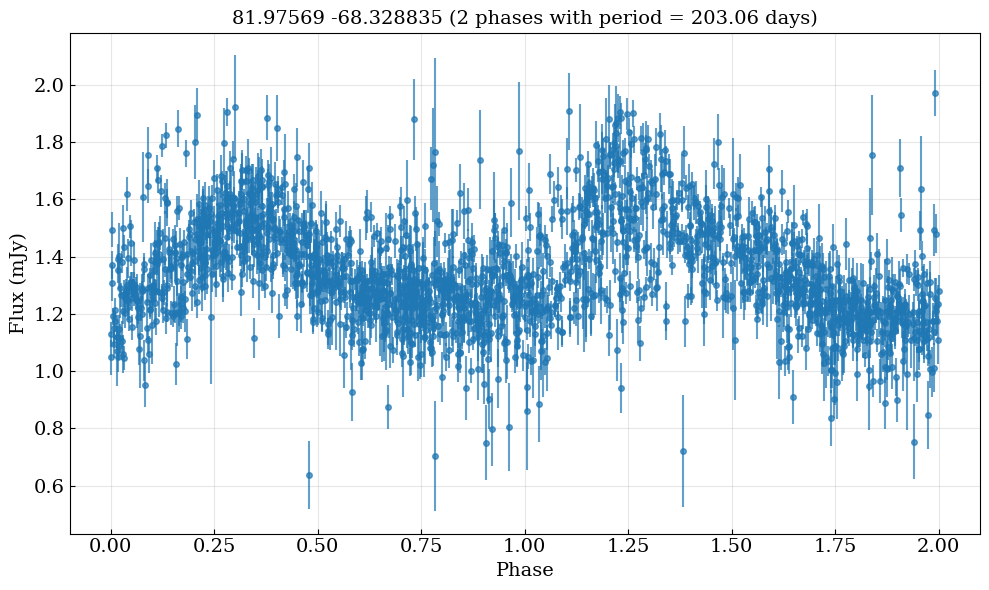

Average scatter (amplitude) per 10 point phase bin: 0.432 mJy
target 669
main type: LongPeriodV*
offset flag: 0
alarm level flag: 0
3.717033204222571, 4.112604815254474
telescope i 66 0.1111111111111111
telescope m 97 0.14456035767511177
telescope E 173 0.2392807745504841
Most data telescope in window: E
RA: 81.978051, DEC: -68.328995


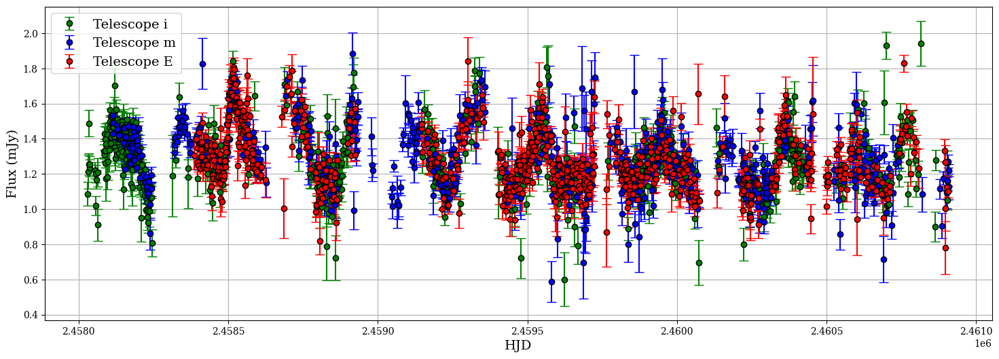

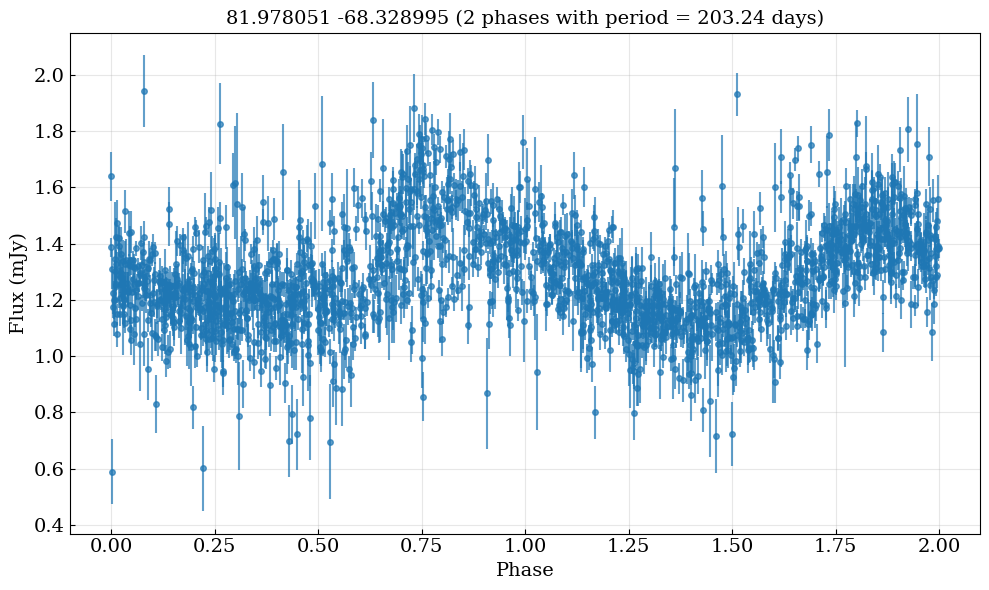

Average scatter (amplitude) per 10 point phase bin: 0.423 mJy
target 680
main type: Star
offset flag: 0
alarm level flag: 0
3.604378121235305, 4.228471761271967
telescope k 60 0.10507880910683012
telescope l 65 0.10851419031719532
telescope p 115 0.1750380517503805
telescope o 124 0.181021897810219
telescope H 168 0.23829787234042554
Most data telescope in window: H
RA: 82.256902, DEC: -66.649391


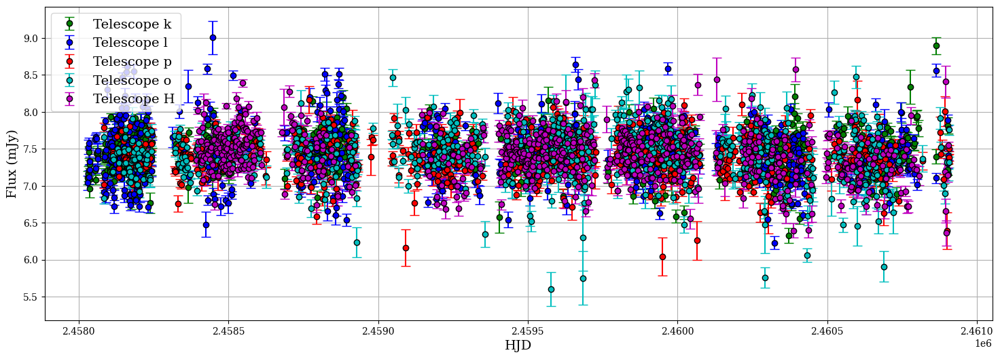

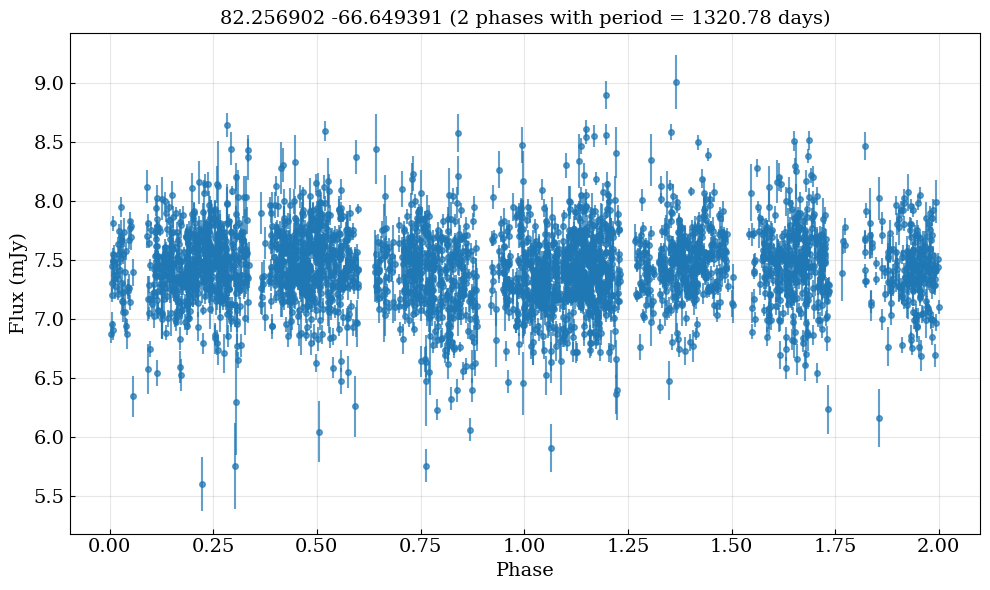

Average scatter (amplitude) per 10 point phase bin: 0.974 mJy
target 696
main type: EmLine*
offset flag: 0
alarm level flag: 0
3.81950055165012, 4.112239669006054
telescope i 66 0.11092436974789915
telescope m 99 0.14666666666666667
telescope E 173 0.2386206896551724
Most data telescope in window: E
RA: 82.67394, DEC: -69.192993


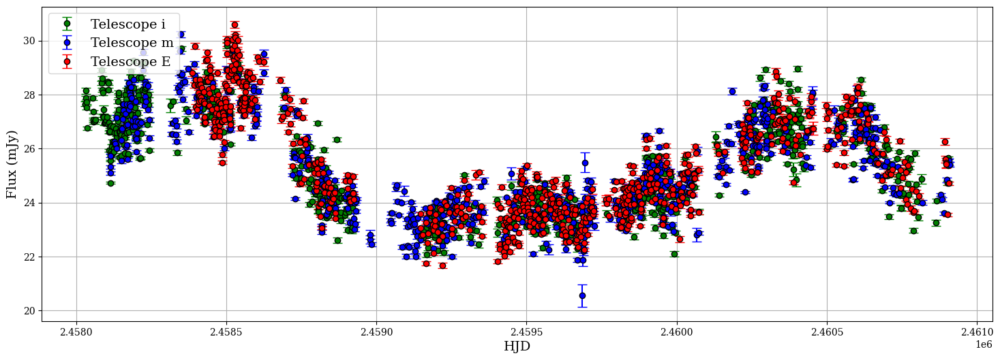

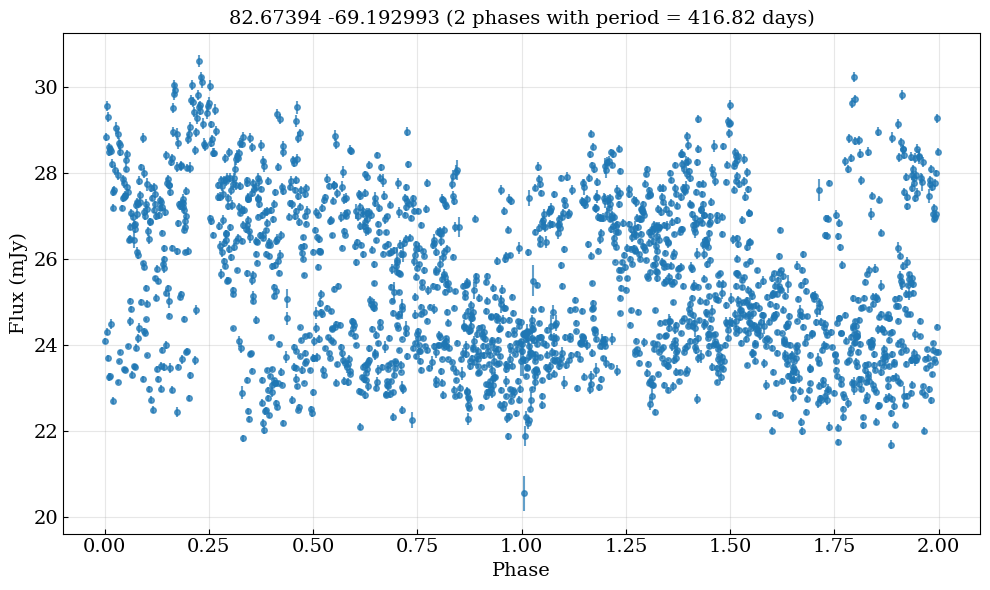

Average scatter (amplitude) per 10 point phase bin: 4.204 mJy
target 716
main type: LongPeriodV*_Candidate
offset flag: 0
alarm level flag: 0
3.661678631879852, 4.687016281093459
telescope k 60 0.10507880910683012
telescope i 66 0.11320754716981132
telescope o 125 0.18221574344023322
Most data telescope in window: o
RA: 83.291798, DEC: -67.733246


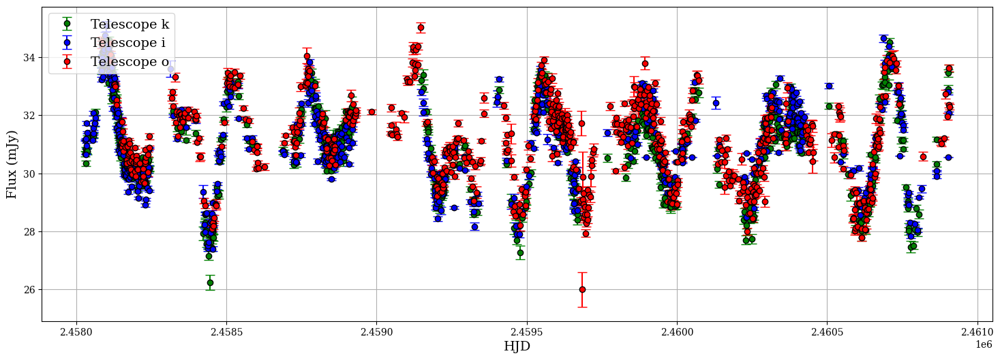

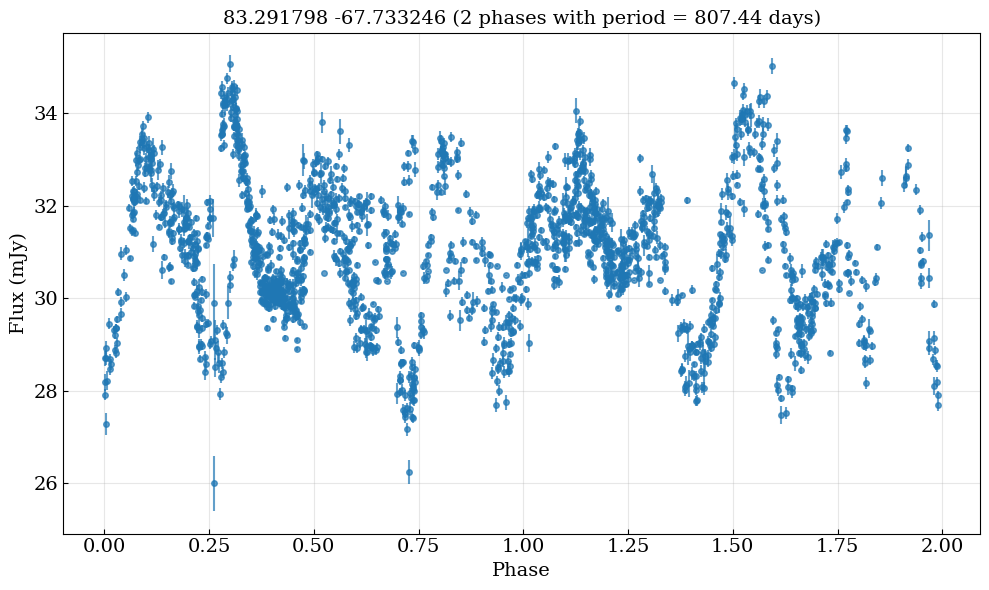

Average scatter (amplitude) per 10 point phase bin: 2.116 mJy
target 719
main type: AGB*
offset flag: 0
alarm level flag: 0
3.665410331422831, 4.08753775975765
telescope i 66 0.11092436974789915
telescope j 97 0.1658119658119658
telescope n 30 0.06993006993006994
telescope m 99 0.14666666666666667
telescope E 173 0.2386206896551724
Most data telescope in window: E
RA: 83.401523, DEC: -69.386848


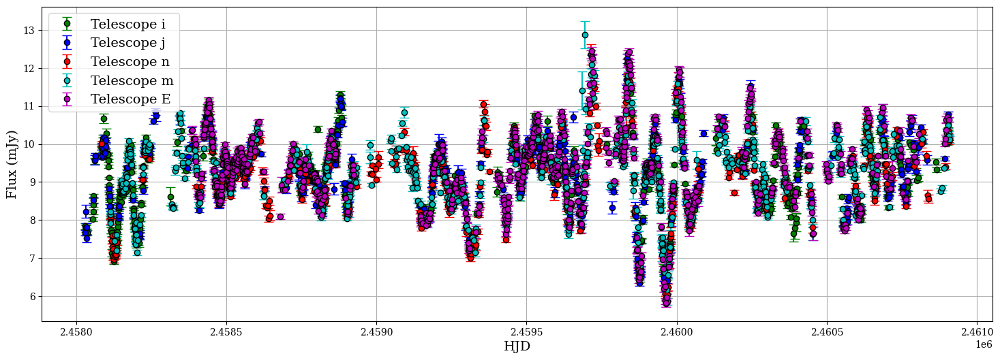

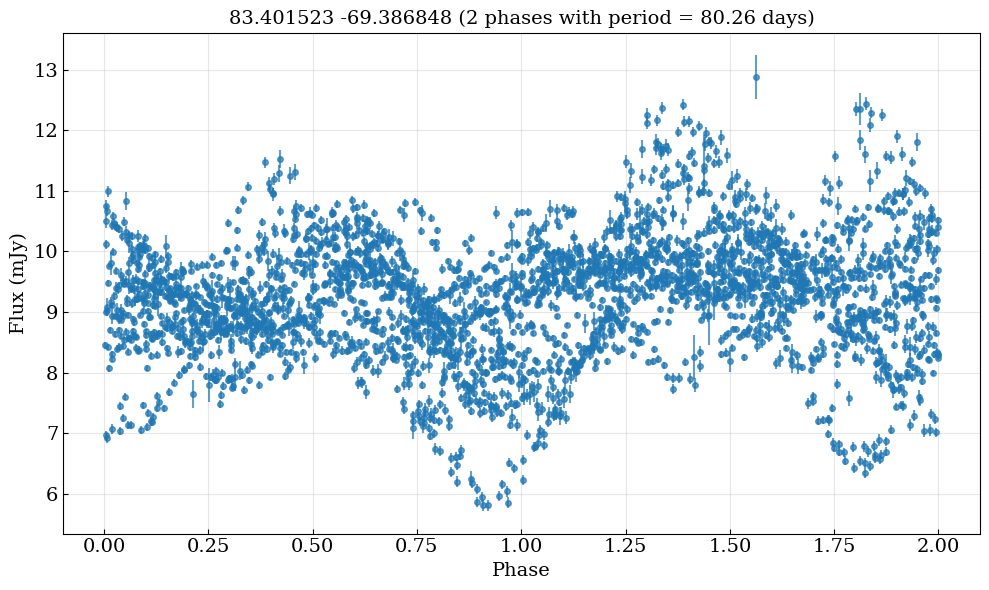

Average scatter (amplitude) per 10 point phase bin: 2.522 mJy
target 743
main type: Star
offset flag: 0
alarm level flag: 0
3.82221746608736, 4.11608628414004
telescope i 66 0.11092436974789915
telescope j 97 0.1658119658119658
telescope n 30 0.06993006993006994
telescope m 99 0.14666666666666667
telescope E 173 0.2386206896551724
Most data telescope in window: E
RA: 84.266308, DEC: -69.167656


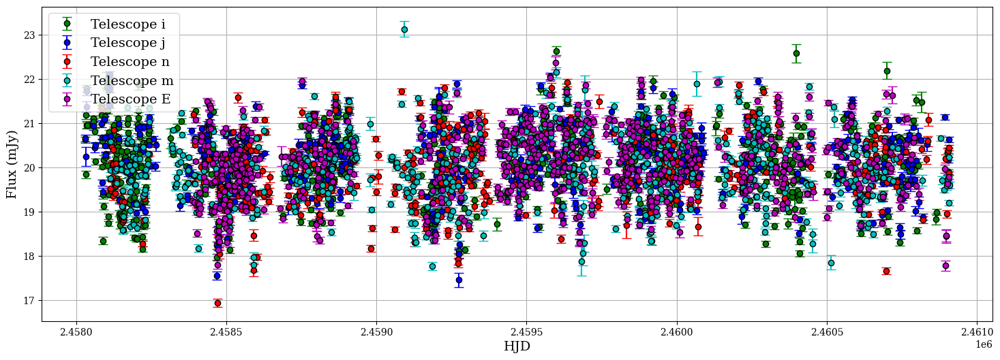

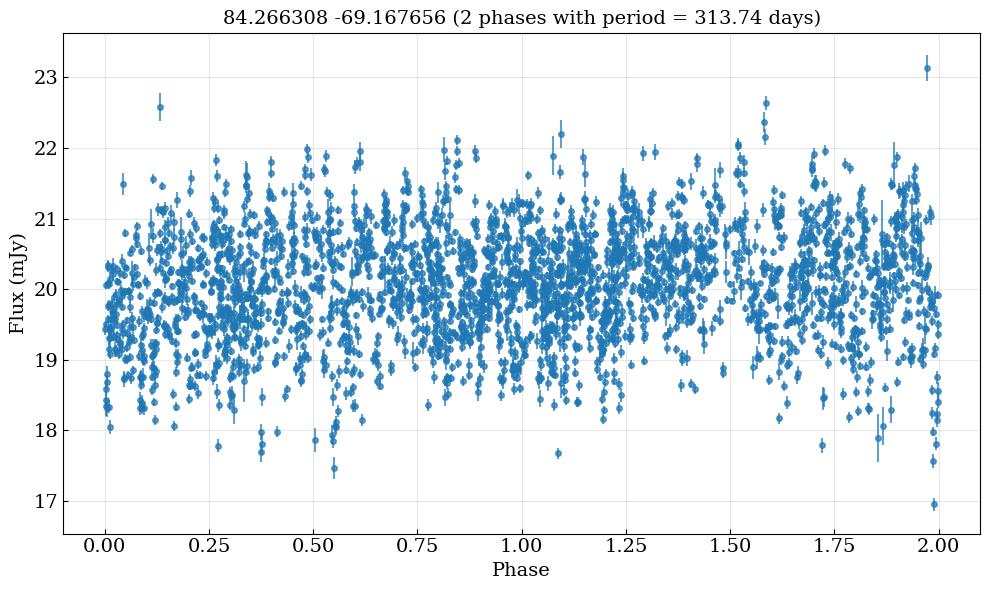

Average scatter (amplitude) per 10 point phase bin: 1.875 mJy
target 752
main type: BlueSG
offset flag: 0
alarm level flag: 0
3.7288633644749063, 4.381062788787544
telescope i 66 0.11092436974789915
telescope j 97 0.1658119658119658
telescope n 30 0.06993006993006994
telescope m 98 0.14540059347181009
telescope E 173 0.2386206896551724
Most data telescope in window: E
RA: 84.661939, DEC: -69.13736


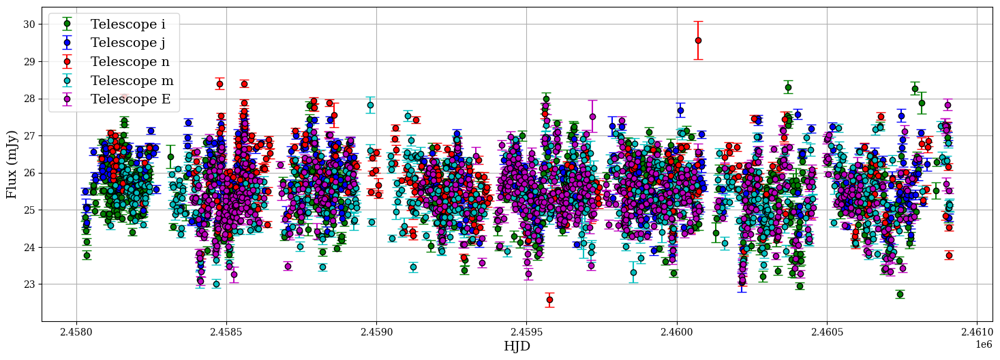

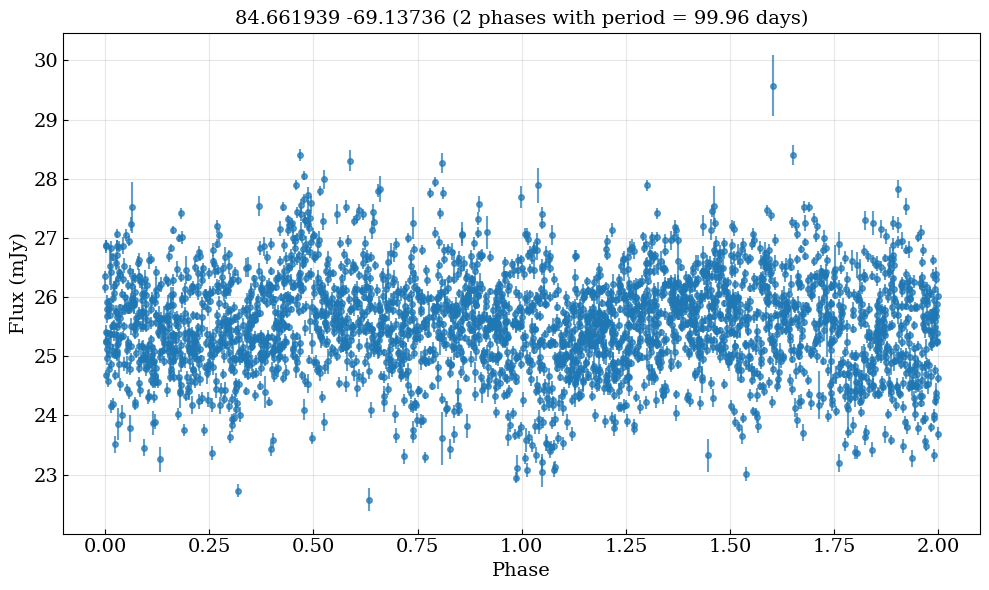

Average scatter (amplitude) per 10 point phase bin: 2.359 mJy
target 780
main type: EmLine*
offset flag: 0
alarm level flag: 0
3.7757376491694967, 4.124433844514464
telescope k 60 0.10507880910683012
telescope o 125 0.18221574344023322
telescope n 30 0.06993006993006994
Most data telescope in window: o
RA: 85.284794, DEC: -67.3564


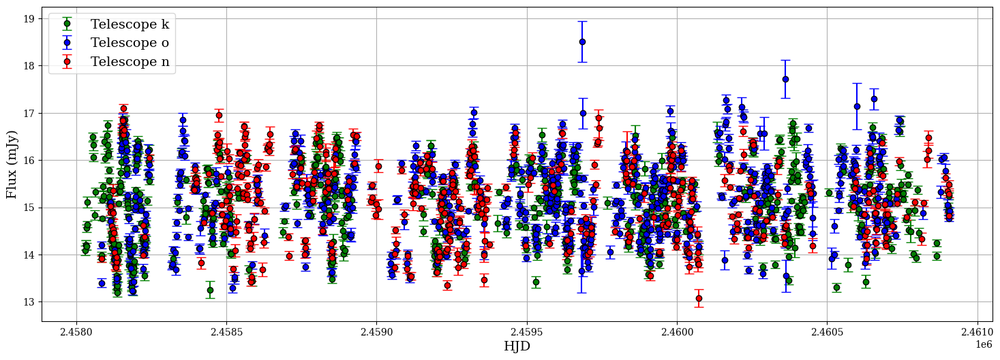

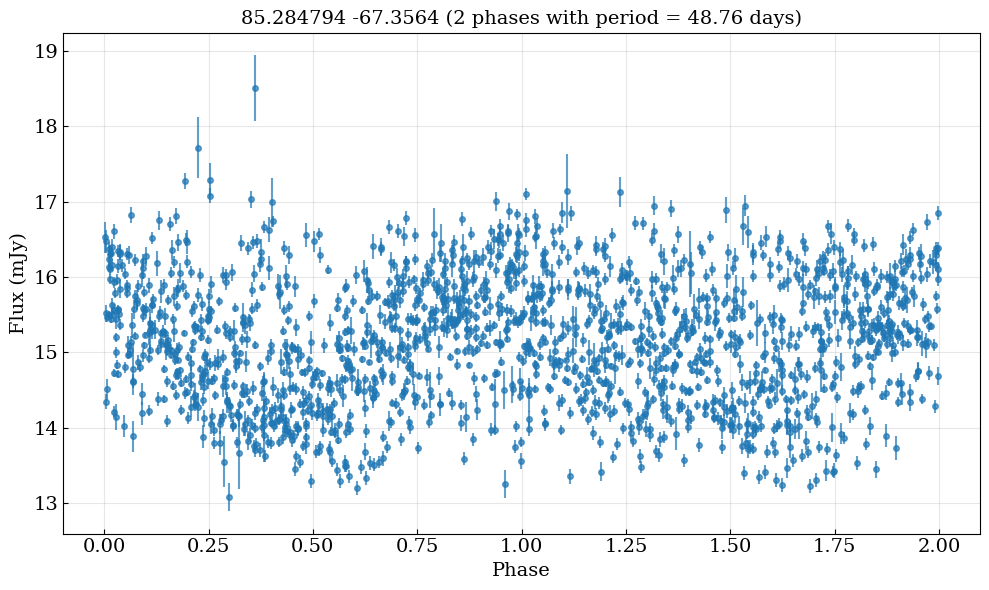

Average scatter (amplitude) per 10 point phase bin: 2.296 mJy
target 788
main type: BlueSG
offset flag: 0
alarm level flag: 0
3.8626142532778487, 4.07016453229136
telescope i 66 0.11092436974789915
telescope j 97 0.1658119658119658
telescope n 30 0.06993006993006994
telescope m 99 0.14666666666666667
telescope E 173 0.2386206896551724
Most data telescope in window: E
RA: 85.436136, DEC: -69.587502


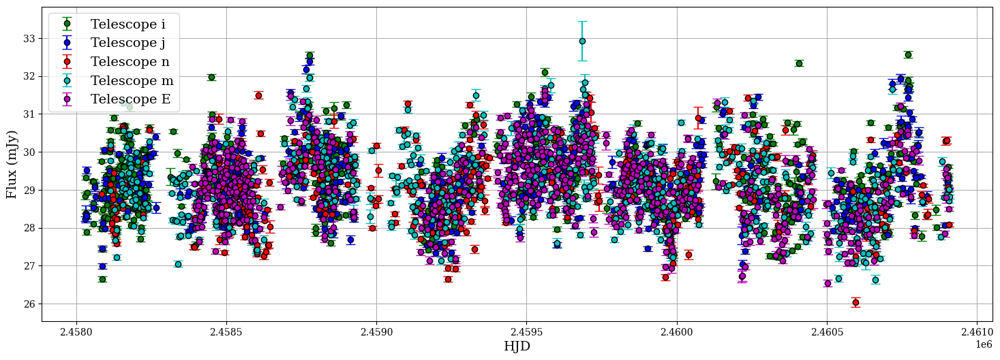

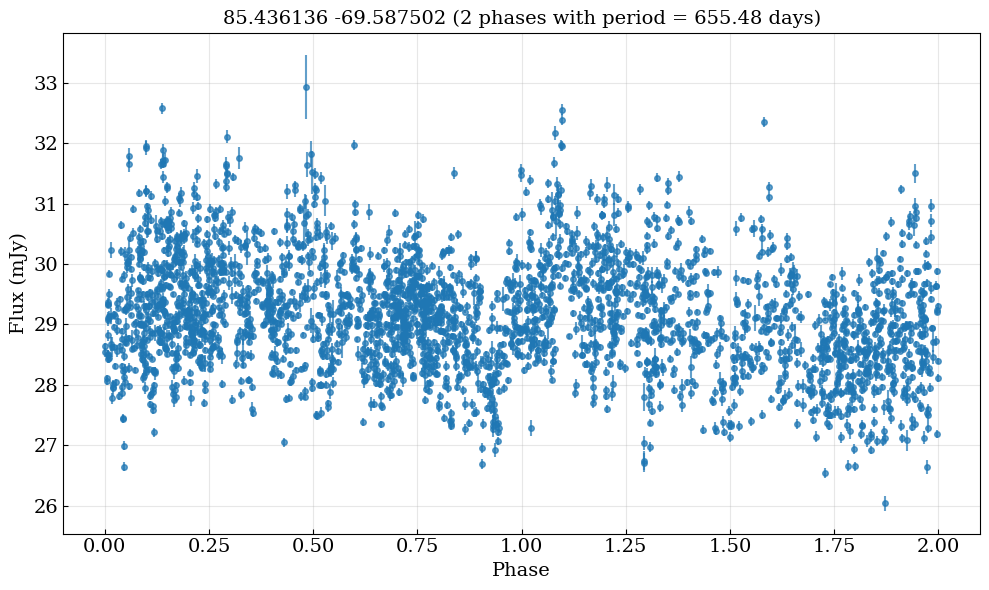

Average scatter (amplitude) per 10 point phase bin: 2.111 mJy
target 823
main type: EclBin
offset flag: 0
alarm level flag: 0
3.9212714055092137, 4.091748162703316
telescope k 60 0.10507880910683012
telescope o 125 0.18221574344023322
Most data telescope in window: o
RA: 86.507263, DEC: -66.990051


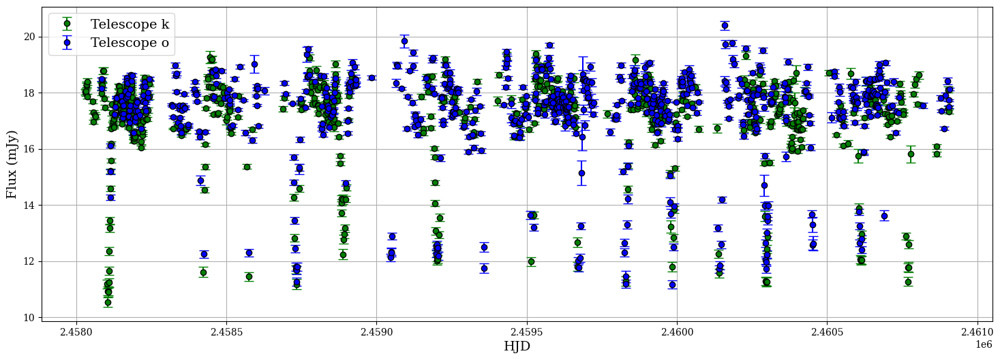

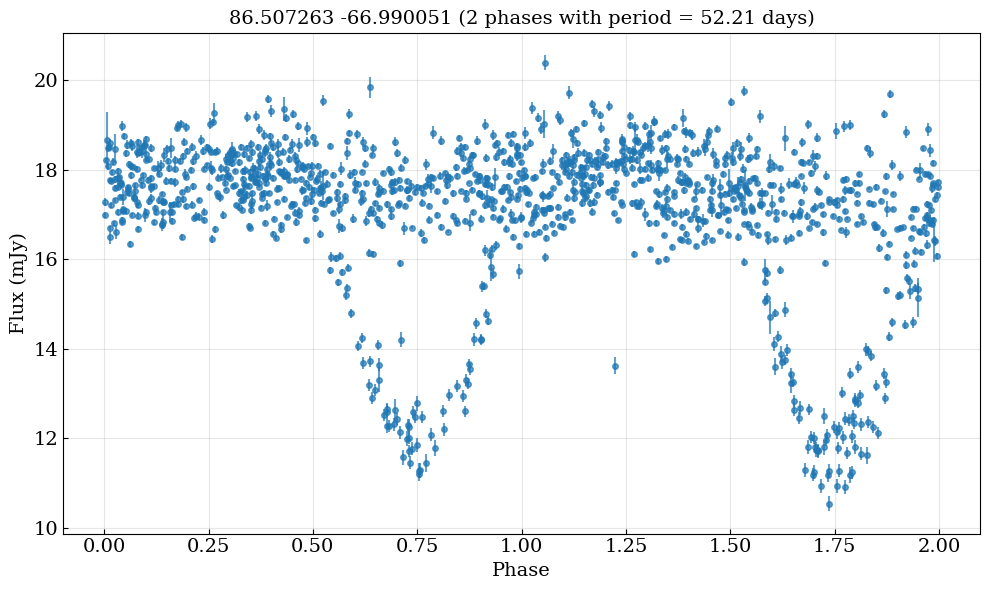

Average scatter (amplitude) per 10 point phase bin: 3.409 mJy
target 834
main type: Star
offset flag: 0
alarm level flag: 0
3.6353111460597134, 4.680908484303489
telescope i 66 0.11092436974789915
telescope j 97 0.1658119658119658
telescope n 30 0.06993006993006994
telescope m 99 0.14666666666666667
telescope E 173 0.2392807745504841
Most data telescope in window: E
RA: 87.212245, DEC: -68.168159


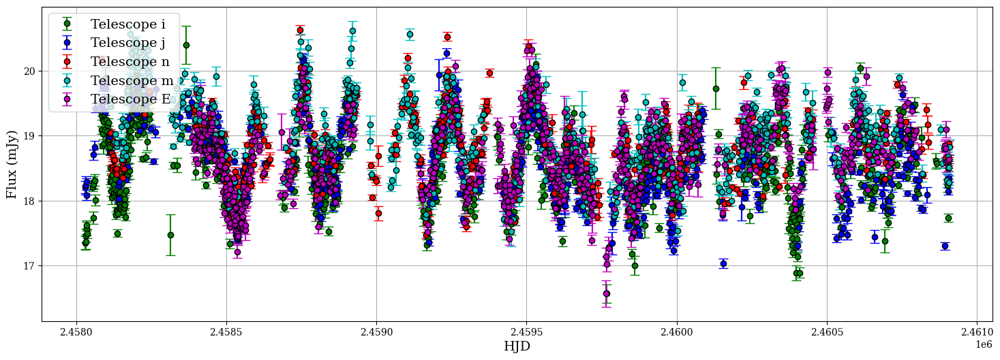

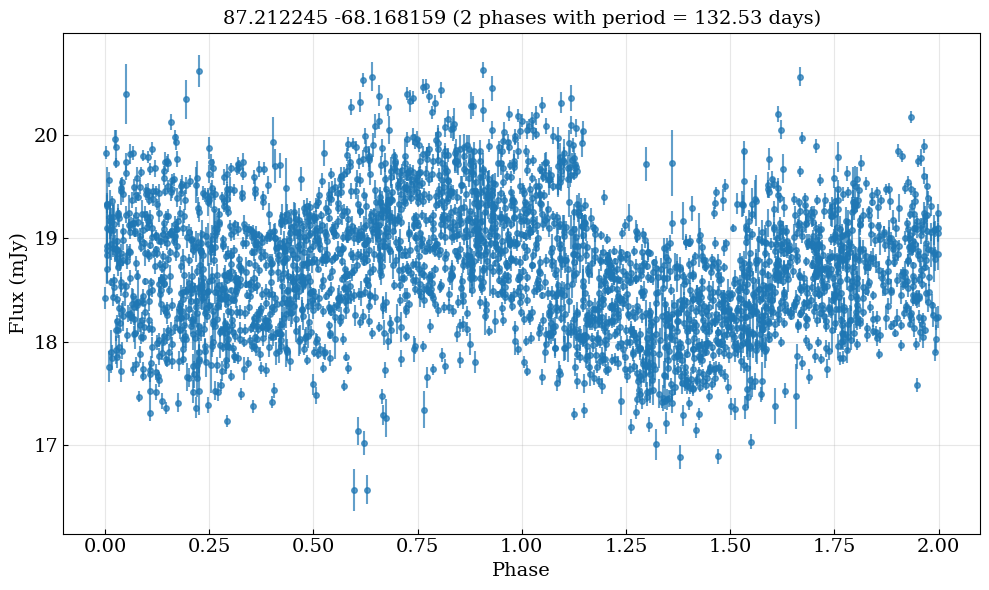

Average scatter (amplitude) per 10 point phase bin: 1.638 mJy


In [53]:
from metrics import plot_phase_fold


main_types = simbad_df['main_type'].replace('', np.nan).fillna('Unknown').astype(str)
for i in above_density_targets:
    print(f'target {i}')
    try:
        print(f"main type: {main_types.iloc[i]}")
    except:
        print("main type: Unknown")
    print(f'offset flag: {simbad_df["offset_flag"].iloc[i]}')
    print(f'alarm level flag: {simbad_df["alarm_level_flag"].iloc[i]}')
    print(f"logT and logL: {df_smc['logT'].iloc[i]}, {df_smc['logL'].iloc[i]}" if i < 377 else f"{df_lmc['logT'].iloc[i-377]}, {df_lmc['logL'].iloc[i-377]}")
    try:
        fit_plotter_flux(i, g=True)
        lombs = compute_lomb_scargle(i,auto=False, median=False, subtract_median=False, samples_per_peak=10, report=False)
        # plot_periodogram(target, lombs['frequency'], lombs['power'], lombs['best_frequency'], lombs['false_alarm_level'], lombs['peaks'], lombs['observation_period'], show_best=True)
        plot_phase_fold(i, lombs['best_period'], phase_bins=2)
    except:
        print("Error occurred while plotting flux (likely discarded lc).")

target 6
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.79498098679828, 4.03439240577564
telescope l 56 0.11740041928721175
telescope o 30 0.12
telescope p 103 0.1606864274570983
telescope G 61 0.15844155844155844
telescope H 135 0.22167487684729065
RA: 8.228736, DEC: -73.821953


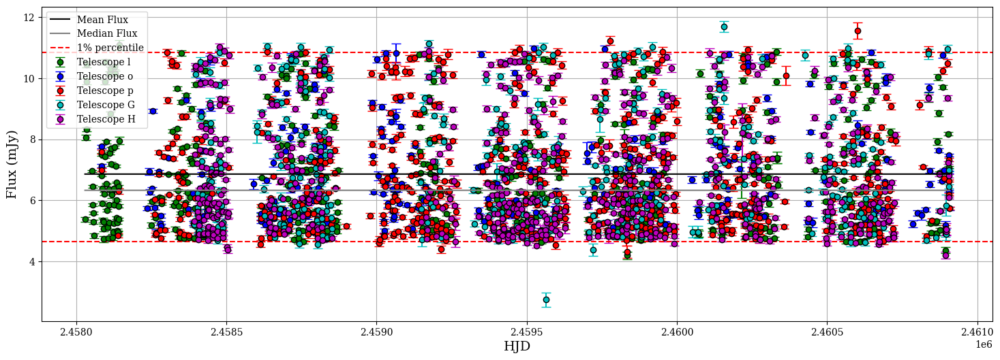

target 16
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.689903794746307, 4.048967917058972
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
RA: 9.57867, DEC: -73.525597


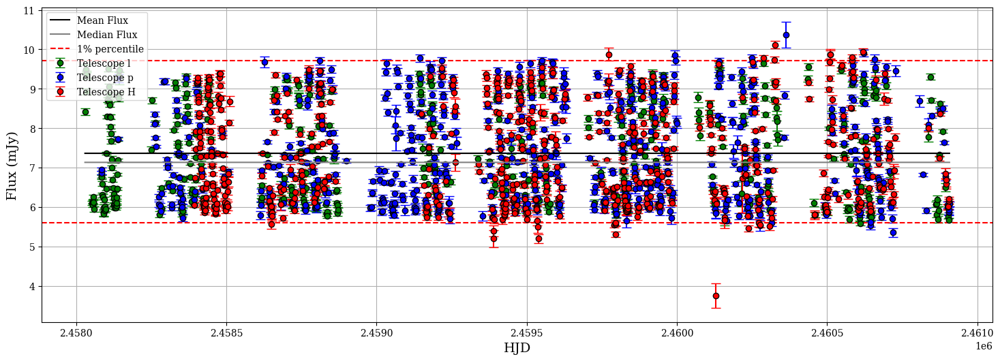

target 17
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.756468455364246, 4.0739798016246125
telescope i 74 0.15416666666666667
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope m 14 0.050724637681159424
telescope E 83 0.1873589164785553
telescope H 135 0.22167487684729065
RA: 9.818972, DEC: -72.032875


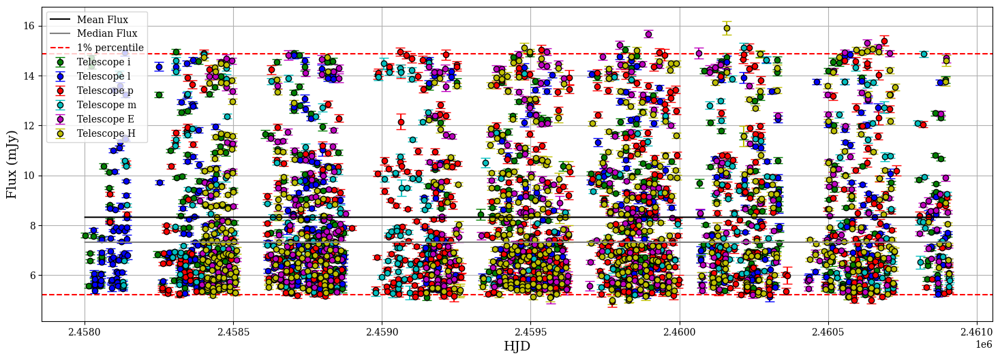

target 19
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.726839240543738, 4.062092386730764
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
RA: 10.191936, DEC: -73.717102


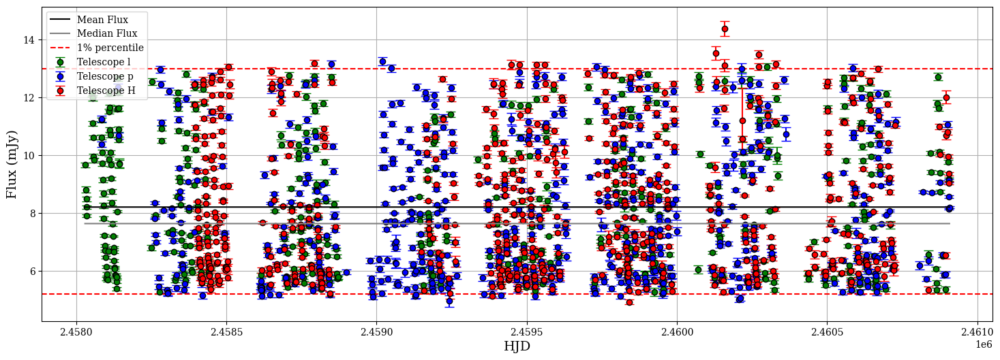

target 24
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.742655406560862, 4.22889132912468
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22203947368421054
RA: 10.95191, DEC: -73.613548


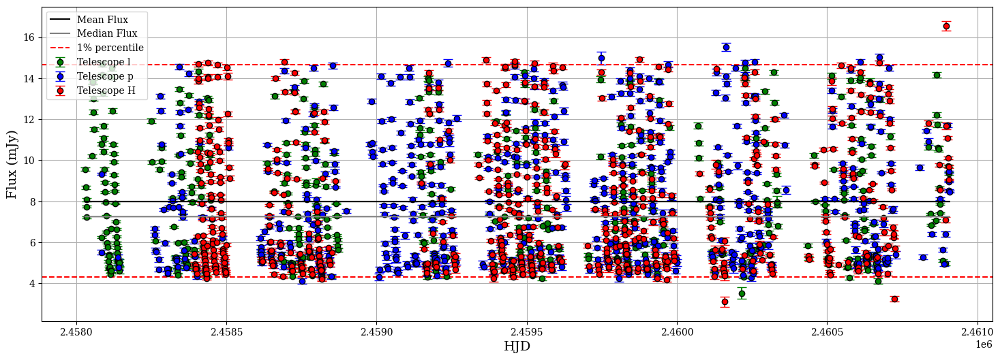

target 36
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.7100733237977295, 4.681232072396659
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
RA: 11.721182, DEC: -72.714394


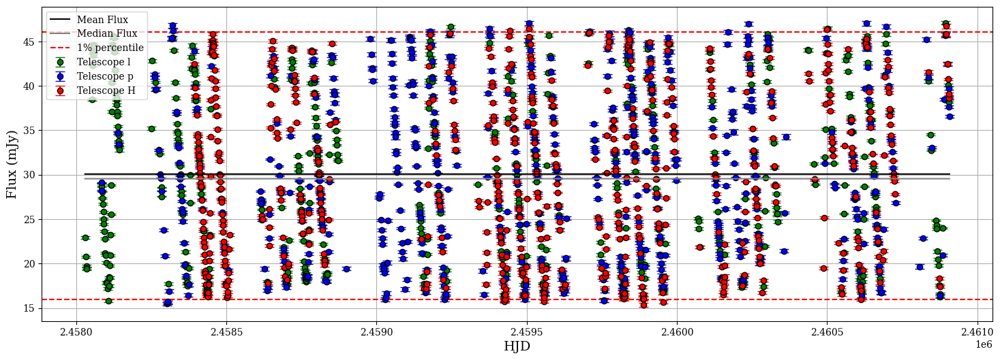

target 41
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.754078687099135, 4.0321377877386615
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
RA: 11.793363, DEC: -72.96051


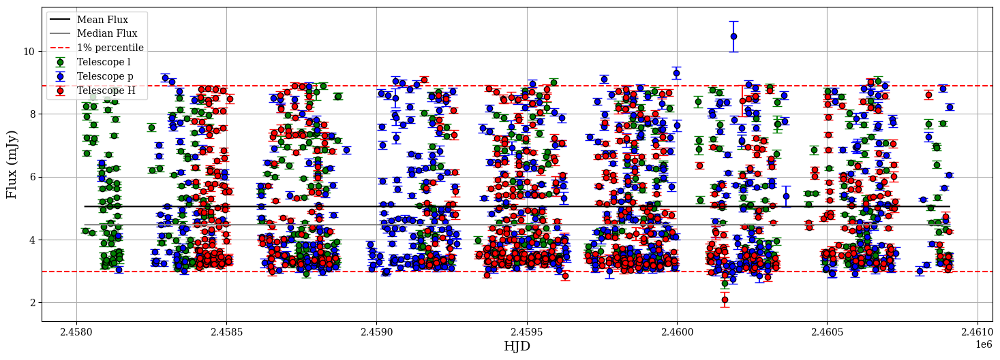

target 65
main type: Unknown
offset flag: 0
alarm level flag: 0
logT and logL: 3.67251224078398, 4.118477904012384
telescope k 56 0.12147505422993492
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22203947368421054
RA: 12.419711, DEC: -73.236916


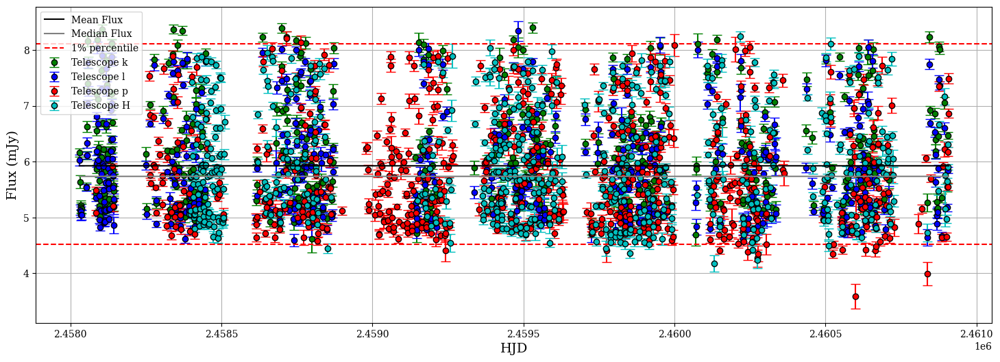

target 78
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.735289885799096, 4.891712817796657
telescope k 56 0.12121212121212122
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
RA: 12.619976, DEC: -72.752563


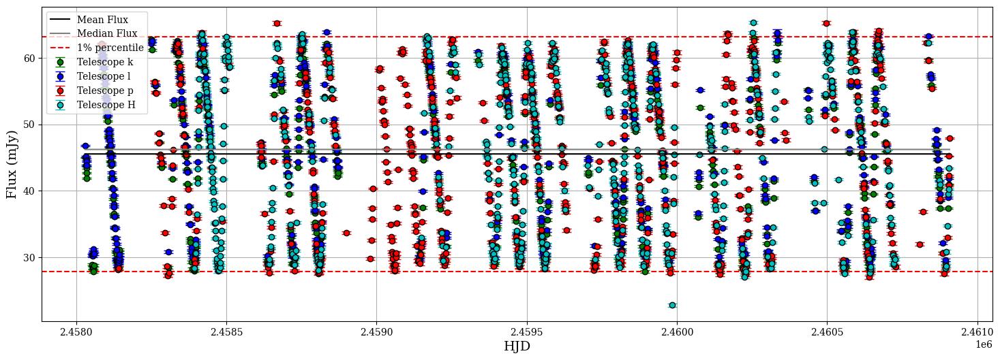

target 94
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.719463397674171, 4.226138459655386
telescope k 56 0.12121212121212122
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
RA: 12.858666, DEC: -72.888458


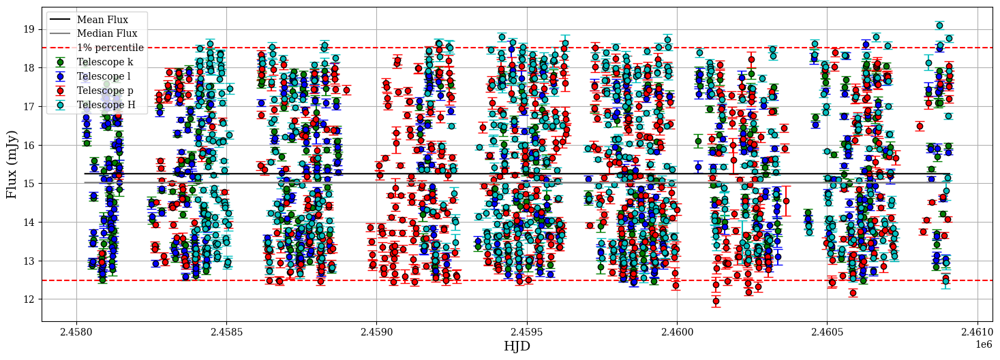

target 102
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.7229706554091737, 4.21991160973549
telescope k 56 0.12121212121212122
telescope l 56 0.11740041928721175
telescope p 103 0.1606864274570983
telescope H 135 0.22203947368421054
RA: 13.001509, DEC: -73.0895


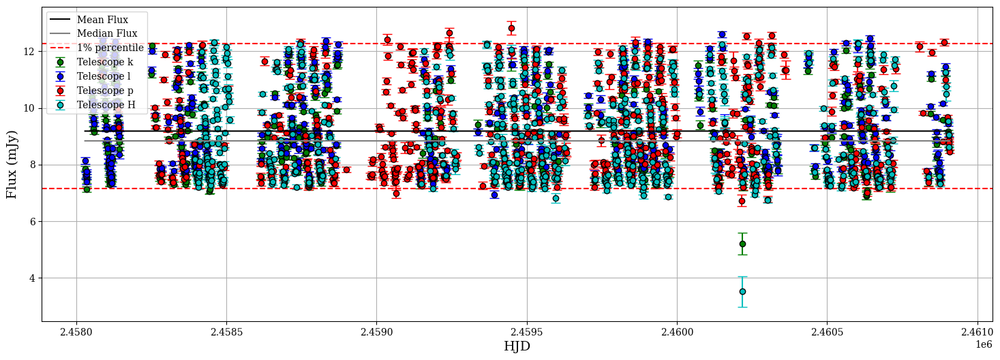

target 154
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.753050528014179, 4.785595691695746
telescope k 56 0.12121212121212122
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
RA: 13.427622, DEC: -72.287094


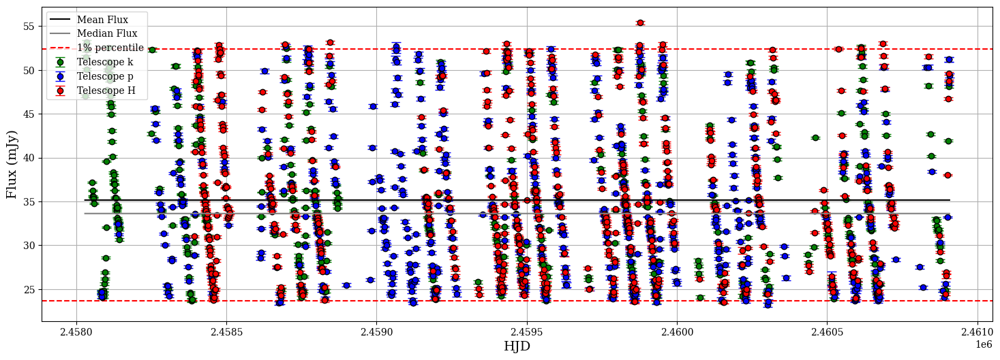

target 189
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.756468455364246, 4.180379801624612
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 103 0.1606864274570983
telescope H 135 0.22167487684729065
telescope G 69 0.15333333333333332
RA: 13.761648, DEC: -72.768044


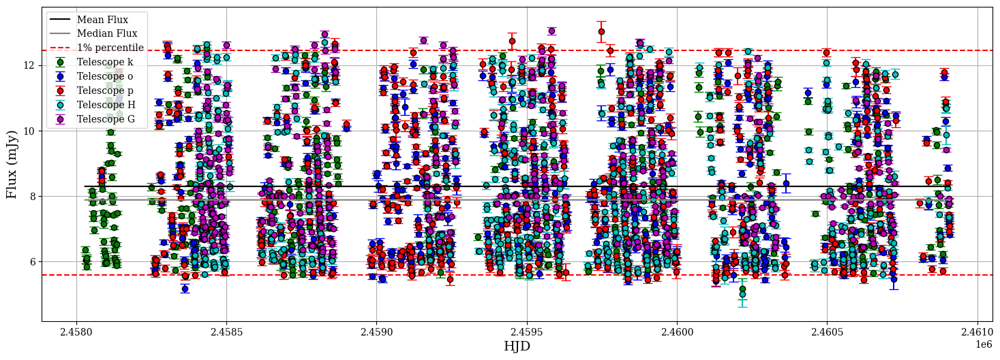

target 244
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.7159697800108624, 4.175404433816001
telescope j 75 0.16741071428571427
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 103 0.1606864274570983
telescope m 14 0.050724637681159424
telescope E 82 0.1938534278959811
telescope H 135 0.22203947368421054
telescope G 127 0.20751633986928106
RA: 14.391292, DEC: -72.070297


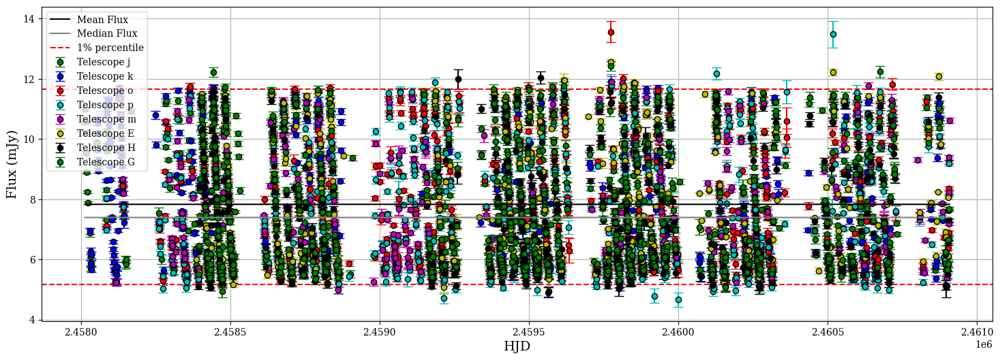

target 247
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.697498166248082, 4.008224192431611
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 103 0.1606864274570983
telescope H 135 0.22203947368421054
telescope G 127 0.20751633986928106
RA: 14.472133, DEC: -72.412888


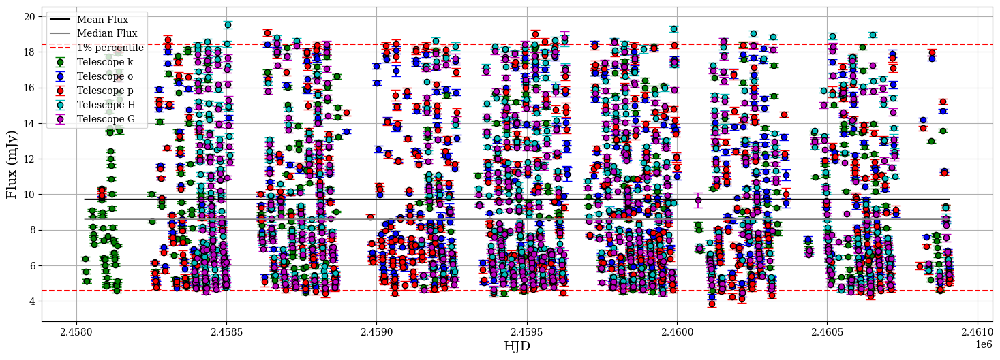

target 267
main type: RedSG_Candidate
offset flag: 0
alarm level flag: 0
logT and logL: 3.6030757205981834, 4.214378558457524
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope p 102 0.15987460815047022
telescope H 135 0.22240527182866557
telescope G 127 0.2078559738134206
RA: 14.925954, DEC: -72.163506


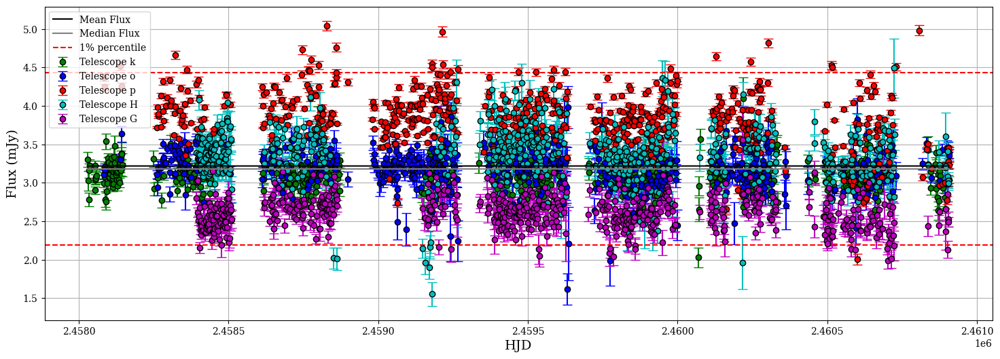

target 284
main type: ClassicalCep
offset flag: 0
alarm level flag: 1
logT and logL: 3.6752855369147417, 4.381591181532421
telescope j 75 0.16741071428571427
telescope k 56 0.12121212121212122
telescope o 108 0.16314199395770393
telescope E 42 0.20388349514563106
telescope G 127 0.20751633986928106
RA: 15.456195, DEC: -72.095955


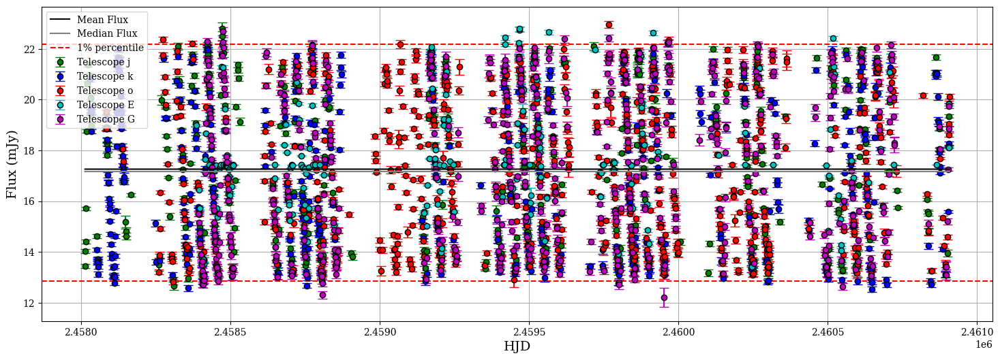

target 331
main type: ClassicalCep
offset flag: 0
alarm level flag: 0
logT and logL: 3.69950913247256, 4.056509022968133
telescope k 56 0.12121212121212122
telescope o 108 0.16338880484114976
telescope G 127 0.20751633986928106
RA: 16.823183, DEC: -73.22393


KeyboardInterrupt: 

In [ ]:
main_types = simbad_df['main_type'].replace('', np.nan).fillna('Unknown').astype(str)
for i in high_amp_targets:
    print(f'target {i}')
    print(f"main type: {main_types.iloc[i]}")
    print(f'offset flag: {simbad_df["offset_flag"].iloc[i]}')
    print(f'alarm level flag: {simbad_df["alarm_level_flag"].iloc[i]}')
    print(f"logT and logL: {df_smc['logT'].iloc[i]}, {df_smc['logL'].iloc[i]}" if i < 377 else f"{df_lmc['logT'].iloc[i-377]}, {df_lmc['logL'].iloc[i-377]}")
    fit_plotter_flux(i, g=True)

RA: 12.42137, DEC: -72.301399


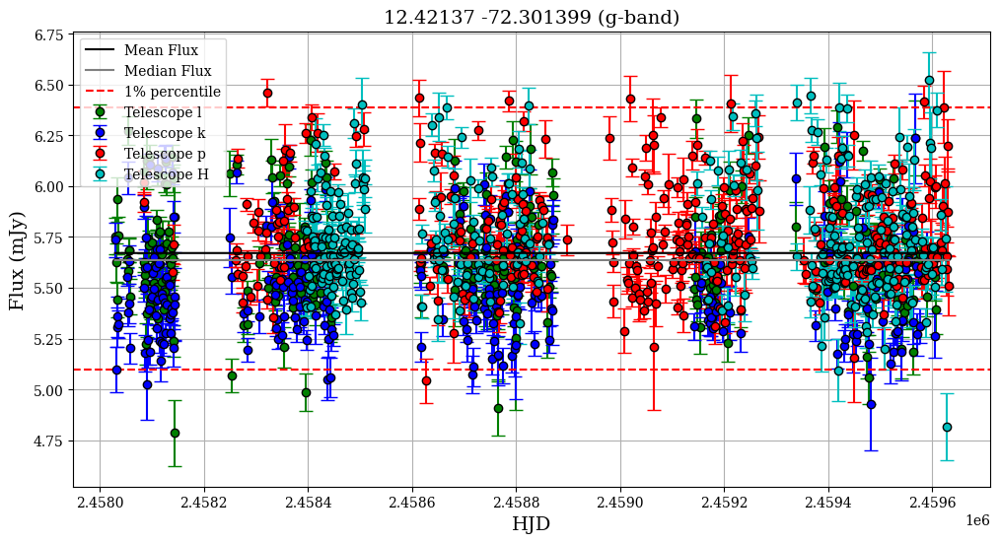

In [ ]:
fit_plotter_flux(66)

# further subset cuts to explore overlaps between variability types

### brighter than 14 mag cut:

In [ ]:
# Filter dense_strip_targets for overall_mean_mag > 14 and sort by mag_amplitude_1
# Create filtered list of targets with overall_mean_mag > 14
filtered_targets = []
for target in dense_strip_targets:
    overall_mean_mag = stats['overall_mean_mag'].iloc[target]
    if overall_mean_mag < 14:
        mag_amplitude = stats['mag_amplitude_1'].iloc[target]
        filtered_targets.append((target, mag_amplitude, overall_mean_mag))

# Sort by mag_amplitude_1 in descending order (highest to lowest)
filtered_sorted_targets = sorted(filtered_targets, key=lambda x: x[1], reverse=True)

print(f"Dense strip targets with overall_mean_mag > 14, sorted by mag_amplitude_1:")
print(f"Total filtered targets: {len(filtered_sorted_targets)} (out of {len(dense_strip_targets)} total)")

if len(filtered_sorted_targets) > 0:
    print(f"\nTop 10 filtered targets:")
    for i, (target_idx, amplitude, mean_mag) in enumerate(filtered_sorted_targets[:10]):
        print(f"{i+1:2d}. Target {target_idx:3d}: mag_amplitude_1 = {amplitude:.4f}, overall_mean_mag = {mean_mag:.3f}")
    
    if len(filtered_sorted_targets) > 5:
        print(f"\nBottom 5 filtered targets:")
        for i, (target_idx, amplitude, mean_mag) in enumerate(filtered_sorted_targets[-5:]):
            print(f"{len(filtered_sorted_targets)-4+i:2d}. Target {target_idx:3d}: mag_amplitude_1 = {amplitude:.4f}, overall_mean_mag = {mean_mag:.3f}")
    
    # Extract just the sorted target indices for processing
    filtered_sorted_indices = [target for target, _, _ in filtered_sorted_targets]
    
    print(f"\nReady to process filtered targets with fit_plotter_flux()")
else:
    print("No targets found with overall_mean_mag > 14")

Dense strip targets with overall_mean_mag > 14, sorted by mag_amplitude_1:
Total filtered targets: 444 (out of 665 total)

Top 10 filtered targets:
 1. Target  72: mag_amplitude_1 = 0.1760, overall_mean_mag = 13.600
 2. Target 198: mag_amplitude_1 = 0.1701, overall_mean_mag = 13.937
 3. Target 826: mag_amplitude_1 = 0.1674, overall_mean_mag = 13.720
 4. Target 144: mag_amplitude_1 = 0.1672, overall_mean_mag = 13.859
 5. Target 553: mag_amplitude_1 = 0.1624, overall_mean_mag = 13.928
 6. Target 665: mag_amplitude_1 = 0.1600, overall_mean_mag = 13.757
 7. Target  74: mag_amplitude_1 = 0.1511, overall_mean_mag = 13.385
 8. Target  68: mag_amplitude_1 = 0.1506, overall_mean_mag = 13.982
 9. Target 842: mag_amplitude_1 = 0.1497, overall_mean_mag = 13.339
10. Target 641: mag_amplitude_1 = 0.1491, overall_mean_mag = 13.751

Bottom 5 filtered targets:
440. Target 843: mag_amplitude_1 = 0.0573, overall_mean_mag = 11.850
441. Target 679: mag_amplitude_1 = 0.0556, overall_mean_mag = 12.880
442. T

In [ ]:
# Run fit_plotter_flux on the first n targets (filtered by overall_mean_mag > 14)
n_targets_to_process = 100  # Change this number as needed

if len(filtered_sorted_indices) > 0:
    # Determine how many targets to actually process
    actual_n = min(n_targets_to_process, len(filtered_sorted_indices))
    
    print(f"Running fit_plotter_flux() on first {actual_n} filtered targets")
    print(f"(Targets with overall_mean_mag > 14, sorted by highest mag_amplitude_1)")
    print("=" * 70)
    
    successful_count = 0
    error_count = 0
    
    for i in range(actual_n):
        target_idx = filtered_sorted_indices[i]
        amplitude = stats['mag_amplitude_1'].iloc[target_idx]
        mean_mag = stats['overall_mean_mag'].iloc[target_idx]
        
        print(f"\nProcessing {i+1}/{actual_n}: Target {target_idx}")
        print(f"  mag_amplitude_1: {amplitude:.4f}, overall_mean_mag: {mean_mag:.3f}")
        
        try:
            # Run fit_plotter_flux on this target
            fit_plotter_flux(target_idx)
            successful_count += 1
            print(f"  ✓ Successfully processed target {target_idx}")
        except Exception as e:
            error_count += 1
            print(f"  ✗ Error processing target {target_idx}: {str(e)}")
            continue
    
    print(f"\n" + "=" * 70)
    print(f"Processing complete!")
    print(f"Successfully processed: {successful_count}/{actual_n} targets")
    print(f"Errors encountered: {error_count}/{actual_n} targets")
    
else:
    print("No filtered targets available to process!")

# Summary of what was filtered
print(f"\nFiltering summary:")
print(f"- Original dense_strip_targets: {len(dense_strip_targets)}")
print(f"- Targets with overall_mean_mag > 14: {len(filtered_sorted_indices) if 'filtered_sorted_indices' in locals() else 0}")
print(f"- Targets processed: {actual_n if 'actual_n' in locals() else 0}")

# Working zone / extras

In [ ]:
def hms_to_deg(h, m, s):
    """Convert RA from hours, minutes, seconds to decimal degrees."""
    return (h + m / 60 + s / 3600) * 15

def dms_to_deg(d, m, s):
    """Convert Dec from degrees, arcminutes, arcseconds to decimal degrees."""
    sign = -1 if d < 0 else 1
    return sign * (abs(d) + m / 60 + s / 3600)

def deg_to_hms(ra_deg):
    """Convert RA from decimal degrees to hours, minutes, seconds."""
    total_seconds = ra_deg / 15 * 3600
    h = int(total_seconds // 3600)
    m = int((total_seconds % 3600) // 60)
    s = total_seconds % 60
    return h, m, s

def deg_to_dms(dec_deg):
    """Convert Dec from decimal degrees to degrees, minutes, seconds."""
    sign = -1 if dec_deg < 0 else 1
    dec_deg = abs(dec_deg)
    d = int(dec_deg)
    m = int((dec_deg - d) * 60)
    s = (dec_deg - d - m / 60) * 3600
    return sign * d, m, s

def deg_to_hms_filenames(ra_deg):
    """Convert RA from decimal degrees to hours, minutes, seconds."""
    total_seconds = ra_deg / 15 * 3600
    h = int(total_seconds // 3600)
    m = int((total_seconds % 3600) // 60)
    s = total_seconds % 60
    # print(h, m, s)
    s = int(s*100)
    if s < 1000:
    # s = int(s*10)
    # if s < 100:
        if s < 100:
            s1 = f"00{s}"
            s2 = f"00{s+1}"
        else:
            s1 = f"0{s}"
            s2 = f"0{s+1}"
    else:
        s1 = f"{s}"
        s2 = f"{s+1}"
    if m < 10:
        m = f"0{m}"
    if h < 10:
        h = f"0{h}"
    return f"{h}{m}{s1}", f"{h}{m}{s2}"

def deg_to_dms_filenames(dec_deg):
    """Convert Dec from decimal degrees to degrees, minutes, seconds."""
    sign = -1 if dec_deg < 0 else 1
    dec_deg = abs(dec_deg)
    d = int(dec_deg)
    m = int((dec_deg - d) * 60)
    s = (dec_deg - d - m / 60) * 3600
    # print(d, m, s)
    s = int(s*10)
    if s < 100:
        if s < 10:
            s1 = f"00{s}"
            s2 = f"00{s+1}"
        else:
            s1 = f"0{s}"
            s2 = f"0{s+1}"
    else:
        s1 = f"{s}"
        s2 = f"{s+1}"
    if m < 10:
        m = f"0{m}"
    if d < 10:
        if sign < 0:
            d = f"-0{d}"
        else:
            d = f"0{d}"
    if sign < 0:
        d = f"-{d}"
    return f"{d}{m}{s1}", f"{d}{m}{s2}"


In [ ]:
# print(hms_to_deg(0, 49, 41.3741223720))  
# print(dms_to_deg(-73, 14, 14.772717888))

# print(deg_to_hms_filenames(7.521702))
# print(deg_to_dms_filenames(-73.913918))

# print(deg_to_hms_filenames(8.560188))
# print(deg_to_dms_filenames(-73.619049))
print("looks like everything needs to be rounded down")

print(deg_to_hms_filenames(11.753848))
print(deg_to_dms_filenames(-73.370476))


looks like everything needs to be rounded down
('00470092', '00470093')
('-7322137', '-7322138')


In [ ]:
coords = pd.read_csv('merged_smc_lmc_coords.csv', comment='#', sep="\\s+", names=['RA', 'DEC'])
counter = 0
for i in range(0,848):
    RA = coords['RA'].iloc[i]
    dec = coords['DEC'].iloc[i]
    RA_hms = deg_to_hms_filenames(RA)
    dec_dms = deg_to_dms_filenames(dec)
    RA_hms1 = RA_hms[0]
    dec_dms1 = dec_dms[0]
    file_path1 = os.path.join('sub2025', f'{RA_hms1}{dec_dms1}_g.dat')
    if not os.path.isfile(file_path1):
        RA_hms2 = RA_hms[1]
        file_path2 = os.path.join('sub2025', f'{RA_hms2}{dec_dms1}_g.dat')
        if not os.path.isfile(file_path2):
            dec_dms2 = dec_dms[1]
            file_path3 = os.path.join('sub2025', f'{RA_hms1}{dec_dms2}_g.dat')
            if not os.path.isfile(file_path3):
                file_path4 = os.path.join('sub2025', f'{RA_hms2}{dec_dms2}_g.dat')
                if not os.path.isfile(file_path4):
                    print(f"File not found for target {i}: {file_path1} or {file_path2}")
                    counter += 1
                    print(RA, dec)
print(counter)


0


In [ ]:
from astropy.io import fits

fits_file = 'eRASS1_HMXB_LMC_v1.0.fits'
with fits.open(fits_file) as hdul:
    hdul.info()
    print(hdul[0].header)
    table_data = hdul[1].data
    if table_data is not None:
        print(f"\nTable columns: {table_data.names}")
        print(f"Number rows: {len(table_data)}")

RA = table_data['RA_eRASS1']
DEC = table_data['DEC_eRASS1']
print(f"RA: {RA}")
print(f"DEC: {DEC}")

Filename: eRASS1_HMXB_LMC_v1.0.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      16   (285523,)   uint8   
  1  Joined        1 BinTableHDU    124   53R x 36C   [23A, 23A, K, 36A, D, D, E, E, 28A, D, D, D, 3A, 3A, 2A, 3A, 3A, 8A, 3A, 3A, 2A, 3A, 2A, 2A, 2A, 2A, 2A, A, D, D, E, E, D, 29A, D, D]   
SIMPLE  =                    T / Standard FITS format                           BITPIX  =                    8 / Character data                                 NAXIS   =                    1 / Text string                                    NAXIS1  =               285523 / Number of characters                           VOTMETA =                    T / Table metadata in VOTable format               EXTEND  =                    T / There are standard extensions                  COMMENT                                                                         COMMENT The data in this primary HDU consists of bytes which                    COMMENT 

In [ ]:
# # Stars in stats (summary_results07.csv) that are not in above_density_high_amp.csv
# # Ensure stats is loaded as summary_results07.csv earlier
# stats_src = 'summary_results07.csv'
# if 'stats' not in globals() or not isinstance(stats, pd.DataFrame):
#     stats = pd.read_csv(stats_src)

# adh_path = 'above_density_high_amp.csv'
# adh = pd.read_csv(adh_path)

# # Use RA/DEC as keys for membership; round to 1e-8 deg to be robust to float noise
# stats_keys = set(zip(stats['RA'].round(8), stats['DEC'].round(8)))
# adh_keys = set(zip(adh['RA'].round(8), adh['DEC'].round(8)))

# not_in_adh_keys = stats_keys - adh_keys
# mask = stats.apply(lambda r: (round(r.RA,8), round(r.DEC,8)) in not_in_adh_keys, axis=1)
# not_above_density_high_amp = stats.loc[mask].reset_index(drop=True)

# # Keep only stars with offset_flag == 0
# if 'offset_flag' not in not_above_density_high_amp.columns:
#     raise ValueError('offset_flag column not found in stats')
# filtered = not_above_density_high_amp[not_above_density_high_amp['offset_flag'] == 0].reset_index(drop=True)

# filtered.to_csv('dense_strip.csv', index=False)


### top 100 of dense strip (ends up being all dimmer than 14 mag)

In [ ]:
# Sort dense_strip_targets by mag_amplitude_1 (highest to lowest)
# Create list of tuples (target_index, mag_amplitude_1_value)
target_amplitude_pairs = [(target, stats['mag_amplitude_1'].iloc[target]) for target in dense_strip_targets]

# Sort by mag_amplitude_1 in descending order (highest to lowest)
sorted_targets = sorted(target_amplitude_pairs, key=lambda x: x[1], reverse=True)

print(f"Dense strip targets sorted by mag_amplitude_1 (highest to lowest):")
print(f"Total targets: {len(sorted_targets)}")
print("\nTop 10 targets:")
for i, (target_idx, amplitude) in enumerate(sorted_targets[:10]):
    print(f"{i+1:2d}. Target {target_idx:3d}: mag_amplitude_1 = {amplitude:.4f}")

print(f"\nBottom 5 targets:")
for i, (target_idx, amplitude) in enumerate(sorted_targets[-5:]):
    print(f"{len(sorted_targets)-4+i:2d}. Target {target_idx:3d}: mag_amplitude_1 = {amplitude:.4f}")

# Extract just the sorted target indices
sorted_target_indices = [target for target, _ in sorted_targets]

Dense strip targets sorted by mag_amplitude_1 (highest to lowest):
Total targets: 665

Top 10 targets:
 1. Target  42: mag_amplitude_1 = 0.3803
 2. Target 134: mag_amplitude_1 = 0.3363
 3. Target 256: mag_amplitude_1 = 0.3307
 4. Target 255: mag_amplitude_1 = 0.3304
 5. Target 124: mag_amplitude_1 = 0.3271
 6. Target 295: mag_amplitude_1 = 0.3167
 7. Target 260: mag_amplitude_1 = 0.3111
 8. Target 249: mag_amplitude_1 = 0.3055
 9. Target 291: mag_amplitude_1 = 0.3044
10. Target 253: mag_amplitude_1 = 0.3037

Bottom 5 targets:
661. Target 843: mag_amplitude_1 = 0.0573
662. Target 679: mag_amplitude_1 = 0.0556
663. Target 643: mag_amplitude_1 = 0.0556
664. Target 674: mag_amplitude_1 = 0.0546
665. Target 601: mag_amplitude_1 = 0.0446


In [ ]:
top_n = 100
for i, target_idx in enumerate(sorted_target_indices[:top_n]):
    amplitude = stats['mag_amplitude_1'].iloc[target_idx]
    print(f"\nProcessing {i+1}/{top_n}: Target {target_idx} (amplitude: {amplitude:.4f})")
    fit_plotter_flux(target_idx)